# **Unified classification and risk-stratification in Acute Myeloid Leukemia**


>>> # **Tutorial for all supplementary Figures** : 










In [1]:
R.version.string

[1] "R version 4.1.0 (2021-05-18)"

In [3]:
options(warn=-1)

# Step 1: Install and load missing libraries
# start_time <- Sys.time()
some_packages <- c("ggrepel","broom","gridExtra","ggplot2","scales","grid","colorspace","data.table",
                   "stringr","dplyr","survival","survminer","logistf","base","cmprsk","prodlim",
                   "bshazard","mstate","doMC","glmnet","rbokeh","networkD3")
for (package in some_packages){
#   if(!require(package,character.only = TRUE)){
#     install.packages(package,character.only = TRUE)
#   }
  library(package,character.only=TRUE)
}
# end_time <- Sys.time()
# paste0("It takes :", round(end_time-start_time,2), " minutes to install all the libraries (survminer takes a LOT of time!)")

In [7]:
source('src/tools_analysis_bis.R')

# **S.Figure 1: Study Cohort.**



<img src='data/study_cohort.png'>

# **S. Figure 2: Molecular characteristics. Distribution of gene mutations and cytogenetic abnormalities in A. AML NCRI trial study set (2,113 patients and 8,460 driver events) and B. AML SG study set (1,540 patients and 5,043 driver events).**

## ***A. UK AML NCRI.***

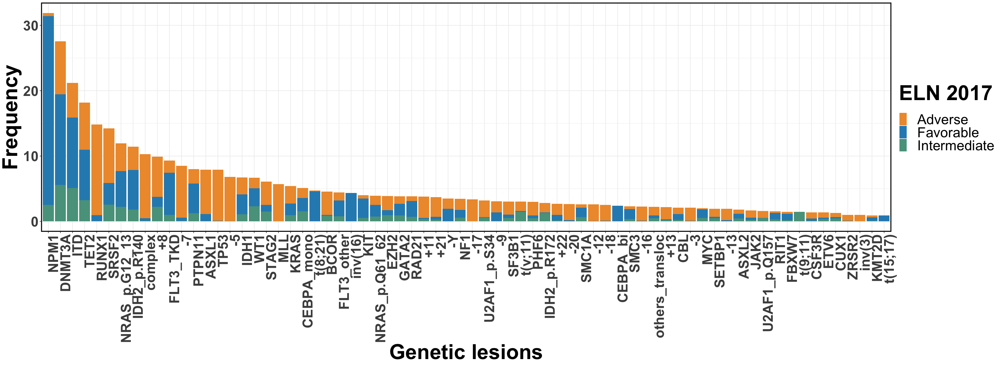

In [4]:
set_notebook_plot_size(30,11)
overall_strat_frequency(df_final,top=70)+theme(panel.border = element_rect(colour = "black", fill=NA, size=2))

## ***B. UK AML SG.***

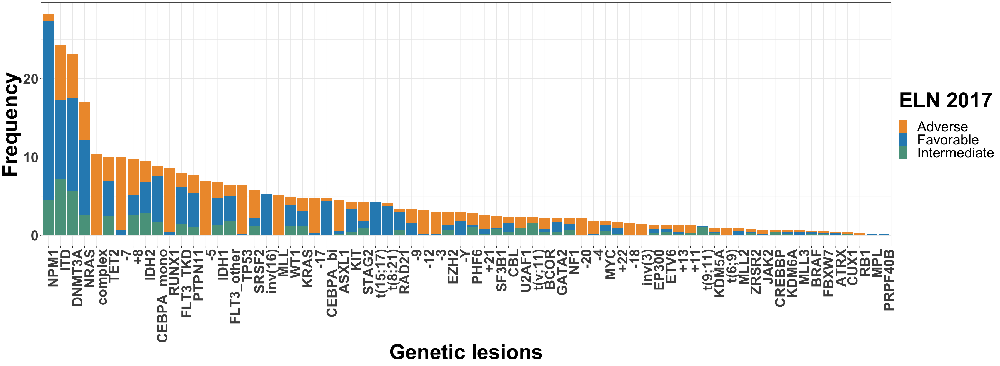

In [5]:

set_notebook_plot_size(30,11)
tmp <- df_validation
tmp$eln_2017 <- ifelse(tmp$eln_2017=="favorable",3,ifelse(tmp$eln_2017=="intermediate",2,1))
overall_strat_frequency(tmp,top=70,features=c(genes_val,cytos_val))

# **S.Figure 3: Age and ELN2017 relationships to survival. Kaplan-Meier curves for overall survival by age and ELN2017 stratification in A. NCRI trial study set (n=2,113) and B. AMLSG study set (n=1,540).** 

## ***a) Patients classification according to ELN 2017*** 

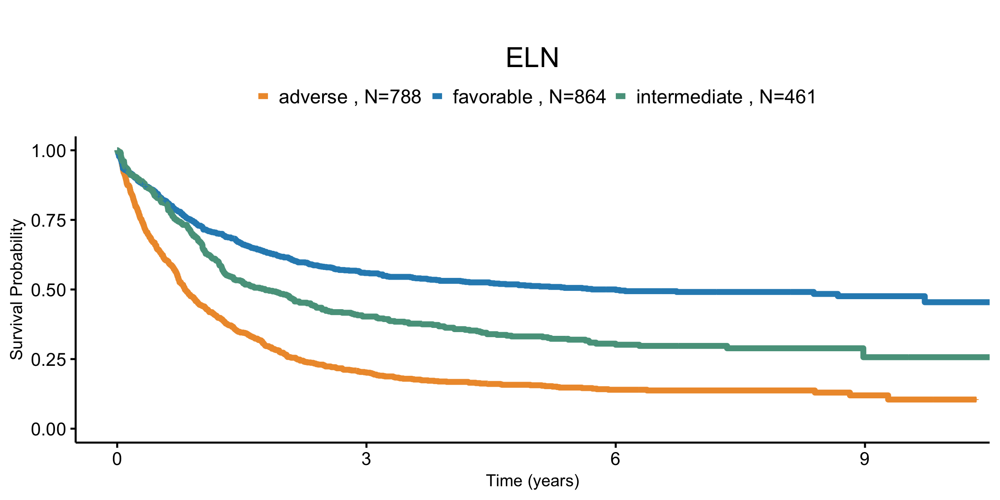

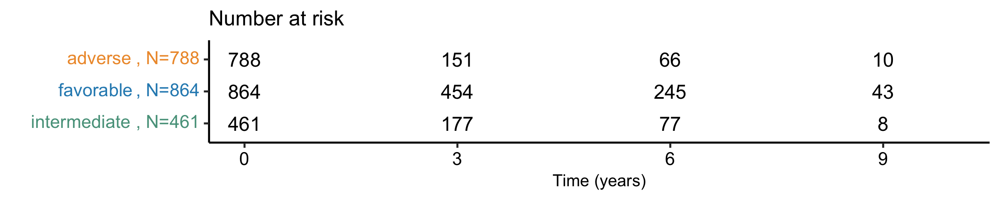

In [6]:

tmp <- df_final
tmp$comparison <- ifelse(tmp$eln_2017_favorable==1,"favorable",
                        ifelse(tmp$eln_2017_intermediate==1,"intermediate","adverse"))
surv_object <- Surv(time = tmp$os, event = tmp$os_status)
fit <- survfit(surv_object ~ comparison, data = tmp)

set_notebook_plot_size(20,10)
# Surv Plot
plot_surv_curves(fit,legend="top",submain="",vals=c("#EE9937","#2b8cbe","#59A08B"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,
                font.legend=28)$plot+
                theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5)) + 
                ggtitle("ELN")

set_notebook_plot_size(20,4)
# Risk Table
plot_surv_curves(fit,legend="top",submain="",vals=c("#EE9937","#2b8cbe","#59A08B"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,risk.tab=T,
                font.legend=28)$table

## ***b) Patients stratification by Age.***

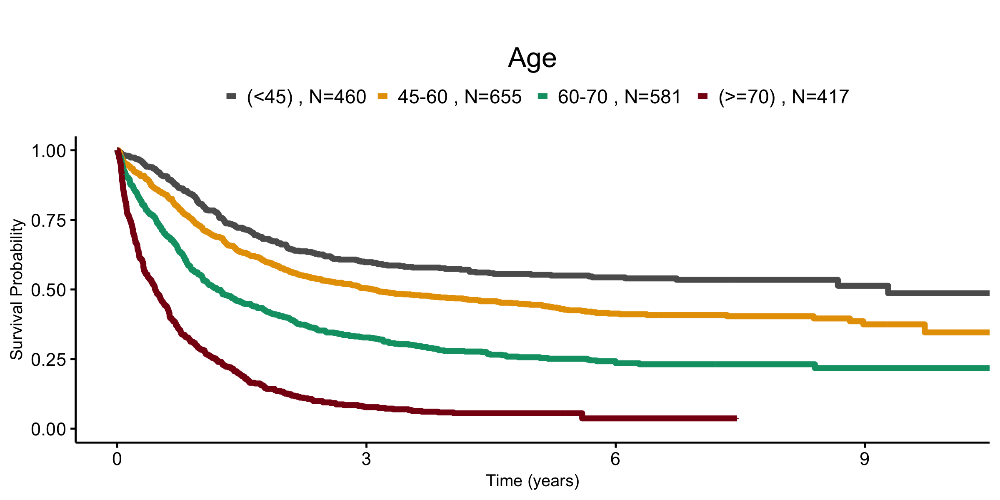

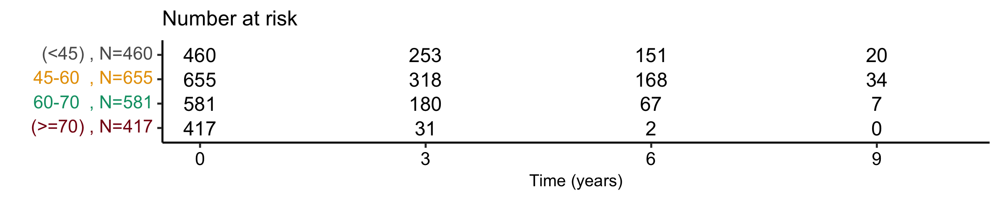

In [7]:
tmp <- df_final
tmp$comparison <- ifelse(tmp$age<45,"(<45)",
                        ifelse(tmp$age>=45 & tmp$age<60,"45-60",
                        ifelse(tmp$age>=60 & tmp$age<70,"60-70","(>=70)")))
tmp$comparison <- factor(tmp$comparison,levels=c("(<45)","45-60","60-70","(>=70)"))
surv_object <- Surv(time = tmp$os, event = tmp$os_status)
fit <- survfit(surv_object ~ comparison, data = tmp)

set_notebook_plot_size(20,10)
# Surv Plot
plot_surv_curves(fit,legend="top",submain="",vals=c("#5C5C5C","#e79f00","#009E73","#870C14"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,
                font.legend=28)$plot+
                theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+
                ggtitle("Age")

set_notebook_plot_size(20,4)
# Risk table
plot_surv_curves(fit,legend="top",submain="",vals=c("#5C5C5C","#e79f00","#009E73","#870C14"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,risk.tab=T,
                font.legend=28)$table

## ***c) Patients classification according to ELN 2017 Validation cohort.***

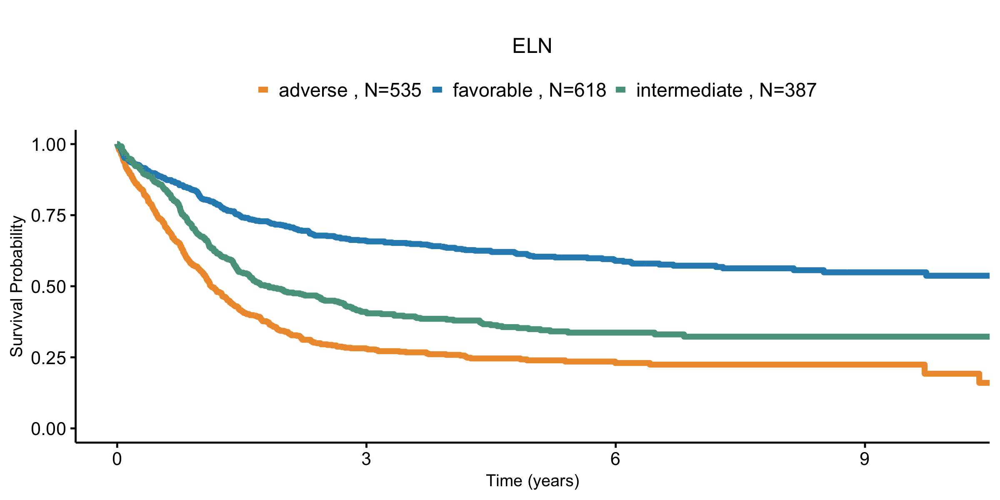

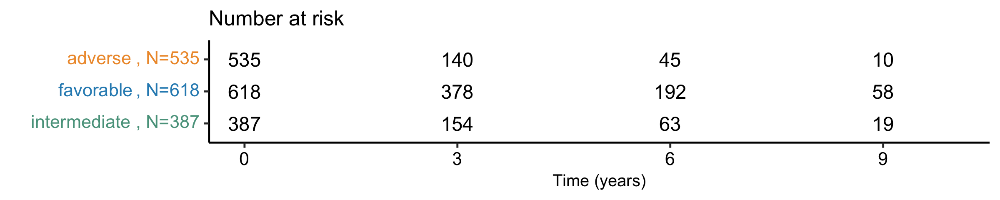

In [8]:

tmp <- df_validation
tmp$comparison <- ifelse(tmp$eln_2017_favorable==1,"favorable",
                        ifelse(tmp$eln_2017_intermediate==1,"intermediate","adverse"))
surv_object <- Surv(time = tmp$OS, event = tmp$OS_Status)
fit <- survfit(surv_object ~ comparison, data = tmp)

set_notebook_plot_size(20,10)
# Surv Plot
plot_surv_curves(fit,legend="top",submain="",vals=c("#EE9937","#2b8cbe","#59A08B"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,font.legend=28)$plot+
                theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
                ggtitle("ELN")

set_notebook_plot_size(20,4)
# Risk table
plot_surv_curves(fit,legend="top",submain="",vals=c("#EE9937","#2b8cbe","#59A08B"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,risk.tab=T,
                 font.legend=28)$table

## ***d) Patients stratification by Age.***

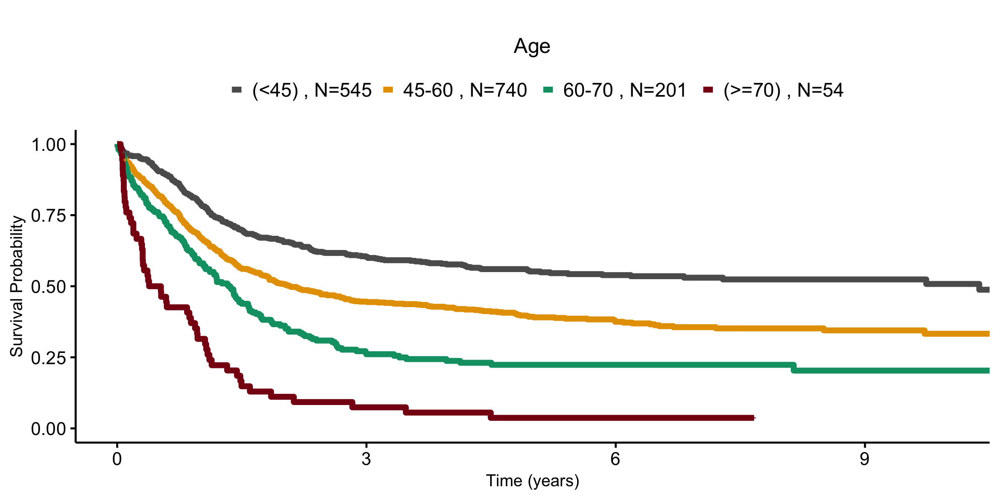

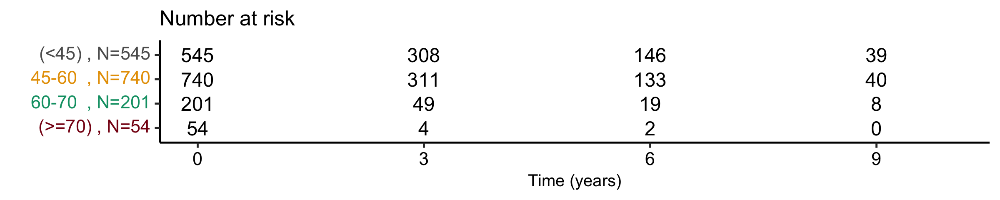

In [9]:

tmp <- df_validation
tmp$comparison <- ifelse(tmp$Age<45,"(<45)",
                        ifelse(tmp$Age>=45 & tmp$Age<60,"45-60",
                        ifelse(tmp$Age>=60 & tmp$Age<70,"60-70","(>=70)")))
tmp$comparison <- factor(tmp$comparison,levels=c("(<45)","45-60","60-70","(>=70)"))
surv_object <- Surv(time = tmp$OS, event = tmp$OS_Status)
fit <- survfit(surv_object ~ comparison, data = tmp)

set_notebook_plot_size(20,10)
# Surv Plot
plot_surv_curves(fit,legend="top",submain="",vals=c("#5C5C5C","#e79f00","#009E73","#870C14"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,font.legend=28)$plot+
theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+ggtitle("Age")

set_notebook_plot_size(20,4)
# Risk table
plot_surv_curves(fit,legend="top",submain="",vals=c("#5C5C5C","#e79f00","#009E73","#870C14"),y="Survival Probability",pval="",xlim=c(0,10),break.x.by=3,risk.tab=T,
                 font.legend=28)$table

# **S.Figure 4: Molecular Predictors of clinical correlates.**

## ***A. Volcano Plots.***

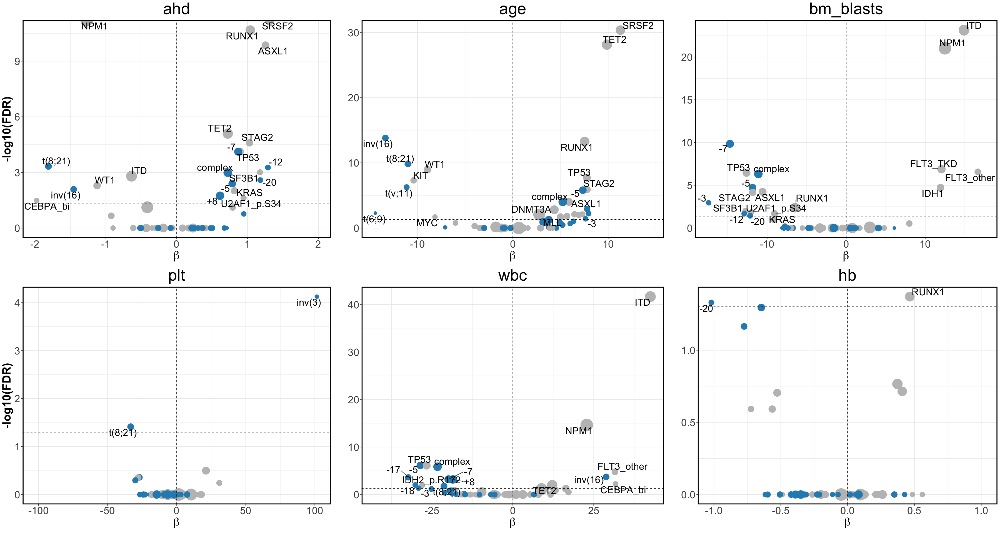

In [10]:
p <- list()
count <- 1
splicing <-  c("ZRSR2", "U2AF1_p.S34","U2AF1_p.Q157", "SRSF2", "SF3B1", "SF1", "NF1", "CUX1")
chromatin <- c("ASXL1", "STAG2", "BCOR", "MLL", "EZH2", "PHF6")
transcriptor <- c("RUNX1","SETBP1") 
factors <- c(splicing,chromatin,transcriptor)
col_order<-c("TP53","NPM1","CEBPA_bi","CEBPA_mono","DNMT3A","IDH1","IDH2_p.R140","IDH2_p.R172","WT1","ITD","TET2",factors,"FLT3_TKD","FLT3_other",
            "KRAS","NRAS_p.G12_13","NRAS_p.Q61_62","add_8","add_13","add_21","add_22","add_11","complex",
            "del_5","del_7","del_17","del_9","del_13","del_20","del_18","del_16","del_12","del_3","minusy",
            "t_15_17","inv_16","t_8_21","t_v_11","t_9_11","t_6_9","inv_3")
for (co in c("ahd","age","bm_blasts","plt","wbc","hb")){
    type <- ifelse(co %in% c("gender","ahd"),"binary","continuous")
    ylab <- ifelse(count %% 3==1,"-log10(FDR)","")
    if(co=="hb"){
        data <- df_final_bis[df_final_bis$hb<20,]
    } else {
        data <- df_final_bis
    }
    p[[co]] <- univariate_volcano(data,target=co,features=c(gen,cyto_bis,"inv_3","t_6_9"),
                        type=type,quantile=c(0,0.98),p_value_threshold = 0.05,
                        colors_analysis=colors_analysis[c("genes","cytos")],ylab=ylab)+theme(panel.border = element_rect(colour = "black", fill=NA, size=2))
    count <- count+1
}

set_notebook_plot_size(30,16)
do.call("grid.arrange",c(p,nrow=2))

## ***B. Multivariate regression ranking.***

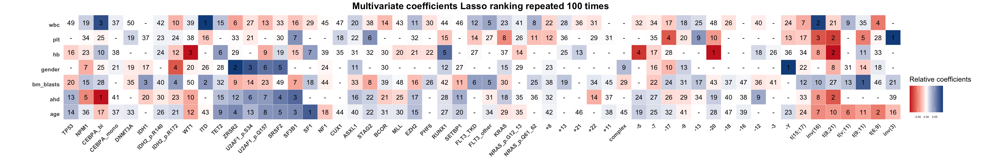

In [11]:
splicing <-  c("ZRSR2", "U2AF1_p.S34","U2AF1_p.Q157", "SRSF2", "SF3B1", "SF1", "NF1", "CUX1")
chromatin <- c("ASXL1", "STAG2", "BCOR", "MLL", "EZH2", "PHF6")
transcriptor <- c("RUNX1","SETBP1") 
factors <- c(splicing,chromatin,transcriptor)

col_order<-c("TP53","NPM1","CEBPA_bi","CEBPA_mono","DNMT3A","IDH1","IDH2_p.R140","IDH2_p.R172","WT1","ITD","TET2",factors,"FLT3_TKD","FLT3_other",
            "KRAS","NRAS_p.G12_13","NRAS_p.Q61_62","+8","+13","+21","+22","+11","complex",
            "-5","-7","-17","-9","-13","-20","-18","-16","-12","-3","-Y",
            "t(15;17)","inv(16)","t(8;21)","t(v;11)","t(9;11)","t(6;9)","inv(3)")

set_notebook_plot_size(30,5)
p <- multivariate_ranking(df_final = df_final, targets = c("hb","gender","ahd","age","bm_blasts","plt","wbc"),
                     covariates = col_order,num_iterations = 100)
p

# **S.Figure 5: Repartition of AML NCRI Cohort (n= 2,113) per WHO 2016 guidelines to include the provisional categories defined by RUNX1 and t(9;22).¶**

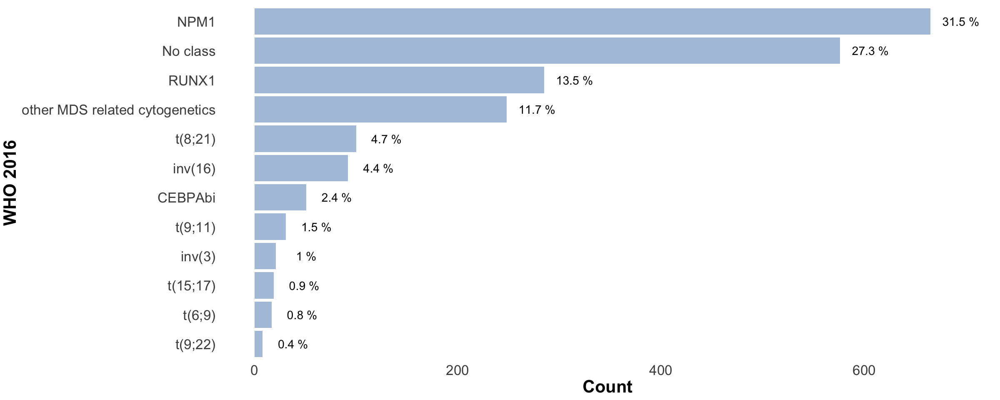

In [12]:
WHO_2016_defining_events <- c("t(8;21)","inv(16)","t(9;11)","t(6;9)","inv(3)","t(15;17)","CEBPA_bi","NPM1")
WHO_2016_provisional_events <- c("t(9;22)","RUNX1")
WHO_other_events <- c("-7","t(8;16)","-5","t(3;21)","t(1;3)","-13","t(2;11)","-11","t(5;12)","-12","t(5;7)","-9","t(5;17)","t(5;10)","t(3;5)")   # new to add to WHO
who_df <- df_final
who_df$Classes <- ifelse(who_df[,"t(8;21)"]==1,"t(8;21)",
                       ifelse(who_df[,"inv(16)"]==1,"inv(16)",
                              ifelse(who_df[,"t(9;11)"]==1,"t(9;11)",
                                     ifelse(who_df[,"t(6;9)"]==1,"t(6;9)",
                                            ifelse(who_df[,"inv(3)"]==1,"inv(3)",
                                                   ifelse(who_df[,"t(15;17)"]==1,"t(15;17)",
                                                          ifelse(who_df[,"CEBPA_bi"]==1,"CEBPAbi",
                                                               ifelse(who_df[,"NPM1"]==1,"NPM1",
                                                                      ifelse(who_df[,"t(9;22)"]==1,"t(9;22)",
                                                                             ifelse(who_df[,"RUNX1"]==1,"RUNX1",
                                                                                    ifelse(rowSums(who_df[,intersect(colnames(who_df),WHO_other_events)])>0,"other MDS related cytogenetics",
                                                                                    "No class")))))))))))
who_df<- data.frame(table(who_df$Classes))
colnames(who_df) <- c("Classes","Count")
who_df$Freq <- round(100*who_df$Count/sum(who_df$Count),1)
who_df$Freq <- paste(who_df$Freq,"%",sep=" ")
who_df <- who_df[order(who_df$Count,decreasing=T),]
# who_df

p <- ggplot(who_df,aes(x=reorder(Classes,Count),y=Count))+geom_bar(stat ="identity",fill="lightsteelblue")+
     scale_fill_manual(values=c("lightsteelblue"))+
     theme_bw()+
     theme(panel.border = element_rect(colour = "white", fill=NA, size=2),
           panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
           panel.background = element_blank(),
           legend.position= "none",
           plot.title = element_text(hjust = 0.5,size=25),
           axis.ticks=element_blank(),
           axis.text=element_text(size=20),axis.title=element_text(size=25,face="bold"))+
    ylab("Count")+
    xlab("WHO 2016")+
    coord_flip()+
    annotate(geom="text",x=rev(1:nrow(who_df)),y=who_df$Count+30, label=who_df$Freq,color="black",size=6)

set_notebook_plot_size(20,8)
p

# **S.Figure 6: Heatmap of classes.**


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16 
 19  92 100  75  16  17  44 208 674  38  19  40 501 100 124  46 

Order of Components : 
t_15_17  , inv_16  , t_8_21  , t_11  , t_6_9  , inv_3  , Trisomies  , TP53_complex  , NPM1  , CEBPA_bi  , DNMT3A_IDH1_2  , WT1  , sAML2  , sAML1  , mNOS  , no_events  ,

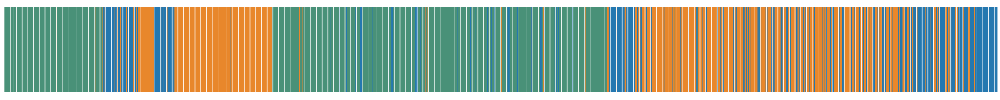

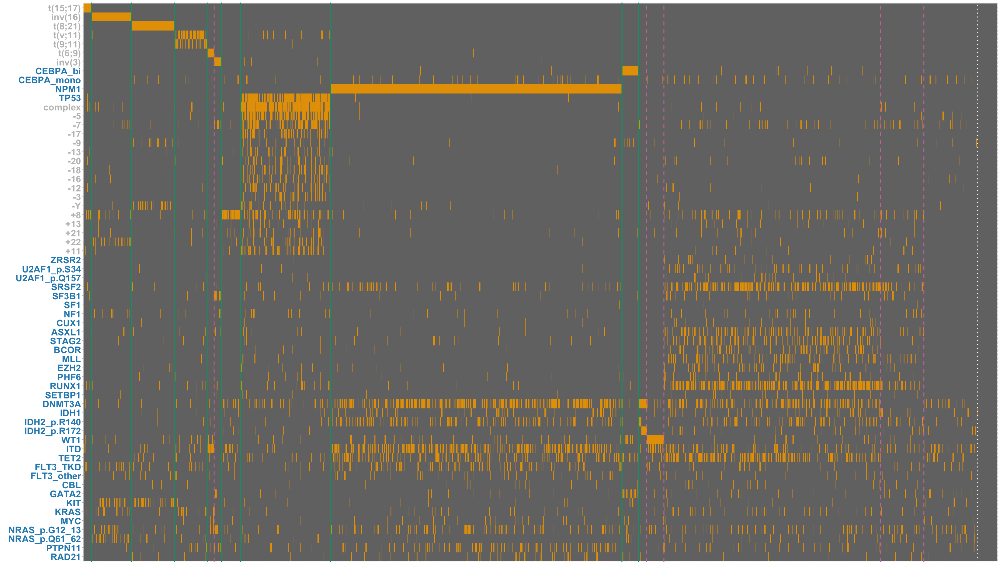

In [13]:
# Prepare data
df_bdp <- df_final
df_bdp$principal_component_numeric <- ifelse(df_bdp$princ_comp=="t_15_17",1,
                                              ifelse(df_bdp$princ_comp=="inv_16",2,
                                              ifelse(df_bdp$princ_comp=="t_8_21",3,
                                              ifelse(df_bdp$princ_comp=="t_11",4,
                                              ifelse(df_bdp$princ_comp=="t_6_9",5, 
                                              ifelse(df_bdp$princ_comp=="inv_3",6,
                                              ifelse(df_bdp$princ_comp=="Trisomies",7,
                                              ifelse(df_bdp$princ_comp=="TP53_complex",8,
                                              ifelse(df_bdp$princ_comp=="NPM1",9,
                                              ifelse(df_bdp$princ_comp=="CEBPA_bi",10,
                                              ifelse(df_bdp$princ_comp=="DNMT3A_IDH1_2",11,                                              
                                              ifelse(df_bdp$princ_comp=="WT1",12,                                                                                             
                                              ifelse(df_bdp$princ_comp=="sAML2",13,
                                              ifelse(df_bdp$princ_comp=="sAML1",14,                                               
                                              ifelse(df_bdp$princ_comp=="mNOS",15,
                                              16)))))))))))))))

df_bdp$principal_component <- df_bdp$princ_comp
table(df_bdp$principal_component_numeric)

# Order classes
df_bdp_ordered <- df_bdp[order(df_bdp$principal_component_numeric),][,c("eln_2017","principal_component"),drop=F]
df_bdp_ordered$names <- rownames(df_bdp_ordered)
df_bdp_ordered$value <- 1
df_bdp_ordered$names <- factor(df_bdp_ordered$names,levels=df_bdp_ordered$names)

# Plot ELN ordered classes :
set_notebook_plot_size(30,3)
ggplot(df_bdp_ordered,aes(x=names,y=value,fill=factor(eln_2017)))+geom_bar(stat="identity")+
scale_fill_manual(values=c("#EE9937","#2b8cbe","#59A08B"))+
theme(axis.line=element_blank(),axis.text.x=element_blank(),
      axis.text.y=element_blank(),axis.ticks=element_blank(),
      axis.title.x=element_blank(),
      axis.title.y=element_blank(),legend.position="none",
      panel.background=element_blank(),panel.border=element_blank(),panel.grid.major=element_blank(),
      panel.grid.minor=element_blank(),plot.background=element_blank())

# Order of the genes/cytos
col_order=c("t(15;17)","inv(16)","t(8;21)","t(v;11)","t(9;11)","t(6;9)","inv(3)","CEBPA_bi","CEBPA_mono","NPM1",
                                "TP53","complex","-5","-7","-17","-9","-13","-20","-18","-16","-12","-3","-Y","+8","+13","+21","+22",
                                "+11","ZRSR2", "U2AF1_p.S34","U2AF1_p.Q157", "SRSF2", "SF3B1", "SF1", "NF1", "CUX1","ASXL1", "STAG2",
                                "BCOR", "MLL", "EZH2","PHF6","RUNX1","SETBP1","DNMT3A","IDH1","IDH2_p.R140","IDH2_p.R172","WT1","ITD",
                                "TET2","FLT3_TKD","FLT3_other")
# Genes/cytos to plot
cols_to_plot <- c(gen,cyto,"inv(3)","t(6;9)","t(9;11)","t(15;17)","ZRSR2","U2AF1_p.Q157","SF1","CUX1","SETBP1","-13")
# remove few events :
cols_to_plot <- cols_to_plot[!cols_to_plot %in% c("others_transloc","SMC1A","SMC3")]

# Plot heatmap ordered classes
set_notebook_plot_size(30,17)
heatmaps(df_bdp, type=c("ordered"),col_order=col_order,cols_to_plot=cols_to_plot)


# **S.Figure 7: Genetic landscape of AML classes.**

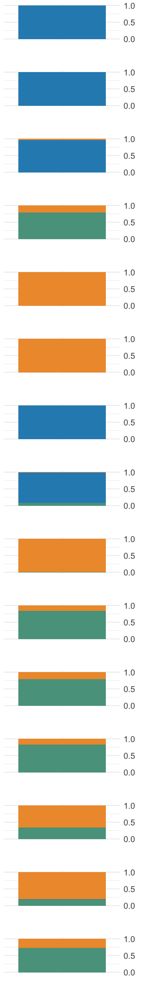

In [14]:
# Prepare features order
splicing <-  c("ZRSR2", "U2AF1_p.S34","U2AF1_p.Q157", "SRSF2", "SF3B1", "SF1", "NF1", "CUX1")
chromatin <- c("ASXL1", "STAG2", "BCOR", "MLL", "EZH2", "PHF6")
transcriptor <- c("RUNX1","SETBP1") 
factors <- c(splicing,chromatin,transcriptor)

col_order<-c("t(15;17)","inv(16)","t(8;21)","t(v;11)","t(9;11)","t(6;9)","inv(3)","+8","+13","+21","+22","+11",
             "TP53","complex","NPM1","CEBPA_bi","CEBPA_mono","DNMT3A","IDH1","IDH2_p.R140","IDH2_p.R172","WT1",
             "ITD","TET2",factors,"FLT3_TKD","FLT3_other","KRAS","NRAS_p.G12_13","NRAS_p.Q61_62","KIT","-5",
             "-7","-17","-9","-13","-20","-18","-16","-12","-3","-Y")

color_values[c("TP53-complex","DNMT3A_IDH")] <- color_values[c("TP53_complex","DNMT3A_IDH1_2")]
# Prepare stratas order
stratas_order <- c("principal_component_t(15;17)","principal_component_inv(16)","principal_component_t(8;21)","principal_component_t(11)",
                "principal_component_t(6;9)","principal_component_inv(3)","principal_component_CEBPA_bi",
                "principal_component_NPM1","principal_component_TP53_complex",
               "principal_component_Trisomies","principal_component_DNMT3A_IDH1_2","principal_component_WT1",
                "principal_component_sAML1","principal_component_sAML2","principal_component_mNOS")

plot(stratas_features_frequency(df_final,genes,cytos,stratas=stratas_order,cols_to_keep=col_order,facet_type=T,colors=color_values)+
     theme(panel.border = element_rect(colour = "black", fill=NA, size=2)))

# Prepare ELN frequency per strata
p <- eln_stratas_freq(df_final=df_final,cols=stratas_order,flip=F)
set_notebook_plot_size(3,20)
do.call("grid.arrange",c(p,nrow=length(stratas_order)))

# **S.Figure 8: Molecular classification in AML.**

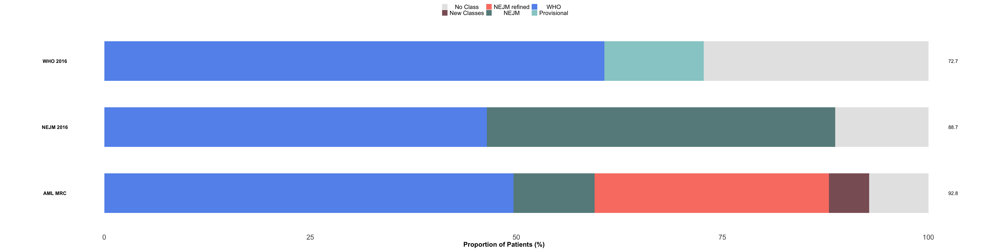

In [15]:


WHO_2016_defining_events <- c("t(8;21)","inv(16)","t(9;11)","t(6;9)","inv(3)","t(15;17)","CEBPA_bi","NPM1")
WHO_other_events <- c("-7","t(8;16)","-5","t(3;21)","t(1;3)","-13","t(2;11)","-11","t(5;12)","-12","t(5;7)","-9","t(5;17)","t(5;10)","t(3;5)")   # new to add to WHO
WHO_2016_defining_events <- c(WHO_2016_defining_events,WHO_other_events)
WHO_2016_defining_events <- intersect(colnames(df_final),WHO_2016_defining_events)
WHO_2016_provisional_events <- c("t(9;22)","RUNX1")


# 1. WHO 2016 Part:

df_WHO_def_events <- df_final[rowSums(df_final[,WHO_2016_defining_events])>0,]
df_WHO_def_events$classes <- "WHO"
df_WHO_NOT_def_events <- df_final[rowSums(df_final[,WHO_2016_defining_events])==0 ,]
df_WHO_NOT_def_events$classes <- ifelse((df_WHO_NOT_def_events$RUNX1==1 | df_WHO_NOT_def_events[,"t(9;22)"]==1) , "Provisional","No Class")
df_WHO <- rbind(df_WHO_def_events,df_WHO_NOT_def_events)
df_WHO$Classification <- "WHO 2016"

percentage_classified_WHO <- 100*round(nrow(df_WHO[df_WHO$classes!="No Class",])/nrow(df_WHO),3)


# 2. NEJM  2016 Part:
df_NEJM <- df_final
df_NEJM$classes <- ifelse(df_NEJM$NPM1==1,"WHO",
                    ifelse(rowSums(df_NEJM[,c("SRSF2","SF3B1","U2AF1_p.S34","U2AF1_p.Q157","ZRSR2","ASXL1","STAG2","BCOR",
                          "MLL","EZH2","PHF6","RUNX1")])>1,"NEJM",      
                    ifelse(df_NEJM$TP53==1 | df_NEJM$complex==1 | df_NEJM[,"+8"]==1,"NEJM",
                    ifelse(df_NEJM[,"inv(16)"]==1,"WHO",
                    ifelse(df_NEJM$CEBPA_bi==1,"WHO",
                    ifelse(df_NEJM[,"t(15;17)"]==1,"WHO",      
                    ifelse(df_NEJM[,"t(8;21)"]==1,"WHO",
                    ifelse(df_NEJM[,"t(9;11)"]==1,"WHO",
                    ifelse(df_NEJM[,"inv(3)"]==1,"WHO",
                    ifelse(df_NEJM$IDH2_p.R172==1,"NEJM",
                    ifelse(df_NEJM[,"t(6;9)"]==1,"WHO",
                    ifelse(rowSums(df_NEJM[,c("SRSF2","SF3B1","U2AF1_p.S34","U2AF1_p.Q157","ZRSR2","ASXL1","STAG2","BCOR",
                          "MLL","EZH2","PHF6","RUNX1")])==1,"NEJM", 
                    ifelse(rowSums(df_NEJM[,WHO_2016_defining_events])>0,"WHO",
                           "No Class")))))))))))))


df_NEJM$Classification <- "NEJM 2016"

percentage_classified_NEJM <- 100*round(nrow(df_NEJM[df_NEJM$classes!="No Class",])/nrow(df_NEJM),3)

# 3. MRC Part: 

df_MRC <- df_final

df_MRC$classes <- ifelse(df_MRC$princ_comp %in% c("t_15_17","t_8_21","inv_16","t_6_9","inv_3","t_11","CEBPA_bi","NPM1"),"WHO",
                      ifelse(df_MRC$princ_comp %in% c("TP53_complex"),"NEJM",
                          ifelse(df_MRC$princ_comp %in% c("sAML1","sAML2") ,"NEJM refined",
                              ifelse(df_MRC$princ_comp %in% c("DNMT3A_IDH1_2","WT1","Trisomies"),"New Classes" ,
                                  ifelse(rowSums(df_MRC[,WHO_2016_defining_events])>0,"WHO","No Class")))))


df_MRC$Classification <- "MRC"

percentage_classified_MRC <- 100*round(nrow(df_MRC[df_MRC$classes!="No Class",])/nrow(df_MRC),3)

# All together

df_all <- rbind(df_WHO,df_NEJM,df_MRC)
df_all$classes <- factor(df_all$classes, levels=c("No Class","New Classes","NEJM refined","NEJM","Provisional","WHO"))
df_all$Classification <- factor(df_all$Classification,levels=c("MRC","NEJM 2016","WHO 2016"))




color_plot <- list()
color_plot["No Class"] <- "#E5E5E5"
color_plot["New Classes"] <- "#8B5F65"
color_plot["NEJM refined"] <- "salmon"
color_plot["NEJM"] <- "paleturquoise4"
color_plot["WHO"] <- "#6495ED"
color_plot["Provisional"] <- "paleturquoise3"



set_notebook_plot_size(40,10)
p <- ggplot(df_all,aes(x=reorder(Classification,Classification),fill=classes))+geom_bar(aes(y = 300 *(..count..)/sum(..count..)),stat="count",width=0.6)+
     scale_fill_manual(values=unlist(color_plot),limits=names(color_plot))+
     ylab("Proportion of Patients (%)")+
     xlab("")+
     theme_bw()+
     theme(panel.border = element_rect(colour = "black", fill=NA, size=0),
           legend.text = element_text(hjust = 0.5,size=17),legend.title = element_blank(),legend.position="top",
           plot.title = element_text(hjust = 0.5,size=25),
           axis.text.y=element_blank(),axis.ticks=element_blank(),axis.text.x=element_text(size=20),
           axis.title=element_text(size=19,face="bold"),
           panel.grid.major = element_blank(), panel.grid.minor = element_blank(),panel.background = element_blank())+
     coord_flip()+
     annotate("text",label=c(percentage_classified_MRC,percentage_classified_NEJM,percentage_classified_WHO),x=c(1,2,3),y=103,size=5)+
     annotate("text",label=c("AML MRC","NEJM 2016","WHO 2016"),x=c(1,2,3),y=c(-6,-6,-6),size=5,fontface="bold")
p


# **S. Figure 9: TP53 single vs multi hit.**

## ***A. Kaplan-Meier Curves for OS and associated risk table comparing TP53 single and multi hit in the AML NCRI cohort (N=2,113).***

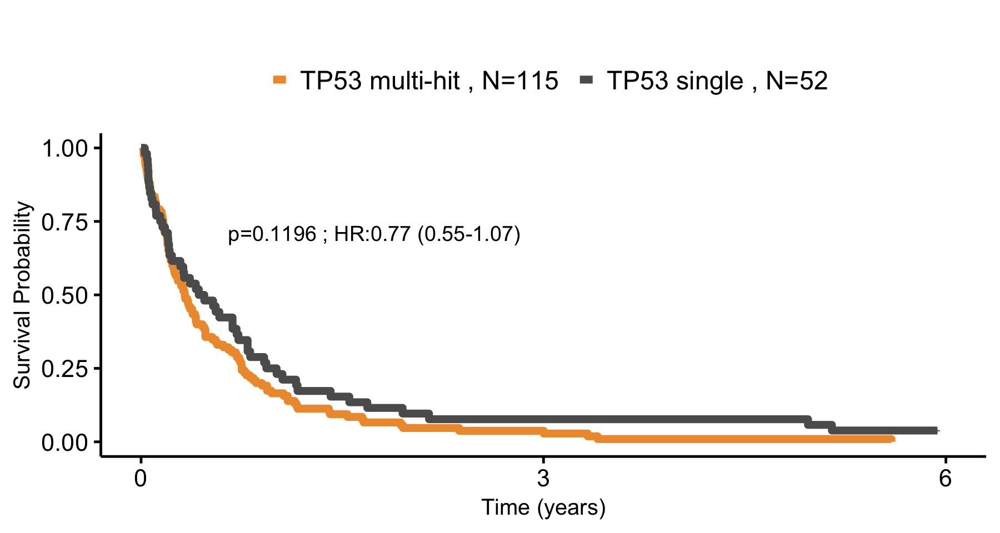

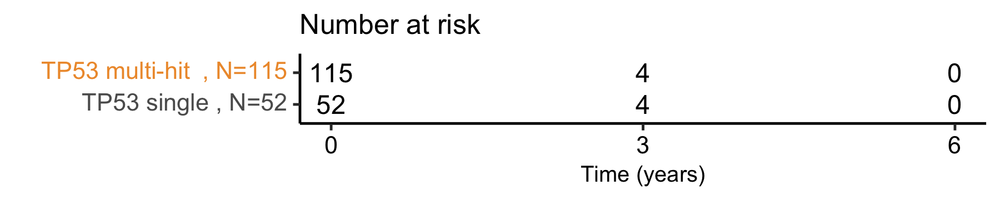

In [16]:
# TP53 VAF Data
df <- read.table("data/genetic_files_main.tsv")
df_TP53 <- df[df$gene=="TP53",]

# Define single vs multi hit : 
# double  : double hit OR tum vaf > 60 OR both TP53 and del17

index_double_mutation_TP53 <- union(union(df_TP53[duplicated(df_TP53$data_pd),]$data_pd,
                                    df_TP53[df_TP53$tum_vaf>60,]$data_pd),
                                    rownames(df_final[df_final$TP53==1 & df_final[,"-17"]==1,]))


index_single_mutation_TP53 <- setdiff(unique(df_TP53$data_pd),index_double_mutation_TP53)

# Single hit TP53
df_single <- df_final[index_single_mutation_TP53,]
df_single$comparison  <- "TP53 single"

# Multi hit TP53
df_multi <- df_final[index_double_mutation_TP53,]
df_multi$comparison  <- "TP53 multi-hit"

# Combined TP53
df_single_multi <- rbind(df_single,df_multi)

# Surv
surv_object <- Surv(time = df_single_multi$os, event = df_single_multi$os_status)
fit <- survfit(surv_object ~ comparison, data = df_single_multi)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_single_multi)

# Surv data
set_notebook_plot_size(15,8)
surv <- plot_surv_curves(fit,legend="top",pval=res,pval.coord=c(0.65,0.71),
                 submain="",risk.tab=T,y="Survival Probability",
                 xlim=c(0,6),break.x.by=3)

# Surv Plot and risk table

surv_plot <- surv$plot
risk_tab <- surv$table

set_notebook_plot_size(15,8)
surv_plot

set_notebook_plot_size(15,3)
risk_tab

## ***B. Comparison of variant allele frequency distribution for TP53 single and multi-hit in the AML NCRI cohort.***

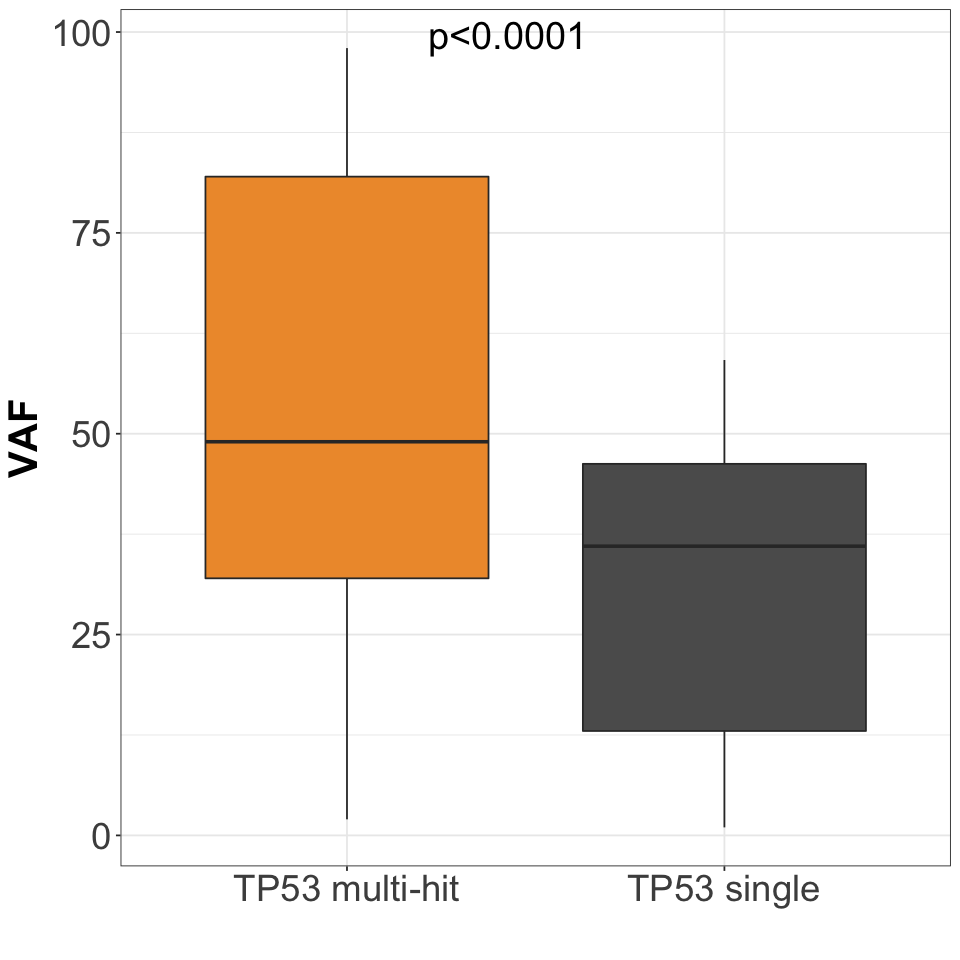

In [17]:
# TP53 VAF Data
df <- read.table("data/genetic_files_main.tsv")
df_TP53 <- df[df$gene=="TP53",]
df_TP53$group <- ifelse(df_TP53$data_pd %in% index_double_mutation_TP53,"TP53 multi-hit","TP53 single")

p <- ggplot(df_TP53, aes(x=group, y=tum_vaf, fill=group)) + 
    geom_boxplot()+
    theme_bw()+
    theme(axis.text=element_text(size=22),
          axis.title=element_text(size=24,face="bold"),
          legend.position = "none")+
    stat_compare_means(paired=F,method = "wilcox",label="p.signif",size=8,label.x=1.3,symnum.args=list(
                       cutpoints = c(0, 0.0001, 0.001, 0.01, 0.05, 1), 
                       symbols = c("p<0.0001", "p<0.001", "p<0.01", "p<0.05", "ns")),color="black")+
    scale_fill_manual(values=c("#EE9937","#5C5C5C"))+
    xlab("")+
    ylab("VAF")

set_notebook_plot_size(8,8)
p

## ***C. Comparison of frequency of complex karyotype patients for TP53 single and multi-hit in the AML NCRI cohort.***

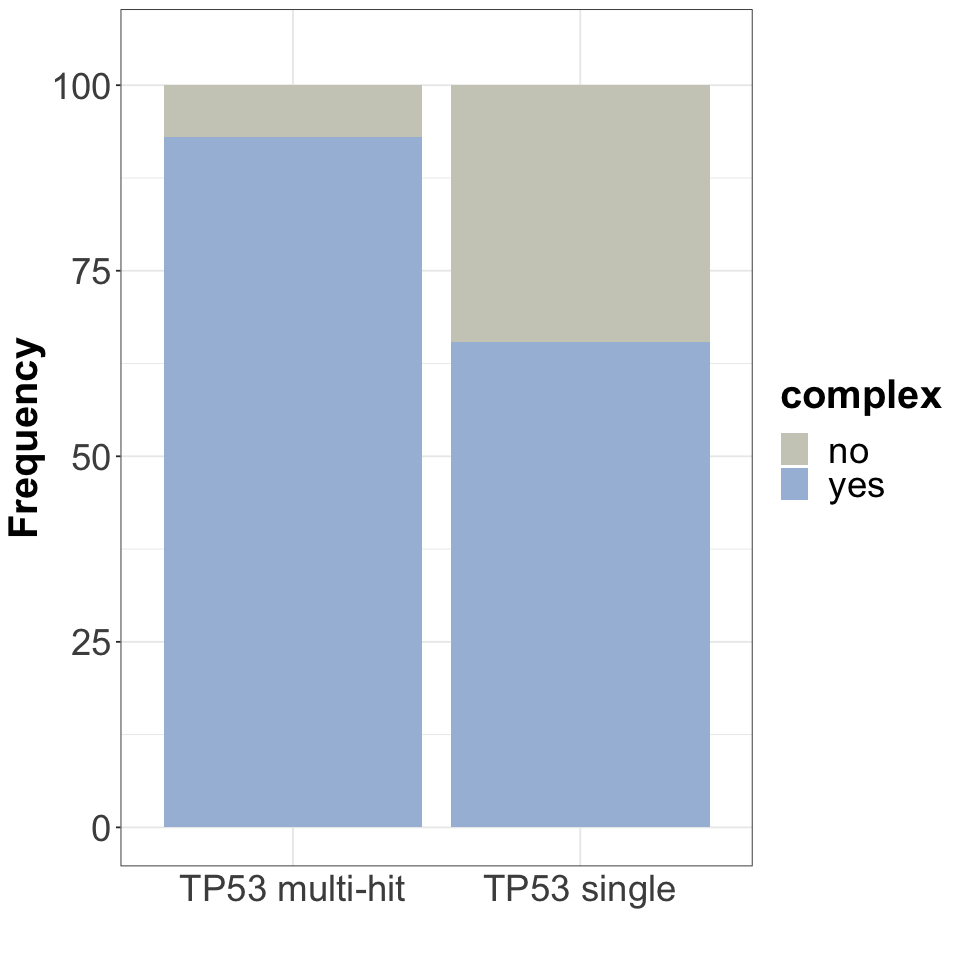

In [18]:
# TP53 VAF Data
df <- read.table("data/genetic_files_main.tsv")
df_TP53 <- df[df$gene=="TP53",]

# Define single vs multi hit : 
# double  : double hit OR tum vaf > 60 OR both TP53 and del17

index_double_mutation_TP53 <- union(union(df_TP53[duplicated(df_TP53$data_pd),]$data_pd,
                                    df_TP53[df_TP53$tum_vaf>60,]$data_pd),
                                    rownames(df_final[df_final$TP53==1 & df_final[,"-17"]==1,]))


index_single_mutation_TP53 <- setdiff(unique(df_TP53$data_pd),index_double_mutation_TP53)

# Single hit TP53
df_single <- df_final[index_single_mutation_TP53,]
df_single$comparison  <- "TP53 single"

# Multi hit TP53
df_multi <- df_final[index_double_mutation_TP53,]
df_multi$comparison  <- "TP53 multi-hit"

# Combined TP53
df_single_multi <- rbind(df_single,df_multi)

# Plot
q <- ggplot(df_single_multi, aes_string(x="comparison",fill=factor(df_single_multi$complex)))+
     geom_bar(position = "fill")+
     theme_bw()+
     theme(axis.ticks.x=element_blank(),
           axis.text=element_text(size=22),
           axis.title=element_text(size=24,face="bold"),
           legend.position = "right",
           legend.title=element_text(size=24,face="bold"),
           legend.text=element_text(size=22))+
     scale_y_continuous(labels = c(0,25,50,75,100),limits=c(0,1.05),breaks=c(0,0.25,0.5,0.75,1))+
     scale_fill_manual(values=c("#CDCDC1", "#a6bddb"),name="complex",breaks=c(0,1),labels=c("no","yes"))+
     xlab("")+
     ylab("Frequency")

set_notebook_plot_size(8,8)
q

# **S. Figure 10: Kaplan-Meier and associated risk table for overall survival curves for patients with trisomies (<3) (grey), trisomies (>=3) (lightgrey) and complex karyotype (burgundy) in the AML NCRI cohort.**

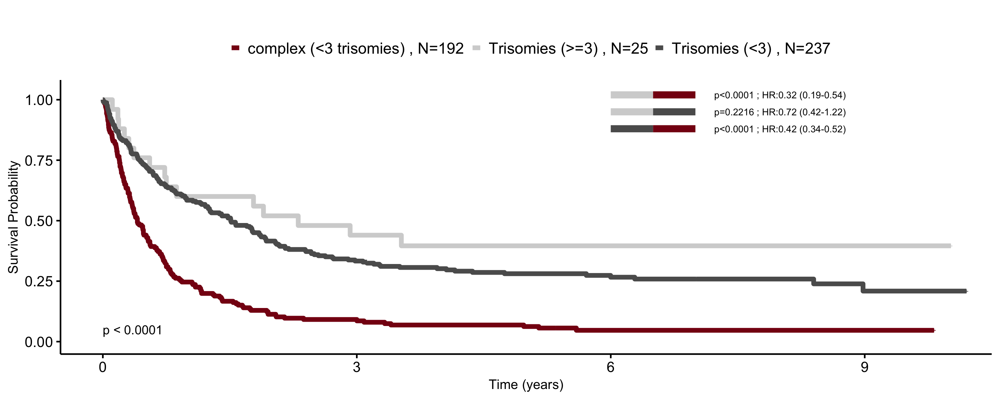

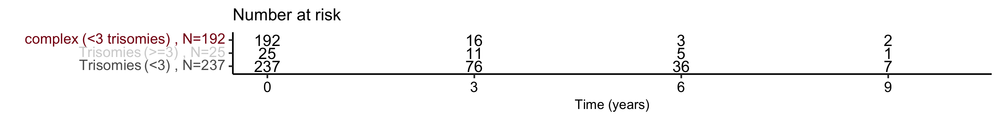

In [19]:
# Get patients with 3 or more trisomies and no deletions :
complex_patients <- rownames(df_final[df_final$complex==1 ,])
additions_patients <- readRDS("data/list_patients_ADDITIONS.rds")
deletions_patients <- readRDS("data/list_patients_DELETIONS.rds")
patients_trisomies_no_deletions <- setdiff(intersect(complex_patients,additions_patients),deletions_patients)

df_patients_trisomies_no_deletions <- df_final[rownames(df_final) %in% patients_trisomies_no_deletions,]
df_patients_trisomies_no_deletions$comparison <- "Trisomies (>=3)"

# Get patients with trisomies (<3), no deletions and therefore not complex
df_trisomies_not_complex <- df_final[df_final$complex==0 & rownames(df_final) %in% additions_patients & !rownames(df_final) %in% deletions_patients ,]
df_trisomies_not_complex$comparison <- "Trisomies (<3)"

# Get all complex patients with less than 3 trisomies
df_other_complexes <- df_final[df_final$complex==1,]
df_other_complexes <- df_other_complexes[! rownames(df_other_complexes) %in%
                                         intersect(rownames(df_other_complexes),rownames(df_patients_trisomies_no_deletions)),] # remove the complex coming only from trisomies
df_other_complexes$comparison <- "complex (<3 trisomies)"

# Combined the 3 groups
df_all <- rbind(df_patients_trisomies_no_deletions,df_trisomies_not_complex,df_other_complexes)
df_all$comparison <- factor(df_all$comparison,levels=c("complex (<3 trisomies)","Trisomies (>=3)","Trisomies (<3)"))

# Surv
surv_object <- Surv(time = df_all$os, event = df_all$os_status)
fit <- survfit(surv_object ~ comparison, data = df_all)

# Get pvalues, HR and CI for the 3 comparisons
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_all[df_all$comparison %in% c("Trisomies (>=3)","complex (<3 trisomies)"),])

res1 <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_all[df_all$comparison %in% c("Trisomies (>=3)","Trisomies (<3)"),])

res2 <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_all[df_all$comparison %in% c("Trisomies (<3)","complex (<3 trisomies)"),])

# Surv Plot and Risk table
set_notebook_plot_size(25,10)
surv <- plot_surv_curves(fit,y="Survival Probability",xlim=c(0,10),break.x.by=3,ylim=c(0,1.03),pval=T,vals=c("#870C14","lightgrey","#5C5C5C"),risk.tab=T)

# Surv Plot
surv_plot <- surv$plot+
             annotate("segment", x = c(6,6.5,6,6.5,6,6.5),
                                 xend = c(6.5,7,6.5,7,6.5,7),
                                 y = c(1.02,1.02,0.95,0.95,0.88,0.88), 
                                 yend = c(1.02,1.02,0.95,0.95,0.88,0.88),
                                 size=6,
                                 colour = c("lightgrey","#870C14","lightgrey","#5C5C5C","#5C5C5C","#870C14"))+ 
             annotate(geom="text", x=rep(8,3) , y=c(1.02,0.95,0.88), label=c(res,res1,res2),size=6)

set_notebook_plot_size(25,10)
surv_plot

# Risk table
surv_table <- surv$table

set_notebook_plot_size(25,3)
surv_table

# **S. Figure 11: Kaplan-Meier and associated risk table for overall survival curves for the 2 secondary AML like classes in the AML NCRI cohort (N=2,113).**

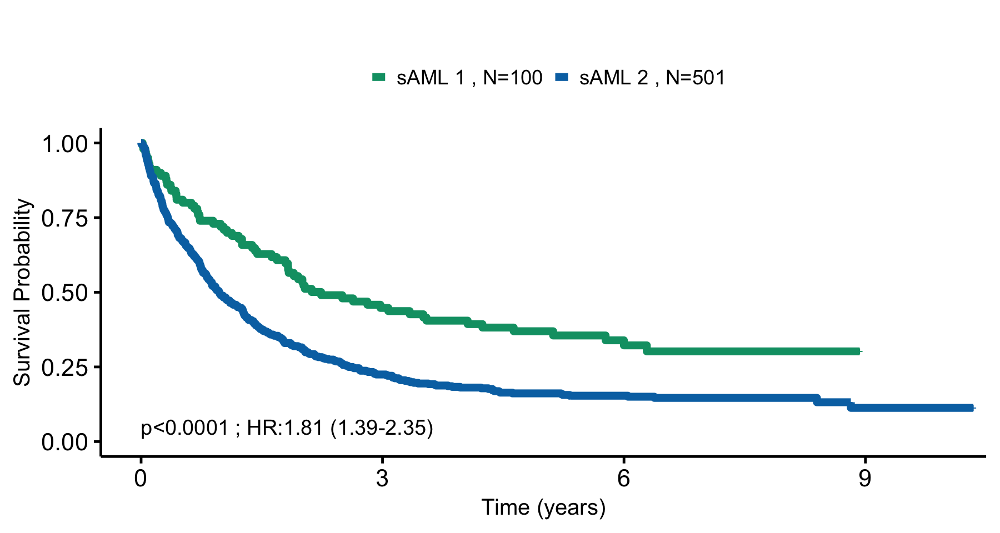

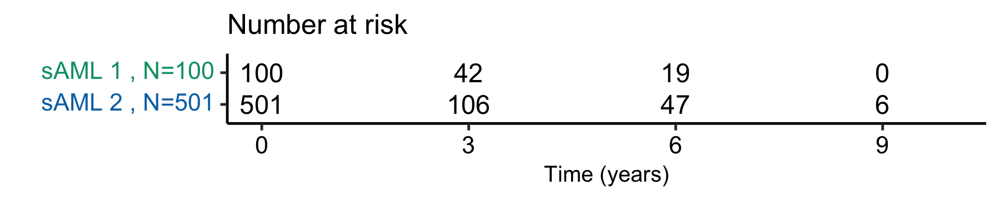

In [20]:
# Prepare sAML Comparison
df_sAML <- df_final
df_sAML$comparison <- ifelse(df_sAML$principal_component_sAML2==1,"sAML 2",ifelse(df_sAML$principal_component_sAML1==1,"sAML 1","Not sAML"))
df_sAML <- df_sAML[df_sAML$comparison!="Not sAML",]

# Surv
surv_object <- Surv(time = df_sAML$os, event = df_sAML$os_status)
fit <- survfit(surv_object ~ comparison, data = df_sAML)

# Get pvalue and HR-CI
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_sAML)

# Surv
surv <- plot_surv_curves(fit,legend="top",font.legend=22,
                 submain="",risk.tab=T,y="Survival Probability",vals = c(color_values$sAML1,color_values$sAML2),
                 xlim=c(0,10),break.x.by=3,pval=res)

# Surv Plot               
surv_plot <- surv$plot

set_notebook_plot_size(15,8)
surv_plot

# Risk table
surv_table <- surv$table

set_notebook_plot_size(15,3)
surv_table

# **S.Figure 12: Prognostic relevance of mutation number in sAML Like subgroups.**

## ***A.1 Training Cohort.***

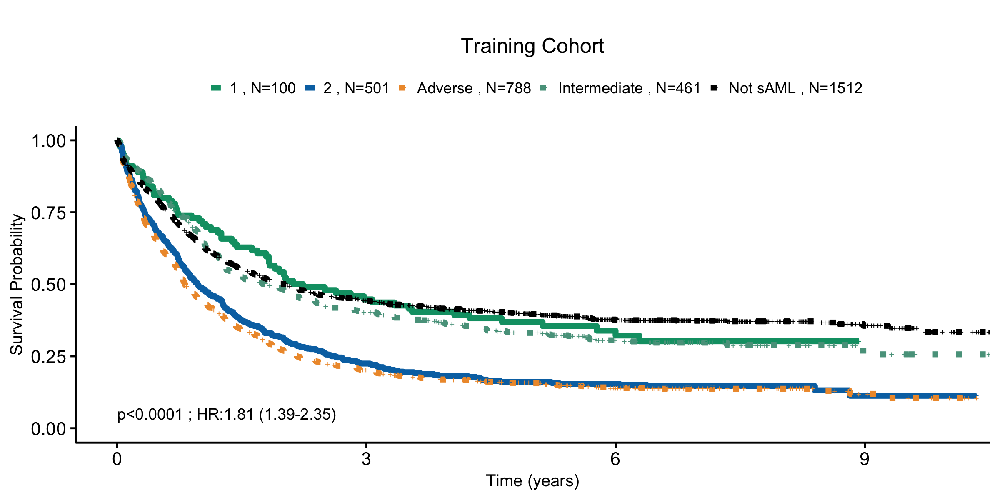

In [21]:
# sAML data
df_sAML <- df_final
df_sAML$comparison <- ifelse(df_sAML$principal_component_sAML2==1,"2",ifelse(df_sAML$principal_component_sAML1==1,"1","Not sAML"))

# ELN data
df_ELN <- df_final[df_final$eln_2017_adverse==1 | df_final$eln_2017_intermediate==1 ,]
df_ELN$comparison <- ifelse(df_ELN$eln_2017_adverse==1,"Adverse","Intermediate")

# Combined data
df_combined <- rbind(df_sAML,df_ELN)
df_combined$comparison <- factor(df_combined$comparison,levels=c("1","2","Adverse","Intermediate","Not sAML"))

# Surv
surv_object <- Surv(time = df_combined$os, event = df_combined$os_status)
fit <- survfit(surv_object ~ comparison, data = df_combined)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_combined[df_combined$comparison %in% c("1","2"),])

# Plot
p <- plot_surv_curves(fit,legend="top",font.legend=22,
                      submain="",risk.tab=F,y="Survival Probability",
                      vals = c(color_values$sAML1,color_values$sAML2,"#EE9937","#59A08B","black"),
                      pval=res,xlim=c(0,10),break.x.by=3,linetype=c(1,1,3,3,3))$plot+
     theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
     ggtitle("Training Cohort")

set_notebook_plot_size(20,10)
p


## ***A.2 Validation Cohort.***

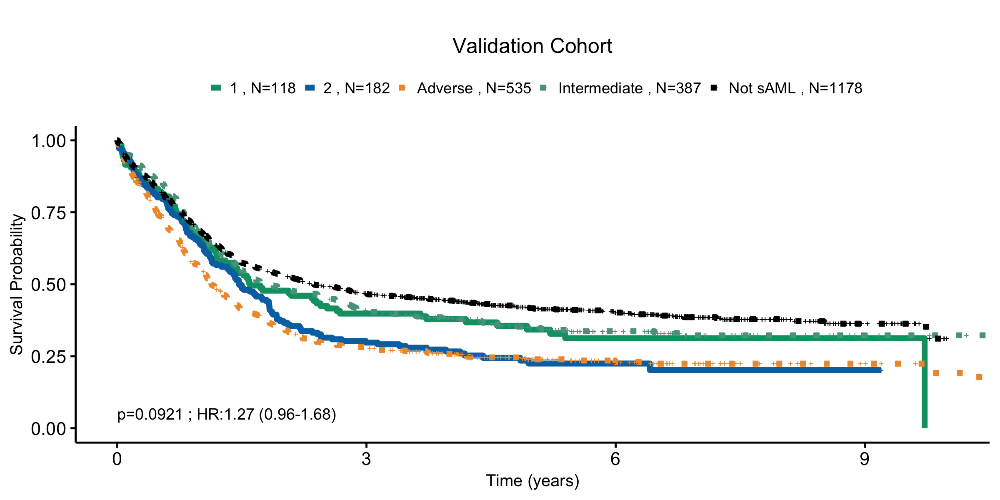

In [22]:
# sAML data
df_sAML <- df_validation
df_sAML <- df_sAML[df_sAML$OS<10,] # smooth out surv plot to 10 years
df_sAML$comparison <- ifelse(df_sAML$principal_component_sAML2==1,"2",ifelse(df_sAML$principal_component_sAML1==1,"1","Not sAML"))

# ELN data
df_ELN <- df_validation[df_validation$eln_2017_adverse==1 | df_validation$eln_2017_intermediate==1 ,]
df_ELN$comparison <- ifelse(df_ELN$eln_2017_adverse==1,"Adverse","Intermediate")

# Combined data
df_combined <- rbind(df_sAML,df_ELN)
df_combined$comparison <- factor(df_combined$comparison,levels=c("1","2","Adverse","Intermediate","Not sAML"))

# Surv
surv_object <- Surv(time = df_combined$OS, event = df_combined$OS_Status)
fit <- survfit(surv_object ~ comparison, data = df_combined)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(OS,OS_Status)~comparison,data = df_combined[df_combined$comparison %in% c("1","2"),])

# Plot
p <- plot_surv_curves(fit,legend="top",font.legend=22,
                      submain="",risk.tab=F,y="Survival Probability",
                      vals = c(color_values$sAML1,color_values$sAML2,"#EE9937","#59A08B","black"),
                      pval=res,xlim=c(0,10),break.x.by=3,linetype=c(1,1,3,3,3))$plot+
     theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
     ggtitle("Validation Cohort")

set_notebook_plot_size(20,10)
p


## ***B.1 Overall survival merged cohort.***

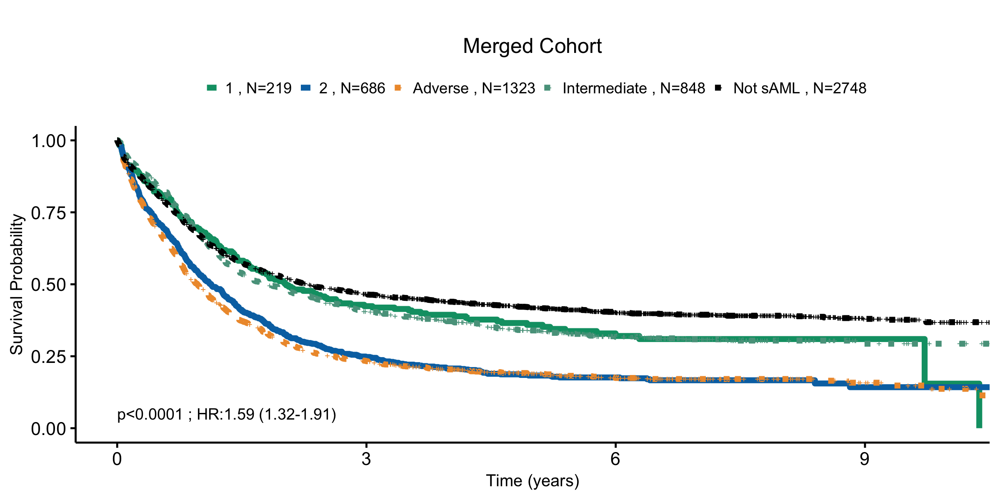

In [23]:
# Merge training and validation cohorts
data_training <- df_final
data_validation <- df_validation
data_validation$os <- data_validation$OS
data_validation$os_status <- data_validation$OS_Status
data_merge <- rbind(data_training[,c("os","os_status","principal_component_sAML1","principal_component_sAML2","eln_2017_intermediate","eln_2017_adverse")],
                    data_validation[,c("os","os_status","principal_component_sAML1","principal_component_sAML2","eln_2017_intermediate","eln_2017_adverse")])

# sAML data
df_sAML <- data_merge 
df_sAML$comparison <- ifelse(df_sAML$principal_component_sAML2==1,"2",ifelse(df_sAML$principal_component_sAML1==1,"1","Not sAML"))

#ELN data
df_ELN <- data_merge[data_merge$eln_2017_adverse==1 | data_merge$eln_2017_intermediate==1 ,]
df_ELN$comparison <- ifelse(df_ELN$eln_2017_adverse==1,"Adverse","Intermediate")

#Combined data
df_combined <- rbind(df_sAML,df_ELN)
df_combined$comparison <- factor(df_combined$comparison,levels=c("1","2","Adverse","Intermediate","Not sAML"))

# Surv
surv_object <- Surv(time = df_combined$os, event = df_combined$os_status)
fit <- survfit(surv_object ~ comparison, data = df_combined)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_combined[df_combined$comparison %in% c("1","2"),])

# Plot
p <- plot_surv_curves(fit,legend="top",font.legend=22,
                      submain="",risk.tab=F,y="Survival Probability",
                      vals = c(color_values$sAML1,color_values$sAML2,"#EE9937","#59A08B","black"),
                      pval=res,xlim=c(0,10),break.x.by=3,linetype=c(1,1,3,3,3))$plot+
     theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
     ggtitle("Merged Cohort")

set_notebook_plot_size(20,10)
p


## ***B.2 Gene by gene merged cohort.***

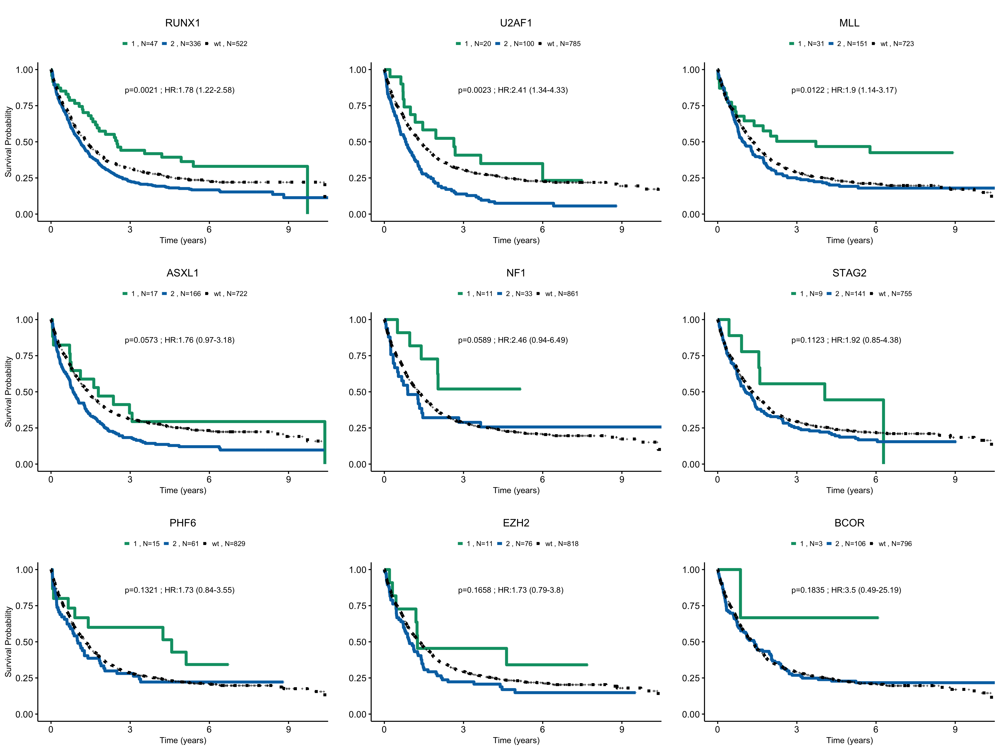

In [24]:
# Merge training and validation cohorts
data_training <- df_final
data_training$U2AF1 <- ifelse(data_training$U2AF1_p.S34+data_training$U2AF1_p.Q157 >=1,1,0)
data_validation <- df_validation
data_validation$os <- data_validation$OS
data_validation$os_status <- data_validation$OS_Status
specific_genes <- c("RUNX1","U2AF1","MLL","ASXL1","NF1","STAG2","PHF6","EZH2","BCOR")
data_merge <- rbind(data_training[,c("os","os_status",specific_genes,"principal_component_sAML1","principal_component_sAML2")],
                   data_validation[,c("os","os_status",specific_genes,"principal_component_sAML1","principal_component_sAML2")])

surv_plot <- list()
count <- 1
for (fac in specific_genes){
    # Specific gene data
    df_fac <- data_merge
    df_fac$comparison <- ifelse(df_fac[,fac]==1 & df_fac$principal_component_sAML1==1 ,"1",
                             ifelse(df_fac[,fac]==1 & df_fac$principal_component_sAML2==1 ,"2",
                                    ifelse(df_fac$principal_component_sAML2==1 | df_fac$principal_component_sAML1==1 ,"wt","others")))
    df_fac <- df_fac[df_fac$comparison!="others",]
    
    # Surv
    surv_object <- Surv(time = df_fac$os, event = df_fac$os_status)
    fit <- survfit(surv_object ~ comparison, data = df_fac)

    # Get pvalue and HR 
    res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_fac[df_fac$comparison %in% c("1","2"),])

    # Plot
    surv_plot[[fac]] <- plot_surv_curves(fit,legend="top",vals=c(color_values$sAML1,color_values$sAML2,"black"),
                                         submain="",y=ifelse(count %%3 ==1,"Survival Probability",""),font.legend=20,
                                         pval=res,xlim=c(0,10),break.x.by=3,pval.coord=c(2.8,0.86),linetype=c(1,1,3))$plot+
                        theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
                        ggtitle(fac)
    count<- count+1
}

set_notebook_plot_size(40,30)
do.call("grid.arrange",c(surv_plot,ncol=3))

# **S.Figure 13: Prognostic relevance of AHD in sAML2.**

In [14]:
res <- pairwise_survdiff(Surv(os,os_status)~ahd,df_sAML2)
sum <- summary(coxph(Surv(os,os_status)~ahd,df_sAML2, method = "breslow"))
index <- ifelse(!is.na(sum$conf.int[1, 1]), 1, 2)
text_HR <- paste("; HR:", round(sum$conf.int[index, 1], 2), 
        " (", round(sum$conf.int[index, 3], 2), "-", round(sum$conf.int[index, 
            4], 2), ")", sep = "")
res <- paste(res, text_HR)

function (formula, data, text = "p") 
{
    res <- pairwise_survdiff(formula, data)
    try(res <- ifelse(round(res$p.value[1], 4) == 0, paste(text, 
        "<0.0001", sep = ""), paste(text, "=", round(res$p.value[1], 
        4), sep = "")))
    sum <- summary(coxph(formula, data, method = "breslow"))
    index <- ifelse(!is.na(sum$conf.int[1, 1]), 1, 2)
    text_HR <- paste("; HR:", round(sum$conf.int[index, 1], 2), 
        " (", round(sum$conf.int[index, 3], 2), "-", round(sum$conf.int[index, 
            4], 2), ")", sep = "")
    res <- paste(res, text_HR)
    return(res)
}
<bytecode: 0x7fbf0b28dfd8>

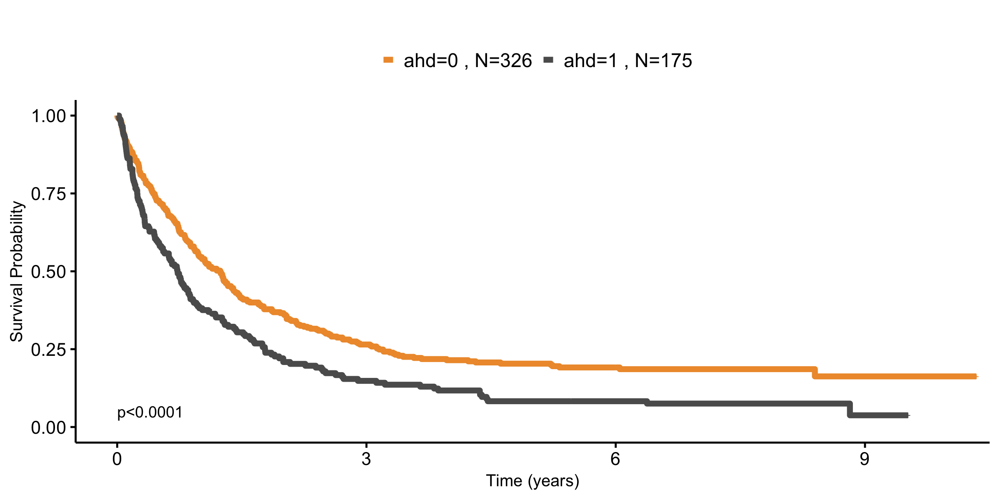

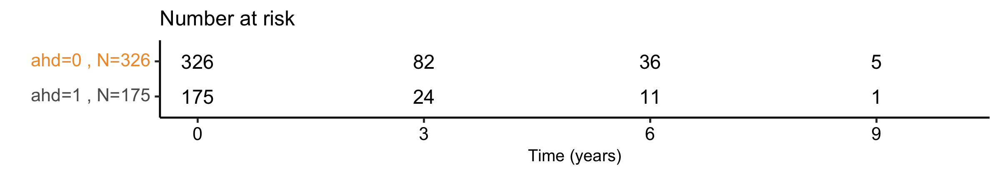

In [15]:
# sAML2 data
df_sAML2 <- df_final[df_final$principal_component_sAML2==1,]

# Surv
surv_object <- Surv(time = df_sAML2$os, event = df_sAML2$os_status)
fit <- survfit(surv_object ~ ahd, data = df_sAML2)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~ahd,data = df_sAML2)
res <- pairwise_survdiff(Surv(os,os_status)~ahd,df_sAML2)
res <- ifelse(res$p.value[1]<0.0001,"p<0.0001",res)
p <- plot_surv_curves(fit,y="Survival Probability",xlim=c(0,10),pval=res,break.x.by=3,risk.tab=T)

# Surv Plot
set_notebook_plot_size(20,10)
p$plot

# Surv Table
set_notebook_plot_size(20,3.5) 
p$table


# **S.Figure 14: Kaplan-Meier Curves for OS and associated risk table for RUNX1 mutationfor the 2 secondary AML like classes in the AML NCRI cohort (N=2,113).** 

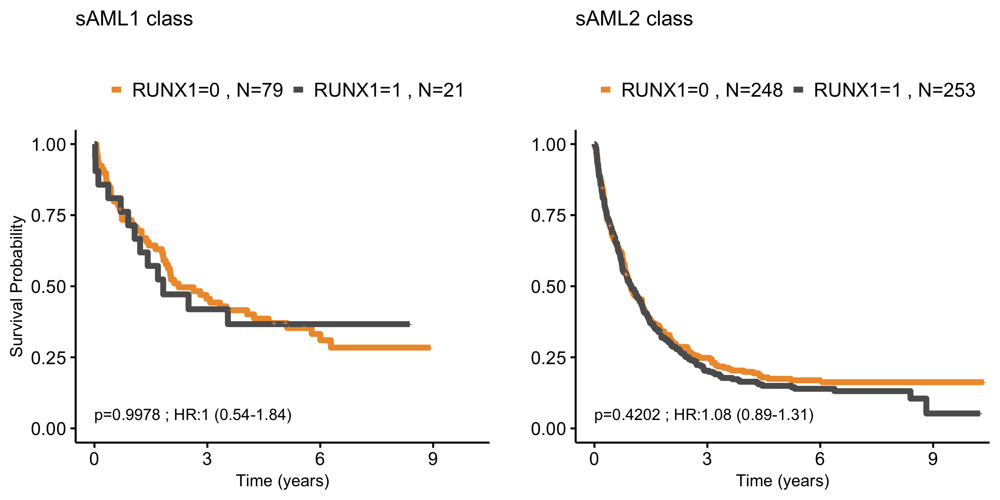

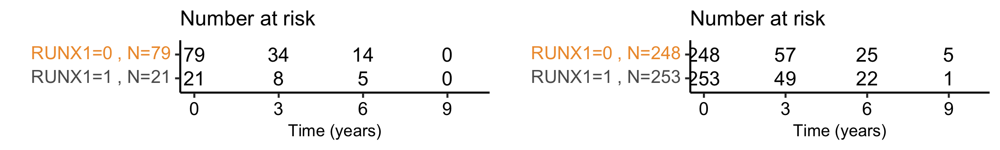

In [26]:
# sAML1 data
df_sAML1 <- df_final[df_final$principal_component_sAML1==1,]
surv_object <- Surv(time = df_sAML1$os, event = df_sAML1$os_status)
fit <- survfit(surv_object ~ RUNX1, data = df_sAML1)
# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~RUNX1,data = df_sAML1)
# Surv sAML1
surv_sAML1 <-  plot_surv_curves(fit,y="Survival Probability",xlim=c(0,10),break.x.by=3,title="sAML1 class",pval=res,risk.tab=T)

# sAML2 data
df_sAML2 <- df_final[df_final$principal_component_sAML2==1,]
surv_object <- Surv(time = df_sAML2$os, event = df_sAML2$os_status)
fit <- survfit(surv_object ~ RUNX1, data = df_sAML2)
# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~RUNX1,data = df_sAML2)
# Surv sAML2
surv_sAML2 <- plot_surv_curves(fit,y="",xlim=c(0,10),break.x.by=3,title="sAML2 class",pval=res,risk.tab=T)

# Surv Plot
set_notebook_plot_size(20,10)
grid.arrange(surv_sAML1$plot,surv_sAML2$plot,nrow=1)
# Surv Table
set_notebook_plot_size(20,3)
grid.arrange(surv_sAML1$table,surv_sAML2$table,nrow=1)


# **S.Figure 15: WT1 Class.**

## ***A. WT1 Age Comparison.***

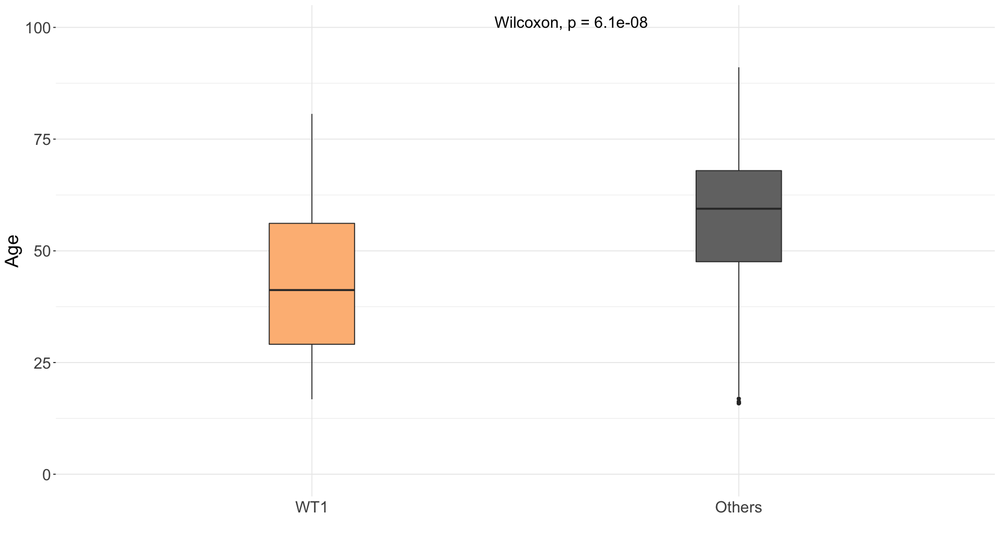

In [27]:
df_WT1_age <- df_final
df_WT1_age$comparison <- ifelse(df_WT1_age$principal_component_WT1==1,"WT1","Others")
df_WT1_age$comparison <- factor(df_WT1_age$comparison,levels=c("WT1","Others"))


plot_WT1_age <- ggplot(df_WT1_age,aes_string(x="comparison",y=df_WT1_age$age)) +
                theme_bw()+
                theme(legend.position = "none",axis.ticks.x=element_blank(),axis.title.y=element_text(size=20),
                      axis.text=element_text(size=17),panel.border = element_rect(colour = "black", fill=NA, size=0))+
                geom_boxplot(aes(fill = factor(comparison)),width=0.2)+
                scale_fill_manual(values=c(color_values$WT1,"grey45"))+
                ylab("Age")+ylim(c(0,100))+
                xlab("")+
                stat_compare_means(paired=F,method="wilcox.test",size=6,label.x=1.5,color="black")

set_notebook_plot_size(15,8)
plot_WT1_age


## ***B. WT1 Class with ITD Survival***

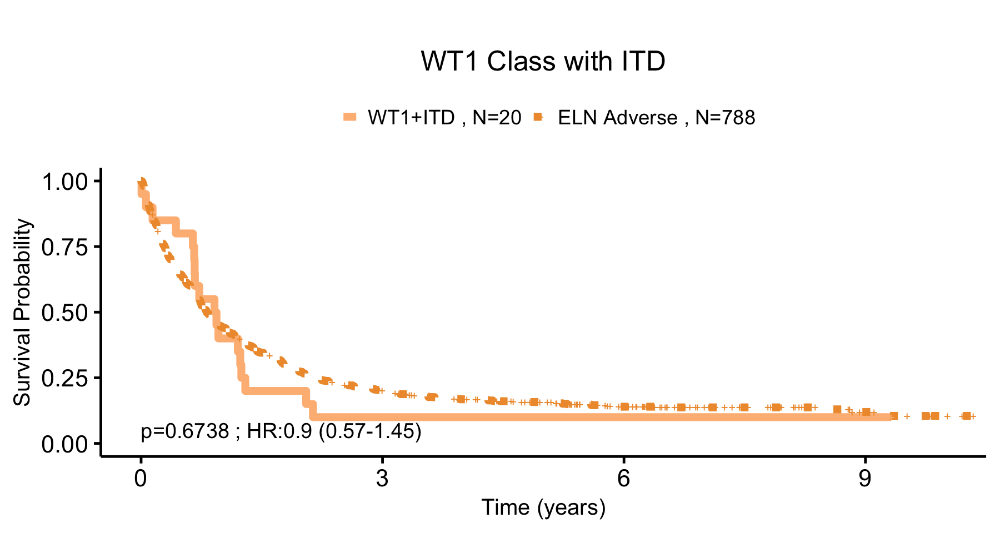

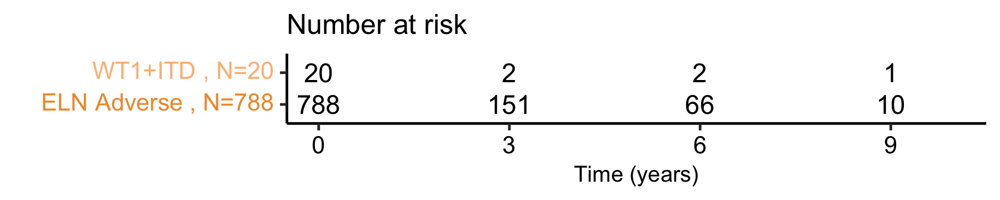

In [28]:
# WT1 + ITD data
df_WT1_ITD <- df_final[df_final$principal_component_WT1==1 & df_final$ITD==1 ,]
df_WT1_ITD$comparison <- "WT1+ITD"

# ELN Adverse data
df_ELN_Adverse <- df_final[df_final$eln_2017_adverse==1 ,]
df_ELN_Adverse$comparison <- "ELN Adverse"

# Combined data
df_all <- rbind(df_WT1_ITD,df_ELN_Adverse)
df_all$comparison <- factor(df_all$comparison,levels=c("WT1+ITD","ELN Adverse"))

surv_object <- Surv(time = df_all$os, event = df_all$os_status)
fit <- survfit(surv_object ~ comparison, data = df_all)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_all)

# Surv
surv_WT1_ITD <- plot_surv_curves(fit,legend="top",font.legend=22,submain="",
                                 risk.tab=T,y="Survival Probability",
                                 vals = c(color_values$WT1,"#EE9937"),linetype=c(1,3),
                                 pval=res,xlim=c(0,10),break.x.by=3)
# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_all)

# Surv Plot
set_notebook_plot_size(15,8)
surv_WT1_ITD_plot <- surv_WT1_ITD$plot+
                     ggtitle("WT1 Class with ITD")+
                     theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))
surv_WT1_ITD_plot

# Surv Table
set_notebook_plot_size(15,3)
surv_WT1_ITD$table







## ***C. WT1 Class without ITD Survival***

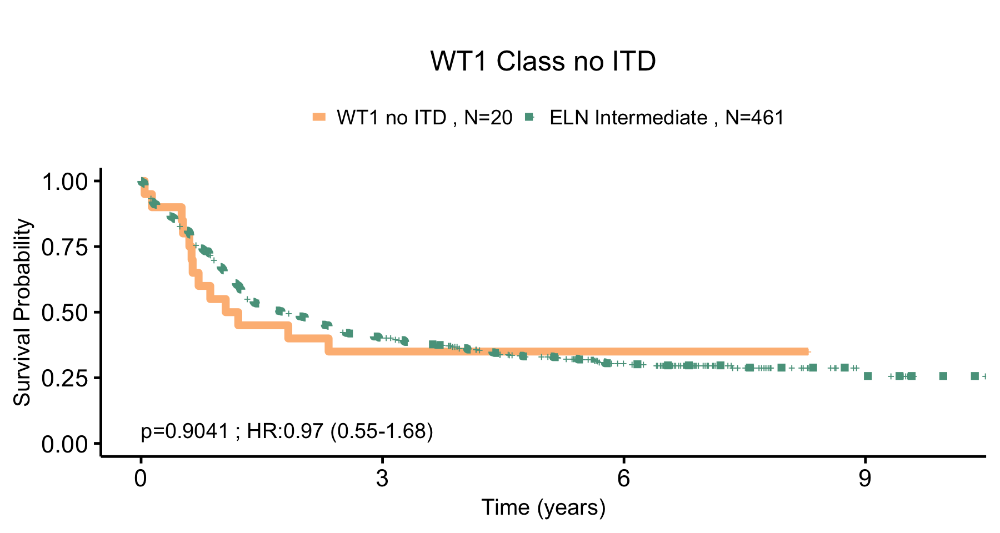

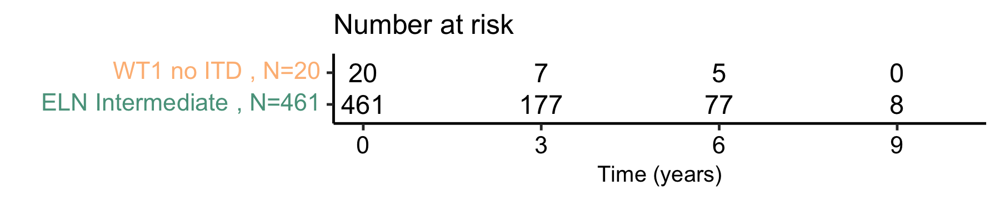

In [29]:
# WT1 without ITD data
df_WT1_NO_ITD <- df_final[df_final$principal_component_WT1==1 & df_final$ITD==0 ,]
df_WT1_NO_ITD$comparison <- "WT1 no ITD"

# ELN Intermediate data
df_ELN_Intermediate <- df_final[df_final$eln_2017_intermediate==1 ,]
df_ELN_Intermediate$comparison <- "ELN Intermediate"

# Combined data
df_all <- rbind(df_WT1_NO_ITD,df_ELN_Intermediate)
df_all$comparison <- factor(df_all$comparison,levels=c("WT1 no ITD","ELN Intermediate"))

surv_object <- Surv(time = df_all$os, event = df_all$os_status)
fit <- survfit(surv_object ~ comparison, data = df_all)

# Get pvalue and HR
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_all)

# Surv
surv_WT1_NO_ITD <- plot_surv_curves(fit,legend="top",font.legend=22,submain="",
                                    risk.tab=T,y="Survival Probability",
                                    vals = c(color_values$WT1,"#59A08B"),linetype=c(1,3),
                                    pval=res,xlim=c(0,10),break.x.by=3)

# Surv Plot
set_notebook_plot_size(15,8)
surv_WT1_NO_ITD_plot <- surv_WT1_NO_ITD$plot+
                        ggtitle("WT1 Class no ITD")+
                        theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))
surv_WT1_NO_ITD_plot

# Surv Table
set_notebook_plot_size(15,3)
surv_WT1_NO_ITD$table


# **S.Figure 16: DNMT3A-IDH class.**

## ***A. DNMT3A-IDH overall survival.***

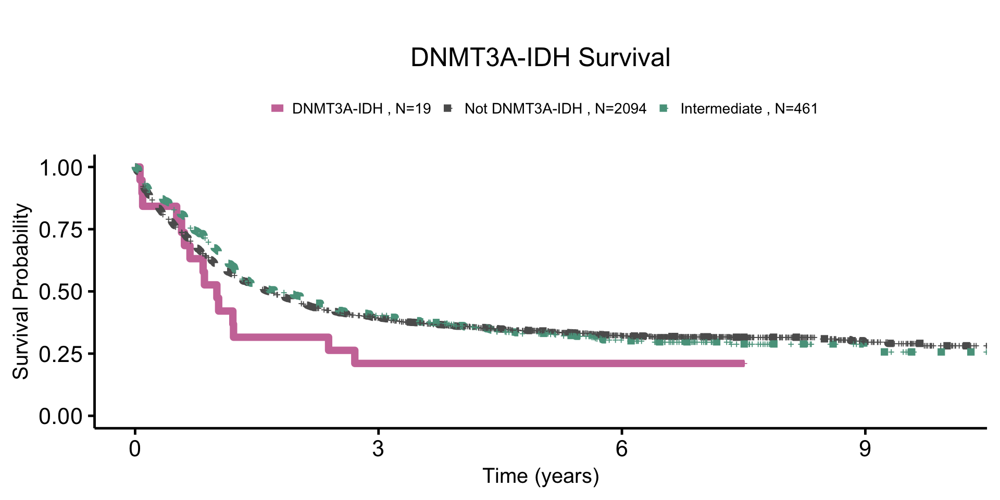

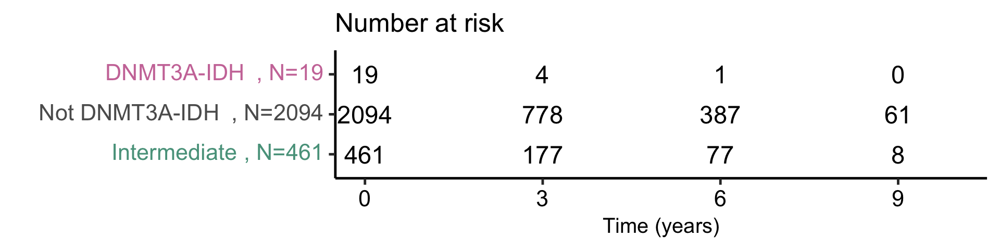

In [30]:
# DNMT3A-IDH data
df_DNMT3A_IDH <- df_final
df_DNMT3A_IDH$comparison <- ifelse(df_DNMT3A_IDH$principal_component_DNMT3A_IDH1_2==1,"DNMT3A-IDH","Not DNMT3A-IDH")

# ELN Intermediate data
df_ELN_Intermediate <- df_final[df_final$eln_2017_intermediate==1,]
df_ELN_Intermediate$comparison <- "Intermediate"

# Combined data
df_all <- rbind(df_DNMT3A_IDH,df_ELN_Intermediate)
df_all$comparison <- factor(df_all$comparison,levels=c("DNMT3A-IDH","Not DNMT3A-IDH","Intermediate"))

# Surv
surv_object <- Surv(time = df_all$os, event = df_all$os_status)
fit <- survfit(surv_object ~ comparison, data = df_all)
surv_all <- plot_surv_curves(fit,vals=c("#CC79A7","#5C5C5C","#59A08B"),pval=F,font.legend=17,
                 y="Survival Probability",xlim=c(0,10),break.x.by=3,linetype=c(1,3,3),risk.tab=T)

# Surv Plot
set_notebook_plot_size(16,8)
surv_all_plot <- surv_all$plot+
theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
ggtitle("DNMT3A-IDH Survival")
surv_all_plot
# Surv Table
set_notebook_plot_size(16,4)
surv_all$table

## ***B. DNMT3A-IDH2 140 survival.***

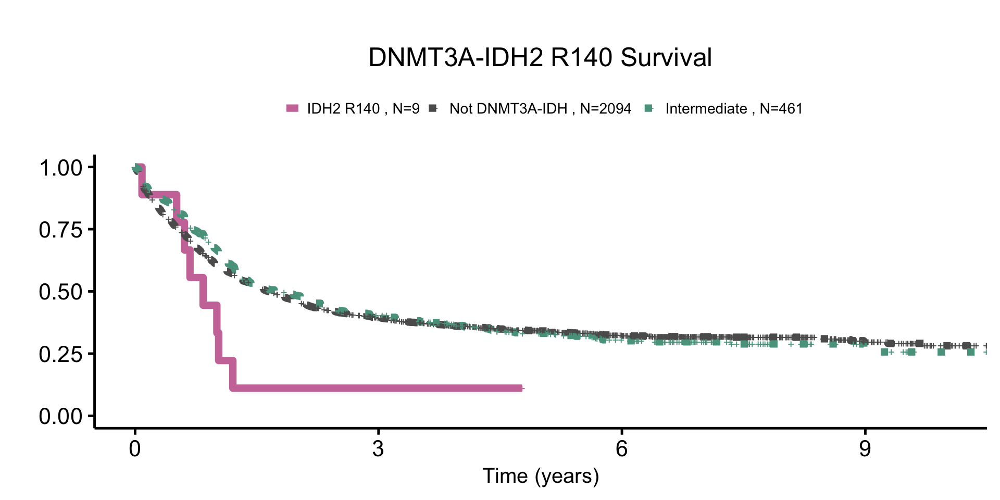

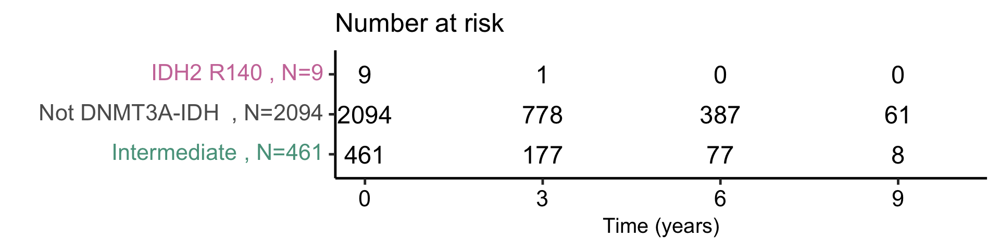

In [31]:
# IDH Zoom data
df_IDH_comparison <- df_final
df_IDH_comparison$comparison <- ifelse(df_IDH_comparison$principal_component_DNMT3A_IDH1_2==1 & df_IDH_comparison$IDH2_p.R140==1 ,"IDH2 R140",
                                ifelse(df_IDH_comparison$principal_component_DNMT3A_IDH1_2==1 & df_IDH_comparison$IDH2_p.R172==1 ,"IDH2 R172",
                                ifelse(df_IDH_comparison$principal_component_DNMT3A_IDH1_2==1 & df_IDH_comparison$IDH1==1 ,"IDH1","Not DNMT3A-IDH")))

# ELN Intermediate data
df_ELN_Intermediate <- df_final[df_final$eln_2017_intermediate==1,]
df_ELN_Intermediate$comparison <- "Intermediate"

df_all <- rbind(df_IDH_comparison,df_ELN_Intermediate)
df_all$comparison <- factor(df_all$comparison,levels=c("IDH2 R140","IDH2 R172","IDH1","Not DNMT3A-IDH","Intermediate"))

# Zoom on IDH 140 data
df_IDH140 <- df_all[df_all$comparison %in% c("IDH2 R140","Not DNMT3A-IDH","Intermediate"),]

# Surv
surv_object <- Surv(time = df_IDH140$os, event = df_IDH140$os_status)
fit <- survfit(surv_object ~ comparison, data = df_IDH140)
surv_140 <- plot_surv_curves(fit,vals=c("#CC79A7","#5C5C5C","#59A08B"),pval=F,font.legend=17,
                 y="",xlim=c(0,10),break.x.by=3,linetype=c(1,3,3),risk.tab=T)

# Surv Plot
set_notebook_plot_size(16,8)
surv_140_plot <- surv_140$plot+
theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
ggtitle("DNMT3A-IDH2 R140 Survival")
surv_140_plot

# Surv Table
set_notebook_plot_size(16,4)
surv_140$table

## ***C. DNMT3A-IDH2 172 survival.***

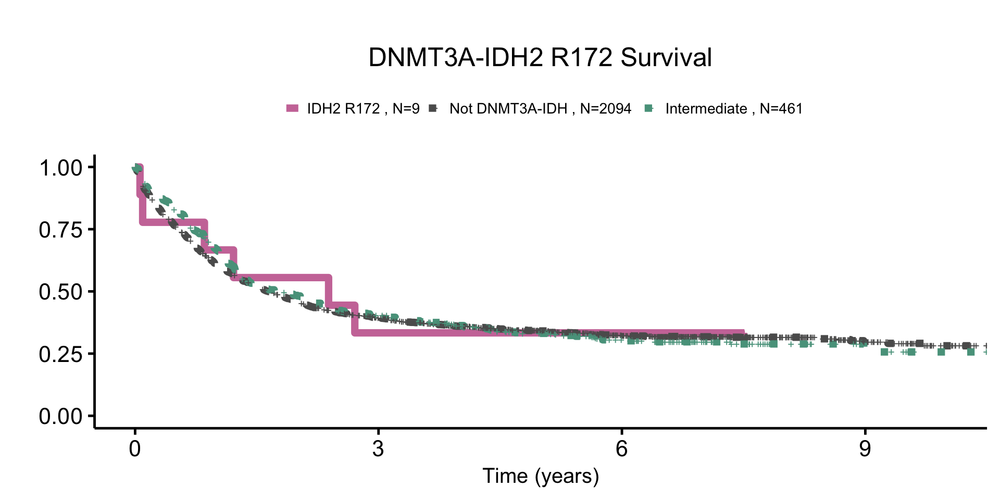

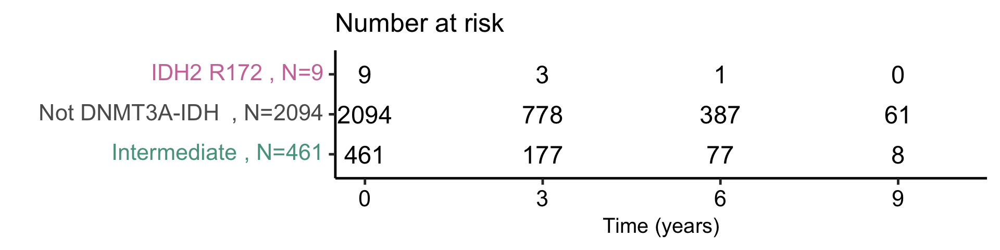

In [32]:
# Zoom on 172 data
df_IDH172 <- df_all[df_all$comparison %in% c("IDH2 R172","Not DNMT3A-IDH","Intermediate"),]

# Surv
surv_object <- Surv(time = df_IDH172$os, event = df_IDH172$os_status)
fit <- survfit(surv_object ~ comparison, data = df_IDH172)
surv_172 <- plot_surv_curves(fit,vals=c("#CC79A7","#5C5C5C","#59A08B"),pval=F,font.legend=17,
                 y="",xlim=c(0,10),break.x.by=3,linetype=c(1,3,3),risk.tab=T)

# Surv Plot
set_notebook_plot_size(16,8)
surv_172_plot <- surv_172$plot+
theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
ggtitle("DNMT3A-IDH2 R172 Survival")
surv_172_plot

# Surv Table
set_notebook_plot_size(16,4)
surv_172$table


# **S.Figure 17: Overall survival K-M curves by AML class.**

10 Years Survival Estimates : 
NPM1 0.38 (0.32-0.45) 
t(11) 0.32 (0.23-0.45) 
TP53_complex 0.02 (0.01-0.07) 
sAML2 0.11 (0.07-0.17) 
sAML1 0.3 (0.22-0.42) 
CEBPA_bi 0.45 (0.3-0.68) 
DNMT3A_IDH1_2 0.21 (0.09-0.5) 
inv(3) 0 (NA-NA) 
mNOS 0.25 (0.13-0.47) 
t(8;21) 0.66 (0.57-0.76) 
no_events 0.37 (0.24-0.56) 
WT1 0.22 (0.13-0.4) 
inv(16) 0.68 (0.58-0.79) 
Trisomies 0.18 (0.04-0.77) 
t(6;9) 0.17 (0.05-0.54) 
t(15;17) 0.79 (0.63-1) 
ELN Favorable 0.45 (0.4-0.51) 
ELN Intermediate 0.26 (0.19-0.34) 
ELN Adverse 0.1 (0.07-0.15) 


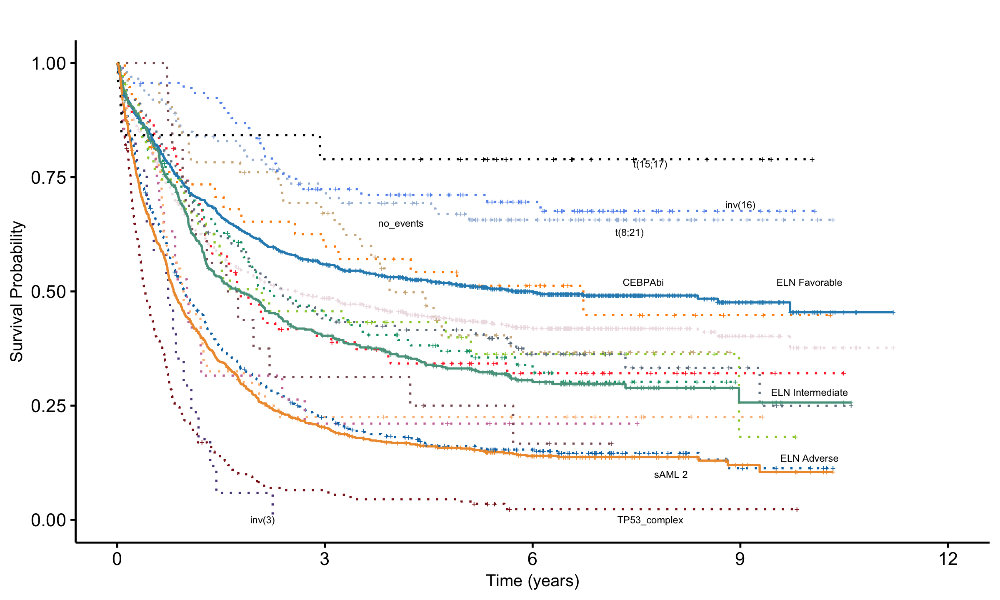

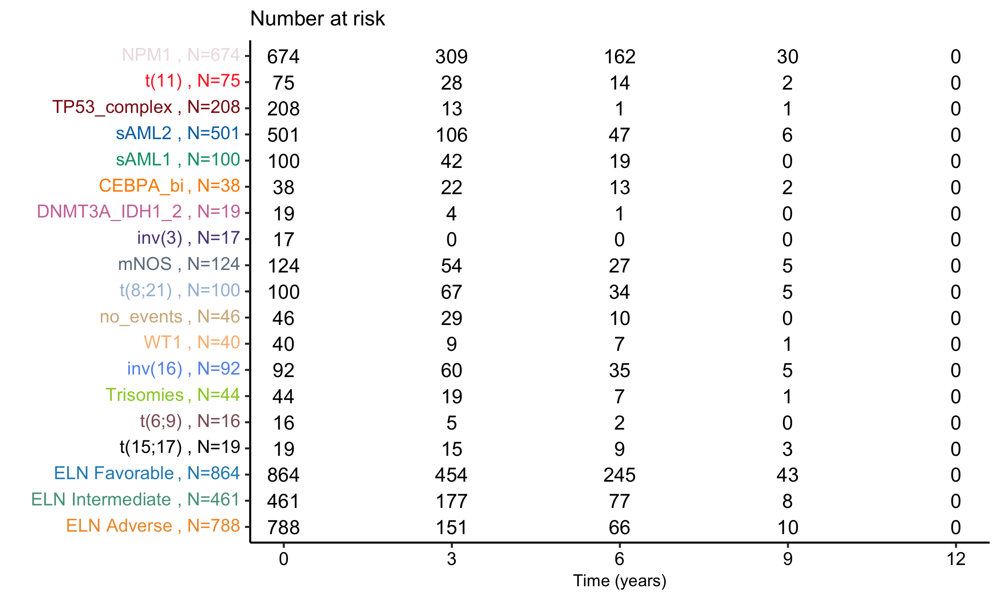

In [33]:
# Classes data
df_classes <- df_final
df_classes$comparison <- str_remove(df_classes$princ_comp,"principal_component_")
df_classes$comparison <- ifelse(df_classes$comparison=="t_11","t(11)",
                               ifelse(df_classes$comparison=="inv_3","inv(3)",
                                     ifelse(df_classes$comparison=="t_8_21","t(8;21)",
                                           ifelse(df_classes$comparison=="inv_16","inv(16)",
                                                 ifelse(df_classes$comparison=="t_6_9","t(6;9)",
                                                       ifelse(df_classes$comparison=="t_15_17","t(15;17)",df_classes$comparison))))))
# EL data
df_ELN <- df_final
df_ELN$comparison <- ifelse(df_ELN$eln_2017==1,"ELN Adverse",
                          ifelse(df_ELN$eln_2017==2,"ELN Intermediate","ELN Favorable"))

# Combined data                       
df_all <- rbind(df_classes,df_ELN)
df_all$comparison <- factor(df_all$comparison,levels=unique(df_all$comparison))

# Surv 
surv_object <- Surv(time = df_all$os, event = df_all$os_status)
fit <- survfit(surv_object ~ comparison, data = df_all)
surv_data <- plot_surv_curves(fit,submain = "",vals=unlist(unname(color_values[levels(df_all$comparison)])),
                      linetype=c(rep(3,16),1,1,1),size=1.5,y="Survival Probability",legend="none",risk.tab=T,pval="",
                     xlim=c(0,12),break.x.by=3)

# 10 Years Survival Estimates :
cat("10 Years Survival Estimates :","\n")
for  (i in 1:length(unique(df_all$comparison))){
    cat(levels(df_all$comparison)[i],paste(round(summary(fit,t=10,extend=TRUE)$surv,2)[i]," (",sep="",
        round(summary(fit,t=10,extend=TRUE)$lower,2)[i],"-",
        round(summary(fit,t=10,extend=TRUE)$upper,2)[i],")"), "\n")
}

# Surv Plot
set_notebook_plot_size(20,12)
surv_data_plot <- surv_data$plot+
                  theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
                  ggplot2::annotate("text", 
                                    x = c(2.1,7.7,8,10,10,10,7.6,7.4,9,7.7,4.1), y = c(0,0,0.1,0.135,0.28,0.52,0.52,0.63,0.69,0.78,0.65),
                                    label = c("inv(3)","TP53_complex","sAML 2","ELN Adverse","ELN Intermediate",
                                             "ELN Favorable","CEBPAbi","t(8;21)","inv(16)","t(15;17)","no_events"), size = 5)
surv_data_plot

# Surv Table
surv_data$table

# **S.Figure 18: Kaplan-Meier and associated risk tables for overall survival curves for the sAML 1, sAML 2, trisomies, WT1, no event and mNOS subgroups, separated by ELN2017 scores.**

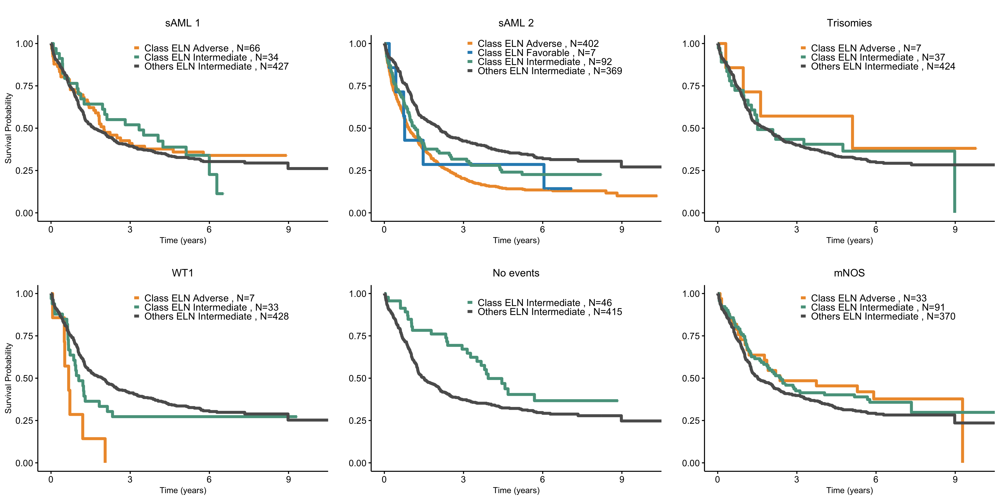

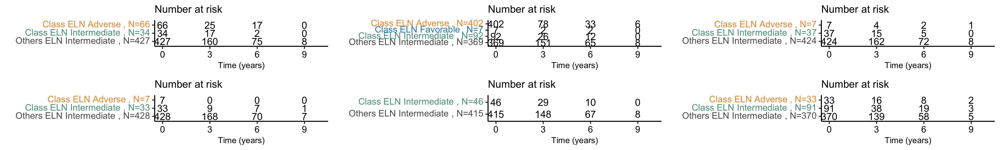

In [34]:
# Prepare colors
color_values["Class ELN Favorable"] <- "#2b8cbe"
color_values["Class ELN Intermediate"] <- "#59A08B"
color_values["Class ELN Adverse"] <- "#EE9937"
color_values["Others ELN Intermediate"] <- "#5C5C5C"

# Select classes to plot
selected_classes <- c("principal_component_sAML1","principal_component_sAML2","principal_component_Trisomies","principal_component_WT1",
             "principal_component_no_events","principal_component_mNOS")

plot_classes <- list()
risk_tab_classes <- list()

for (class in selected_classes){
    title <- ifelse(class=="principal_component_WT1","WT1",
                    ifelse(class=="principal_component_DNMT3A_IDH1_2","DNMT3A-IDH",
                           ifelse(class=="principal_component_sAML1","sAML 1",
                                  ifelse(class=="principal_component_sAML2","sAML 2",
                                      ifelse(class=="principal_component_no_events","No events",
                                             ifelse(class=="principal_component_Trisomies","Trisomies","mNOS"))))))
    
    # Class data
    df_class <-  df_final[df_final[,class]==1 | df_final$eln_2017_intermediate==1,]
    df_class$comparison <- ifelse(df_class$eln_2017_favorable==1 & df_class[,class]==1,"Class ELN Favorable",
                             ifelse(df_class$eln_2017_intermediate==1 & df_class[,class]==1,"Class ELN Intermediate",
                                    ifelse(df_class$eln_2017_adverse==1 & df_class[,class]==1,"Class ELN Adverse","Others ELN Intermediate")))
    colors_class <- unlist(unname(color_values[unique(df_class$comparison)[order(unique(df_class$comparison))]]))

    # Surv
    surv_object <- Surv(time = df_class$os, event = df_class$os_status)
    fit <- survfit(surv_object ~ comparison, data = df_class)
    surv_class <- plot_surv_curves(fit,submain="",legend=c(0.598,0.92),y=ifelse(title %in% c("sAML 1","WT1"),"Survival Probability",""),
                              vals=colors_class,pval="",xlim=c(0,10),break.x.by=3,risk.tab=T)
    
    # Surv Plot
    plot_classes[[class]] <- surv_class$plot+
                             theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
                             ggtitle(title)
    # Surv Table
    risk_tab_classes[[class]] <- surv_class$table
}

set_notebook_plot_size(40,20)
do.call("grid.arrange",c(plot_classes,ncol=3))

set_notebook_plot_size(40,6)
do.call("grid.arrange",c(risk_tab_classes,ncol=3))


# **S.Figure 19: Validation of class outcomes and molecular repartition in the AML SG Cohort (n=1,540).**

10 Years Survival Estimates : 
t(8;21) 0.42 (0.27-0.66) 
sAML1 0.16 (0.04-0.66) 
no_events 0.39 (0.27-0.57) 
Trisomies 0.51 (0.36-0.7) 
NPM1 0.41 (0.35-0.48) 
CEBPA_bi 0.69 (0.58-0.82) 
WT1 0.36 (0.2-0.65) 
mNOS 0.36 (0.29-0.46) 
sAML2 0.22 (0.16-0.3) 
inv(3) 0.09 (0.02-0.34) 
TP53_complex 0.09 (0.06-0.15) 
inv(16) 0.73 (0.62-0.85) 
DNMT3A_IDH1_2 0.47 (0.28-0.78) 
t(6;9) 0.22 (0.08-0.65) 
t(11) 0.22 (0.12-0.38) 
t(15;17) 0.73 (0.63-0.85) 
ELN Favorable 0.54 (0.49-0.59) 
ELN Adverse 0.19 (0.14-0.27) 
ELN Intermediate 0.32 (0.28-0.38) 


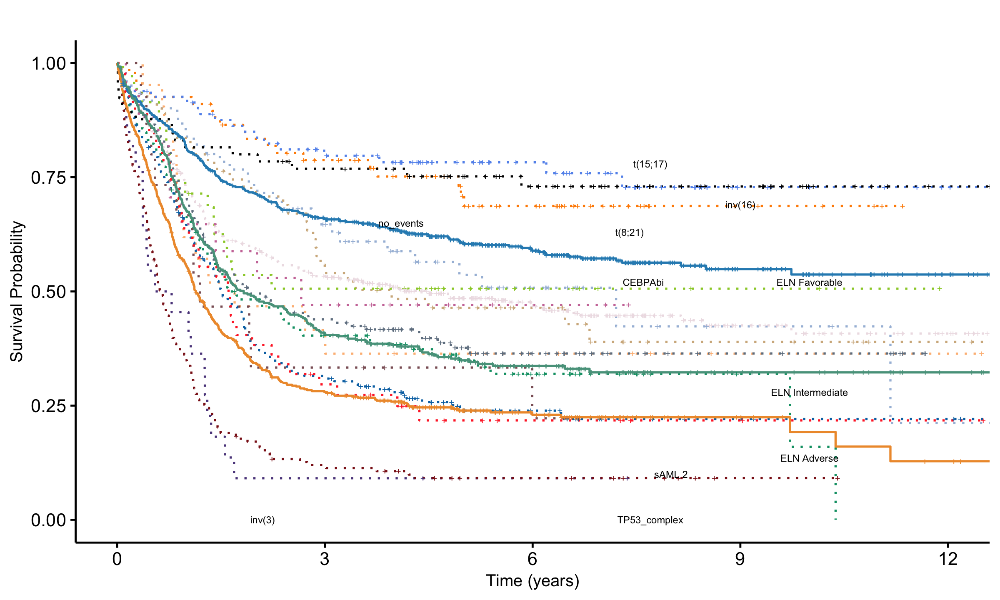

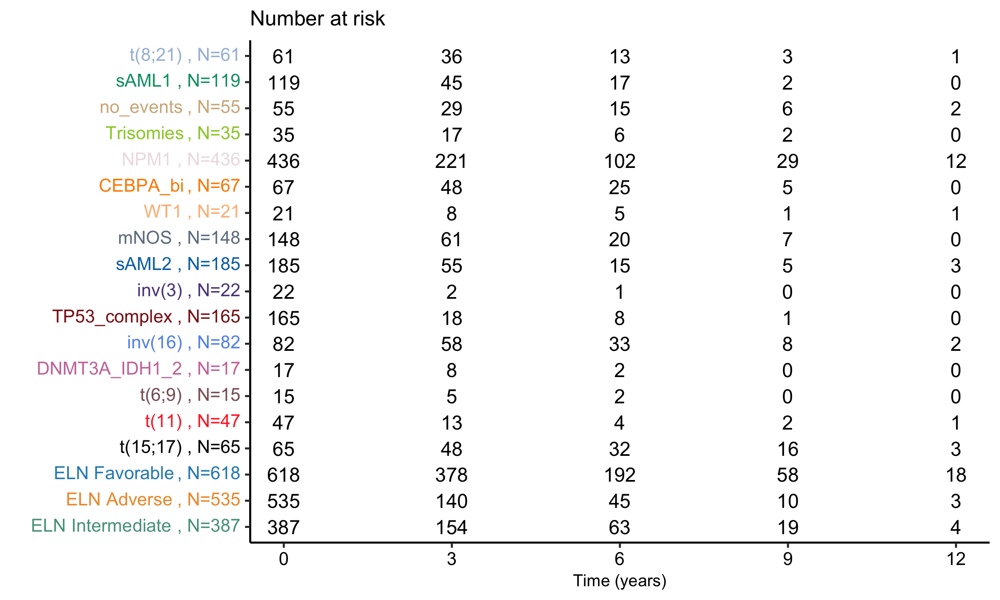

In [35]:
# Classes validation data
df_classes <- df_validation
df_classes$comparison <- str_remove(df_classes$princ_comp,"principal_component_")
df_classes$comparison <- ifelse(df_classes$comparison=="t_11","t(11)",
                               ifelse(df_classes$comparison=="inv_3","inv(3)",
                                     ifelse(df_classes$comparison=="t_8_21","t(8;21)",
                                           ifelse(df_classes$comparison=="inv_16","inv(16)",
                                                 ifelse(df_classes$comparison=="t_6_9","t(6;9)",
                                                       ifelse(df_classes$comparison=="t_15_17","t(15;17)",df_classes$comparison))))))

# ELN data
df_ELN <- df_validation
df_ELN$comparison <- ifelse(df_ELN$eln_2017=="adverse","ELN Adverse",
                          ifelse(df_ELN$eln_2017=="intermediate","ELN Intermediate","ELN Favorable"))

# Combined data                        
df_all <- rbind(df_classes,df_ELN)
df_all$comparison <- factor(df_all$comparison,levels=unique(df_all$comparison))

# Surv data
surv_object <- Surv(time = df_all$OS, event = df_all$OS_Status)
fit <- survfit(surv_object ~ comparison, data = df_all)
surv_data <- plot_surv_curves(fit,submain = "",vals=unlist(unname(color_values[levels(df_all$comparison)])),
                              linetype=c(rep(3,16),1,1,1),size=1.5,y="Survival Probability",legend="none",risk.tab=T,pval="",
                              xlim=c(0,12),break.x.by=3)

# 10 Years Survival Estimates :
cat("10 Years Survival Estimates :","\n")
for  (i in 1:length(unique(df_all$comparison))){
    cat(levels(df_all$comparison)[i],paste(round(summary(fit,t=10,extend=TRUE)$surv,2)[i]," (",sep="",
        round(summary(fit,t=10,extend=TRUE)$lower,2)[i],"-",
        round(summary(fit,t=10,extend=TRUE)$upper,2)[i],")"), "\n")
}

# Surv Plot
set_notebook_plot_size(20,12)
surv_data_plot <- surv_data$plot+
                  theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
                  ggplot2::annotate("text", 
                                x = c(2.1,7.7,8,10,10,10,7.6,7.4,9,7.7,4.1), y = c(0,0,0.1,0.135,0.28,0.52,0.52,0.63,0.69,0.78,0.65),
                                label = c("inv(3)","TP53_complex","sAML 2","ELN Adverse","ELN Intermediate",
                                          "ELN Favorable","CEBPAbi","t(8;21)","inv(16)","t(15;17)","no_events"), size = 5)
surv_data_plot

# Surv Table
set_notebook_plot_size(20,12)
surv_data$table


# **S.Figure 20: Kaplan-Meier curves for overall survival and associated risk tables comparing**
A. AML class sAML2 to ELN2017 adverse risk group in AML NCRI cohort on the subset of intensively treated patients (n=1,755). B. AML class TP53-
complex to ELN2017 adverse risk group in AML NCRI cohort on the subset of intensively treated patients (n=1,755). C. AML class sAML2 to ELN2017
adverse risk group in AML NCRI cohort on the subset of non-intensively treated patients (n=358). D. AML class TP53-complex to ELN2017 adverse risk
group in AML NCRI cohort on the subset of non-intensively treated patients (n=358). 

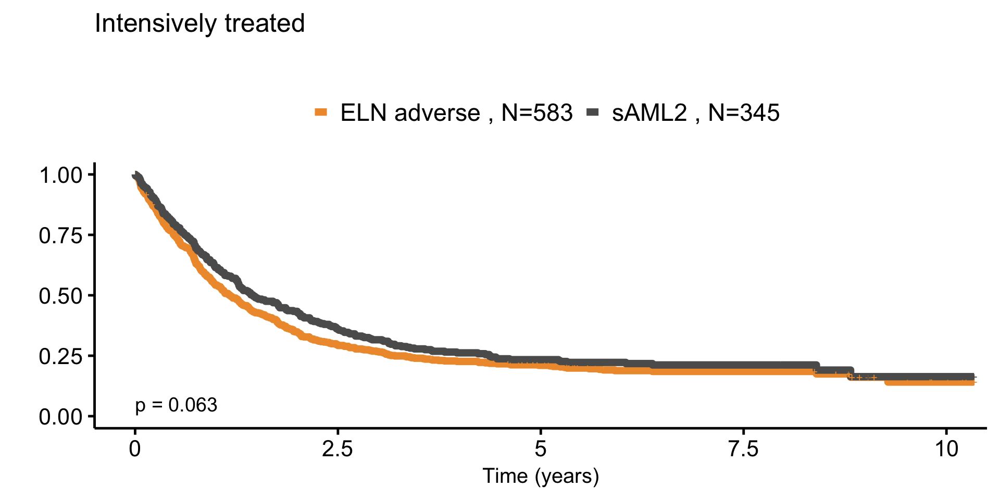

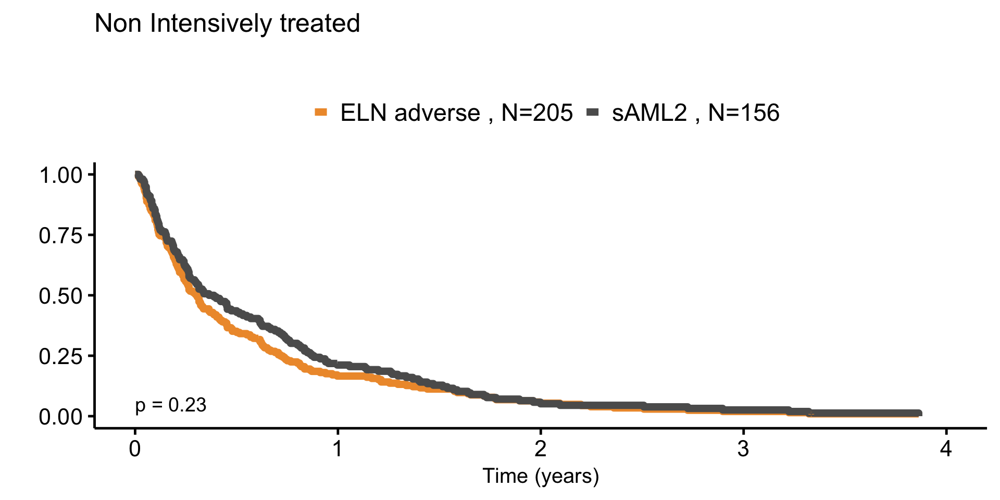

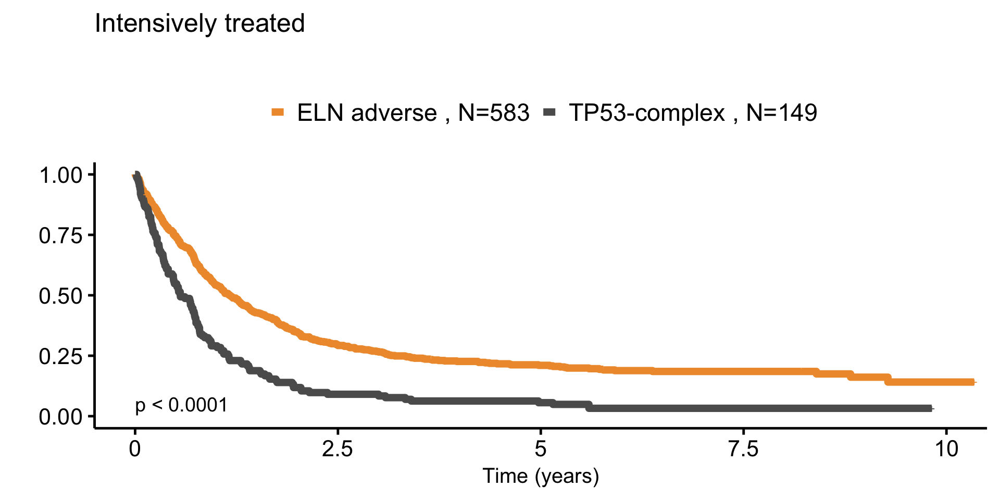

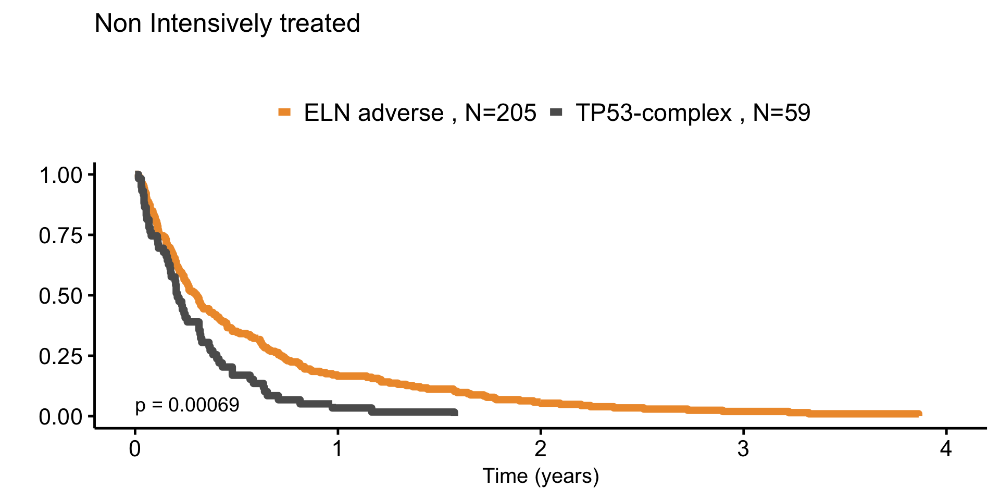

In [36]:
list_intensively_treated <- readRDS("data/list_intensively_treated.rds")

df_adv <- df_final[rownames(df_final) %in% list_intensively_treated & df_final$eln_2017_adverse==1,]
df_adv$comparison <- "ELN adverse"
df_sAML2 <- df_final[rownames(df_final) %in% list_intensively_treated & df_final$principal_component_sAML2==1,]
df_sAML2$comparison <- "sAML2"
df_both <- rbind(df_adv,df_sAML2)

# Surv
surv_object <- Surv(time = df_both$os, event = df_both$os_status)
fit <- survfit(surv_object ~ comparison, data = df_both)
surv <- plot_surv_curves(fit)
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_both)
# # Surv Plot
set_notebook_plot_size(16,8)
plot_surv_curves(fit,risk.tab=T,title="Intensively treated")$plot


df_adv <- df_final[!rownames(df_final) %in% list_intensively_treated & df_final$eln_2017_adverse==1,]
df_adv$comparison <- "ELN adverse"
df_sAML2 <- df_final[!rownames(df_final) %in% list_intensively_treated & df_final$principal_component_sAML2==1,]
df_sAML2$comparison <- "sAML2"
df_both <- rbind(df_adv,df_sAML2)

# Surv
surv_object <- Surv(time = df_both$os, event = df_both$os_status)
fit <- survfit(surv_object ~ comparison, data = df_both)
surv <- plot_surv_curves(fit)
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_both)
# # Surv Plot
set_notebook_plot_size(16,8)
plot_surv_curves(fit,risk.tab=T,title="Non Intensively treated")$plot





list_intensively_treated <- readRDS("data/list_intensively_treated.rds")

df_adv <- df_final[rownames(df_final) %in% list_intensively_treated & df_final$eln_2017_adverse==1,]
df_adv$comparison <- "ELN adverse"
df_TP53 <- df_final[rownames(df_final) %in% list_intensively_treated & df_final$principal_component_TP53_complex==1,]
df_TP53$comparison <- "TP53-complex"
df_both <- rbind(df_adv,df_TP53)

# Surv
surv_object <- Surv(time = df_both$os, event = df_both$os_status)
fit <- survfit(surv_object ~ comparison, data = df_both)
surv <- plot_surv_curves(fit)
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_both)
# # Surv Plot
set_notebook_plot_size(16,8)
plot_surv_curves(fit,risk.tab=T,title="Intensively treated")$plot


df_adv <- df_final[!rownames(df_final) %in% list_intensively_treated & df_final$eln_2017_adverse==1,]
df_adv$comparison <- "ELN adverse"
df_TP53 <- df_final[!rownames(df_final) %in% list_intensively_treated & df_final$principal_component_TP53_complex==1,]
df_TP53$comparison <- "TP53-complex"
df_both <- rbind(df_adv,df_TP53)

# Surv
surv_object <- Surv(time = df_both$os, event = df_both$os_status)
fit <- survfit(surv_object ~ comparison, data = df_both)
surv <- plot_surv_curves(fit)
res <- get_pvalue_and_HR(formula=Surv(os,os_status)~comparison,data = df_both)
# # Surv Plot
set_notebook_plot_size(16,8)
plot_surv_curves(fit,risk.tab=T,title="Non Intensively treated")$plot


# **S.Figure 21: Forest Plot multivariate Cox Regression of classes and monosomal karyotype.**

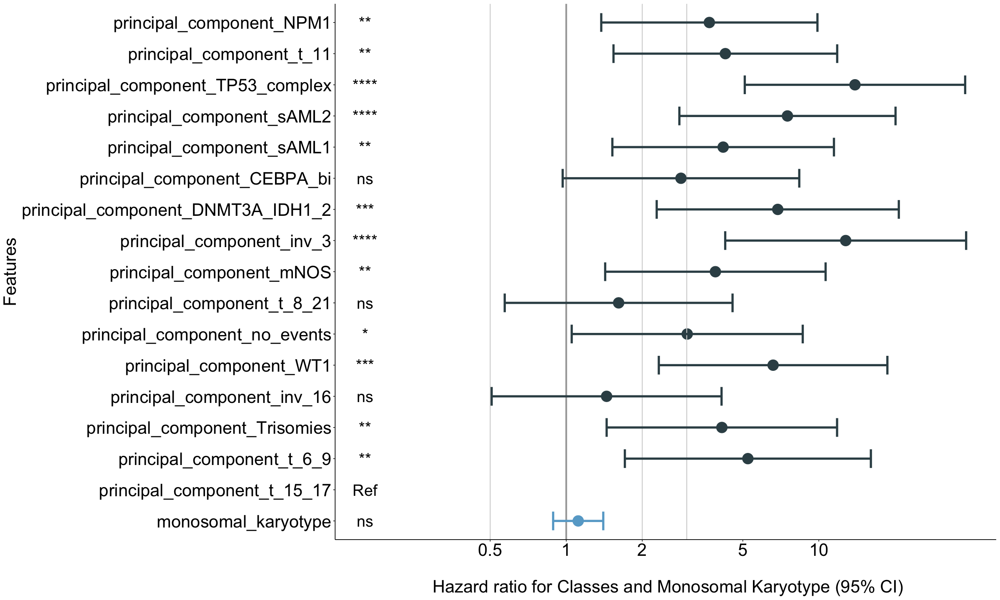

In [37]:
# Get list of patients with monosomal karyotype
list_patients_with_monosomal_karyotype <- readRDS("data/list_patients_monosomal_karyotype.rds")

# Add monosomal karyotype to variables
df_final_with_monosomal <- df_final_bis
df_final_with_monosomal$monosomal_karyotype <- ifelse(rownames(df_final_with_monosomal) %in% list_patients_with_monosomal_karyotype,1,0 )

fit <- coxph(Surv(os, os_status) ~ principal_component_NPM1+principal_component_t_11+principal_component_TP53_complex+
             principal_component_sAML2+principal_component_sAML1+principal_component_CEBPA_bi+
             principal_component_DNMT3A_IDH1_2+principal_component_inv_3+principal_component_mNOS+
             principal_component_t_8_21+principal_component_no_events+principal_component_WT1+
             principal_component_inv_16+principal_component_Trisomies+principal_component_t_6_9+principal_component_t_15_17+monosomal_karyotype, 
             data = df_final_with_monosomal)

# Forest Plot
set_notebook_plot_size(20,12)
nice_forest_plot(fit=fit,data=df_final_with_monosomal,colors=c("#67a9cf",rep("#374E55FF",16)),title="\n Hazard ratio for Classes and Monosomal Karyotype (95% CI)")

# **S.Figure 22: Estimates of the concordance index (C-index) derived from Cox regression with a RFS model.**

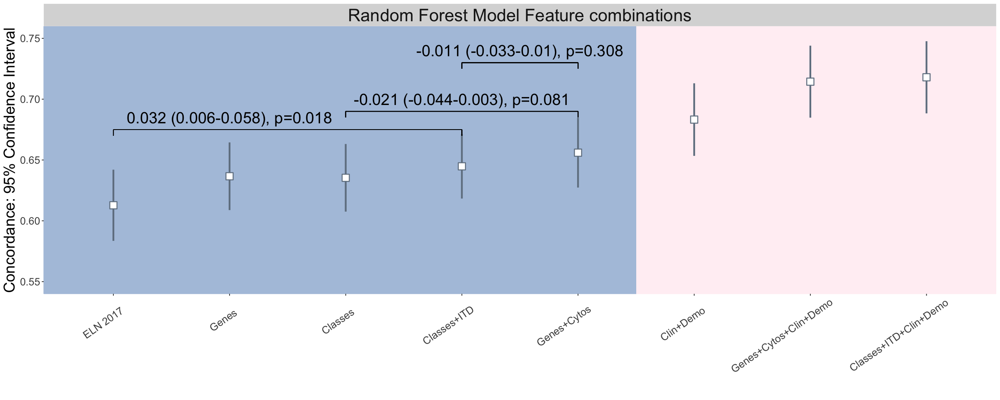

In [38]:
df_results <- read.table("data/df_results_RF.tsv")


NF <- round(0.2*nrow(df_final))
meanbs <- apply(df_results, 2, mean)
SEbs <- apply(df_results, 2, sd)
lowerbs <- meanbs-1.96*SEbs
upperbs <- meanbs+1.96*SEbs




# Pvalues & CI:
# 1. Classes+ITD vs ELN
Delta1 <- df_results[,which(colnames(df_results) =="comp_ITD")]  - df_results[,which(colnames(df_results) =="eln")]
t1 <- abs(mean(Delta1) - 0)/sd(Delta1)
PvalueDelta1 <- round(2*pt(t1, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta1 == 0) PvalueDelta1 <- "<0.001"
nam_comp_eln <- paste( round(mean(Delta1),3), " (",round(mean(Delta1) - 1.96*sd(Delta1), 3) ,"-",round(mean(Delta1) + 1.96*sd(Delta1), 3) , "), p=",PvalueDelta1, sep="")

# 2. Class vs Genes+Cytos 
Delta2  <- df_results[,which(colnames(df_results) =="comp")]  - df_results[,which(colnames(df_results) =="all_gen_cyto")]
t2 <- abs(mean(Delta2) - 0)/sd(Delta2)
PvalueDelta2 <- round(2*pt(t2, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta2 == 0) PvalueDelta2 <- "<0.001"
nam_comp_all_gen_cyto <- paste( round(mean(Delta2),3), " (",round(mean(Delta2) - 1.96*sd(Delta2), 3) ,"-",round(mean(Delta2) + 1.96*sd(Delta2), 3) , "), p=",PvalueDelta2, sep="")

# 3. Classes+ITD vs Genes+Cytos
Delta3  <- df_results[,which(colnames(df_results) =="comp_ITD")]  - df_results[,which(colnames(df_results) =="all_gen_cyto")]
t3 <- abs(mean(Delta3) - 0)/sd(Delta3)
PvalueDelta3 <- round(2*pt(t3, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta3 == 0) PvalueDelta3 <- "<0.001"
nam_comp_ITD_all_gen_cyto <- paste( round(mean(Delta3),3), " (",round(mean(Delta3) - 1.96*sd(Delta3), 3) ,"-",round(mean(Delta3) + 1.96*sd(Delta3), 3) , "), p=",PvalueDelta3, sep="")

# Prepare Comparison data
list_model <- c("ELN 2017","Genes","Classes","Classes+ITD","Genes+Cytos","Clin+Demo","Genes+Cytos+Clin+Demo","Classes+ITD+Clin+Demo")
df_comparison <- data.frame(model=list_model)
df_comparison$model <- factor(df_comparison$model,levels=list_model)
df_comparison$mean <- meanbs
df_comparison$upper <- upperbs
df_comparison$lower <- lowerbs
df_comparison$title <- "Random Forest Model Feature combinations"

# Plot
p <- ggplot(df_comparison)+
geom_rect(fill = 'lightsteelblue', xmin = 0, xmax = 5.5, ymin =0, ymax = Inf, alpha =1) +
geom_rect(fill = 'lavenderblush', xmin = 5.5, xmax = Inf, ymin =0, ymax = Inf, alpha =1) +
geom_pointrange(data=df_comparison, mapping=aes(x=model, y=mean, ymin=upper, ymax=lower),size=1.2, color="#708090", fill="white", shape=22)  +
scale_fill_manual(values=c("#708090"))+
theme(strip.text = element_text(size=25),
      axis.text.x = element_text(angle = 35,hjust = 0.8,vjust=0.8,size=15),
      axis.text.y = element_text(size = 15),
      axis.title.x = element_text(size=30),
      axis.title.y = element_text(size=22),
      legend.title = element_text(size=30),
      legend.text = element_text(size=20))+
xlab("")+
ylab("Concordance: 95% Confidence Interval")+
facet_wrap( ~ title)+ylim(c(0.55,0.75))+
annotate("text",label=c(nam_comp_eln,nam_comp_all_gen_cyto,nam_comp_ITD_all_gen_cyto),x=c(2,4,4.5),y=c(0.685,0.7,0.74),size=8)+
geom_segment(aes(x = 1, y = 0.675, xend = 4, yend = 0.675))+
geom_segment(aes(x = 1, y = 0.67, xend = 1, yend = 0.675))+
geom_segment(aes(x = 4, y = 0.67, xend = 4, yend = 0.675))+
geom_segment(aes(x = 3, y = 0.69, xend = 5, yend = 0.69))+
geom_segment(aes(x = 3, y = 0.685, xend = 3, yend = 0.69))+
geom_segment(aes(x = 5, y = 0.685, xend = 5, yend = 0.69))+
geom_segment(aes(x = 4, y = 0.73, xend = 5, yend = 0.73))+
geom_segment(aes(x = 4, y = 0.725, xend = 4, yend = 0.73))+
geom_segment(aes(x = 5, y = 0.725, xend = 5, yend = 0.73))

set_notebook_plot_size(20,8)
p

# **S.Figure 23: Feature Importance in the class based model in AML NCRI Trial (n=2,113).**

$comp


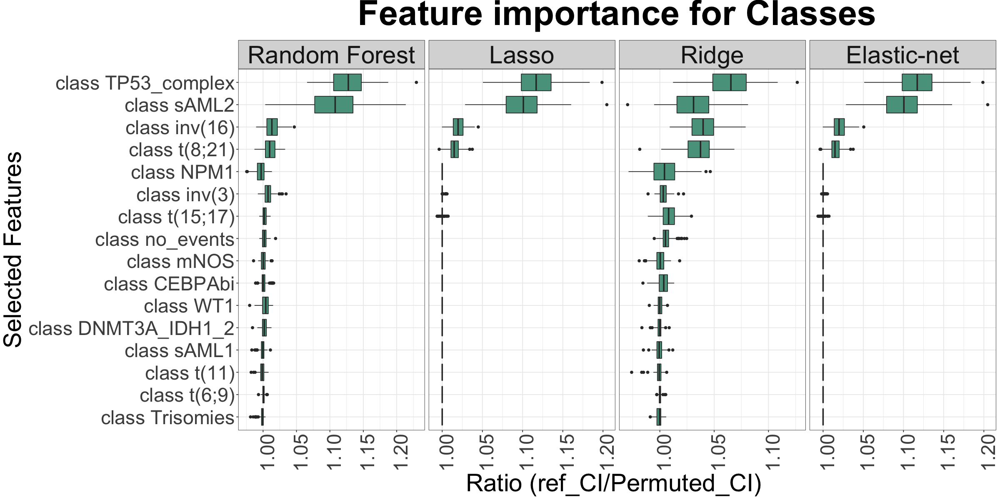

In [39]:
set_notebook_plot_size(20,10)
importances(c("comp"),top_n="all",all_algo=F,algo=c("Random Forest","Lasso","Ridge","Elastic-net"),path="data/")

# **S.Figure 24: Feature Importance in the genes based model (top 30) in AML NCRI Trial (n=2,113).**

$all_gen


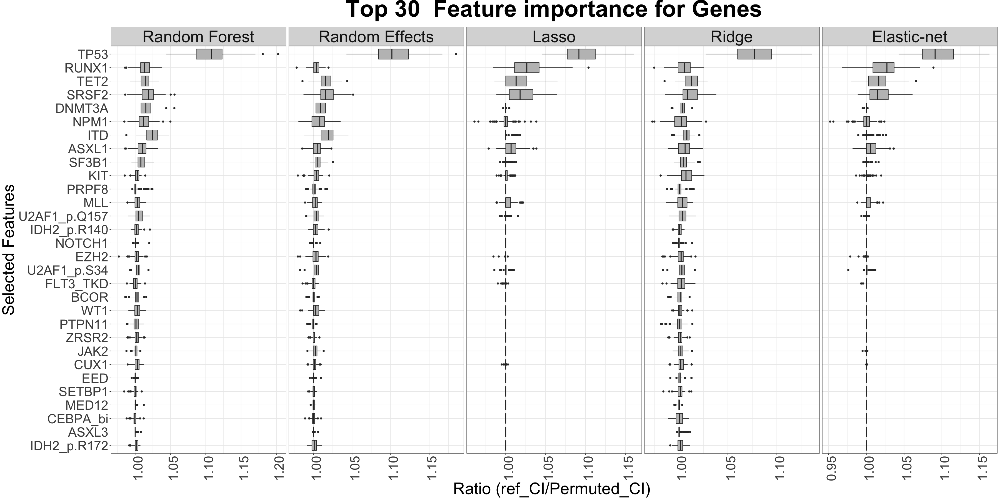

In [40]:
set_notebook_plot_size(30,15)
importances(c("all_gen"),top_n=30,path="data/")

# **S.Figure 25: Feature Importance in the class + genes + cytogenetics based model (top 30) in AML NCRI Trial (n=2,113).**

$comp_all_gen_cyto


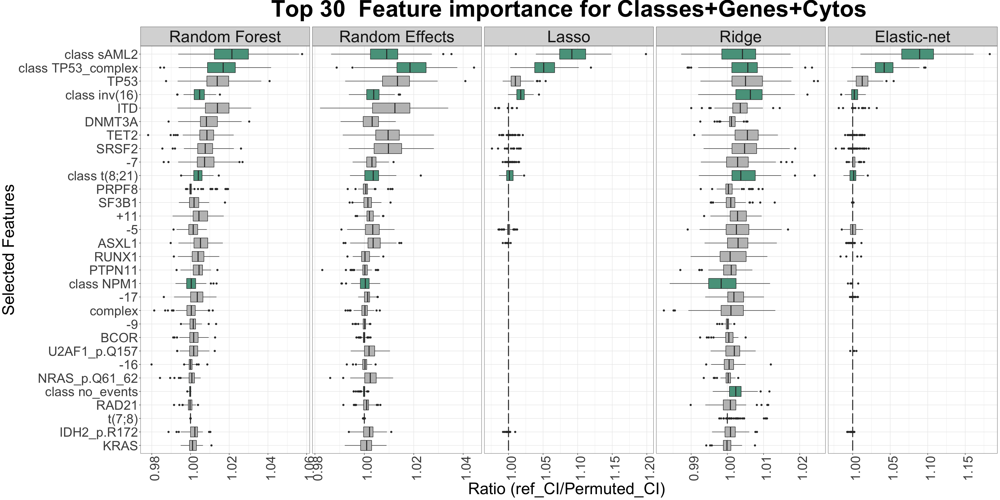

In [41]:
set_notebook_plot_size(30,15)
importances(c("comp_all_gen_cyto"),remove_spec_gen_cyto=T,top_n=30,path="data/")

# **S.Figure 26: Feature Importance in the ELN + genes + cytos based model (top 30) in AML NCRI Trial (n=2,113).**

$eln_all_gen_cyto


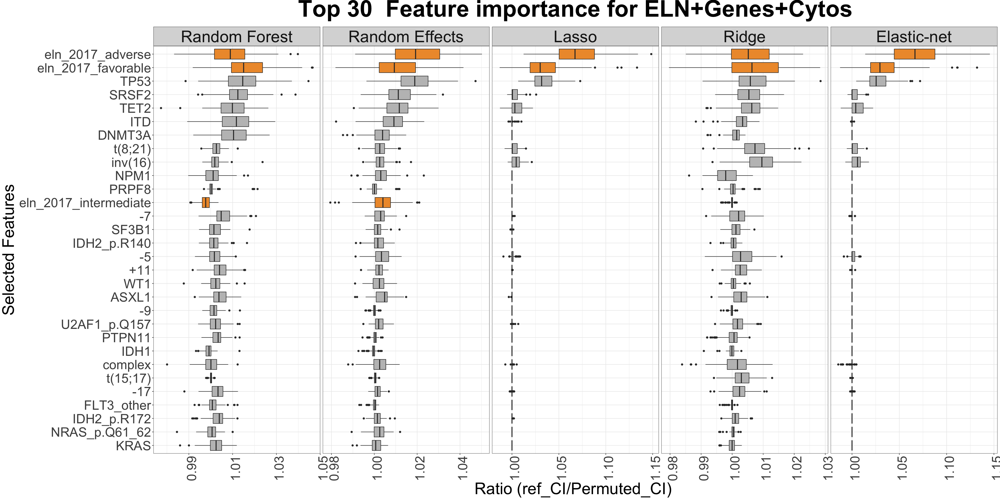

In [42]:
set_notebook_plot_size(30,15)
importances(c("eln_all_gen_cyto"),top_n=30,path="data/")

# **S.Figure 27: Feature Importance in the ELN + genes based model (top 30) in AML NCRI Trial (n=2,113).**

$eln_all_gen


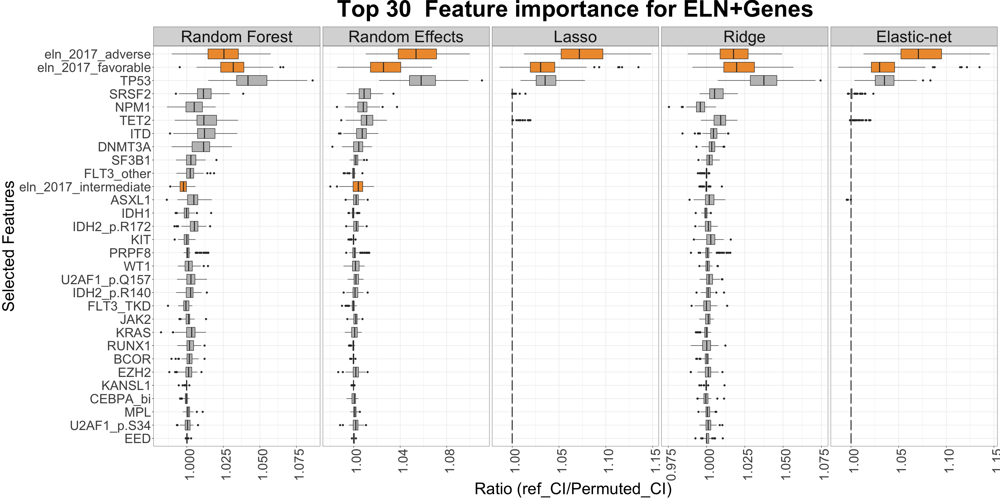

In [43]:
set_notebook_plot_size(30,15)
importances(c("eln_all_gen"),top_n=30,path="data/")

# **S.Figure 28: Feature Importance in the full Model (ELN + Genes + Cytos + Clin + Demo) in AML NCRI Trial (n=2,113).**

$eln_all_gen_cyto_clin_demo


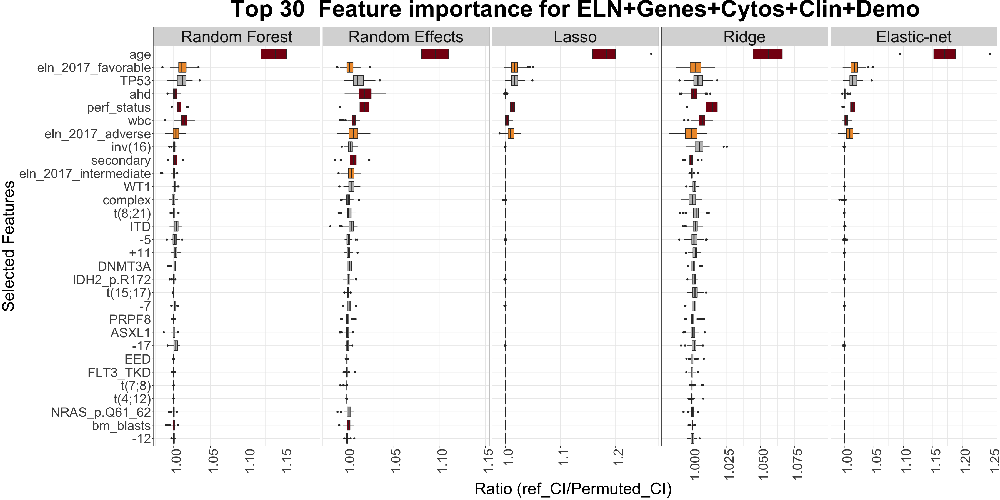

In [44]:
set_notebook_plot_size(30,15)
importances(c("eln_all_gen_cyto_clin_demo"),top_n=30,path="data/")

# **S. Figure 29: Forest plot multivariate Cox Regression of A. ELN and B. Classes.**

## **A. ELN Forest Plot.** 

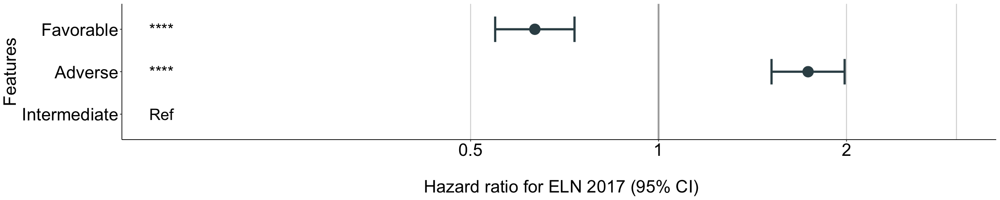

In [45]:
df_final_ELN <- df_final
df_final_ELN$Favorable <- ifelse(df_final_ELN$eln_2017_favorable==1,1,0)
df_final_ELN$Intermediate <- ifelse(df_final_ELN$eln_2017_intermediate==1,1,0)
df_final_ELN$Adverse <- ifelse(df_final_ELN$eln_2017_adverse==1,1,0)

fit <- coxph(Surv(os, os_status) ~ Favorable+Adverse+Intermediate, 
             data = df_final_ELN)

set_notebook_plot_size(20,4)
nice_forest_plot(fit=fit,data=df_final_ELN,colors=c(rep("#374E55FF",16)),title="\n Hazard ratio for ELN 2017 (95% CI)")

## **B. Classes Forest Plot.**

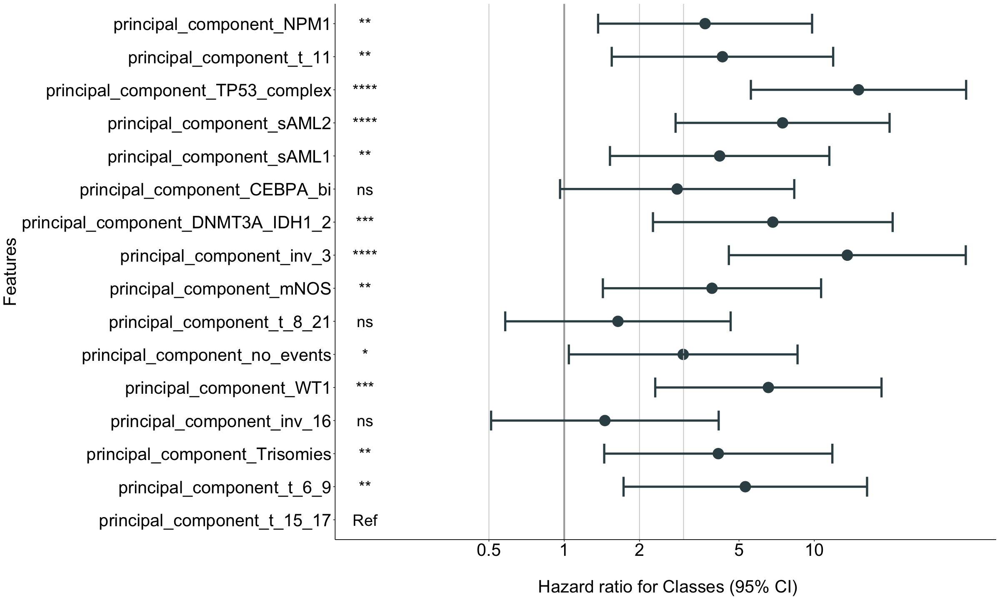

In [46]:
df_final_classes <- df_final_bis
fit <- coxph(Surv(os, os_status) ~ principal_component_NPM1+principal_component_t_11+principal_component_TP53_complex+
             principal_component_sAML2+principal_component_sAML1+principal_component_CEBPA_bi+
             principal_component_DNMT3A_IDH1_2+principal_component_inv_3+principal_component_mNOS+
             principal_component_t_8_21+principal_component_no_events+principal_component_WT1+
             principal_component_inv_16+principal_component_Trisomies+principal_component_t_6_9+principal_component_t_15_17, 
             data = df_final_classes)

set_notebook_plot_size(20,12)
nice_forest_plot(fit=fit,data=df_final_classes,colors=c(rep("#374E55FF",16)),title="\n Hazard ratio for Classes (95% CI)")

# **S.Figure 30: Explained variation and randomness using Nagelkerke‘s pseudo R2 in the AML NCRI Trial (n=2,113).**

## ***A. Explained variation and randomness using different subset of the covariates to include: ELN2017, classes, classes + ITD, genes, clinical data, genes + cytogenetics, classes + clinical data, genes + cytogenetics + clinical data.*** 

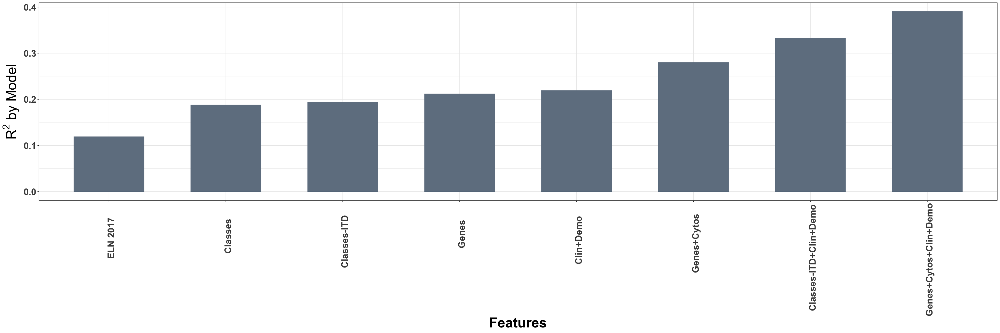

In [47]:
tmp <- df_final_bis

# Prepare data with R squared
df <- data.frame(R_squared = double(),concordance = double())

m <- coxph(as.formula(wrap_cox(eln)),tmp)
df["ELN 2017",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(genes)),tmp)
df["Genes",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(genes,cytos_bis))),tmp)
df["Genes+Cytos",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(princ_comps_bis)),tmp)
df["Classes",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(princ_comps_bis,"ITD"))),tmp)
df["Classes-ITD",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(clin,demo))),tmp)
df["Clin+Demo",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(genes,cytos_bis,clin,demo))),tmp)
df["Genes+Cytos+Clin+Demo",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(princ_comps_bis,"ITD",clin,demo))),tmp)
df["Classes-ITD+Clin+Demo",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)

df["feature"] <- rownames(df)

# Order R squared data
df <- df[order(df$R_squared,decreasing=T),]

# Plot
set_notebook_plot_size(30,10)
plot_model <- ggplot(df,aes(x=reorder(feature,R_squared),y=R_squared))+
     geom_bar(stat = "identity",color="#708090",fill="#708090",width=0.6) + 
     theme_bw()+
     theme(plot.title = element_text( size=35, face="bold",hjust=0.5),
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=20,face="bold"),axis.text.y=element_text(size=20,face="bold"),
          axis.title = element_text(size = 30,face="bold"),strip.text = element_text(size=25))+
        ylab(expression(paste(R^2," by Model")))+
        xlab("Features")


plot_model


## ***B. Explained variation and randomness for each covariate. Pseudo R2 are relative measures indicating how well a model/feature explains the data.***

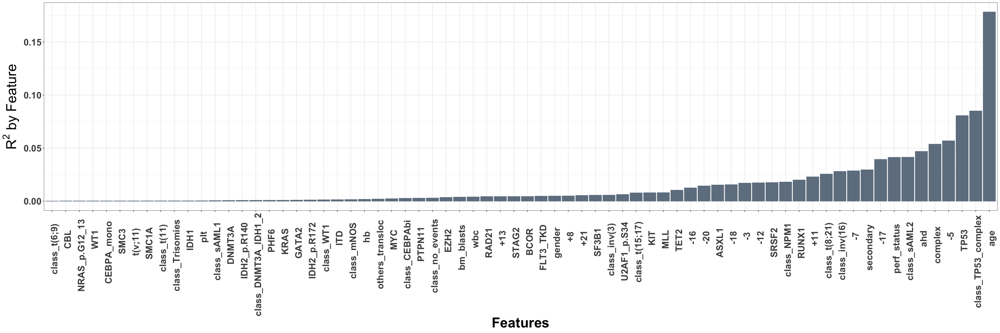

In [48]:
tmp <- df_final_bis
# Prepare data with R squared
df <- data.frame(R_squared = double(),concordance = double())

# Prepare R squared for all features
for (feature in c(princ_comps_bis,gen,cyto_bis,clin,demo)){
    m <- coxph(as.formula(paste("Surv(os, os_status) ~ ",feature,sep="")),tmp)
    df[feature,] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
}

df["feature"] <- rownames(df)

# Remove overlap with classes and genes,cytos
df <- df[!df$feature %in% c("NPM1","inv_16","CEBPA_bi","t_8_21","inv_16","t_15_17","t_6_9"),]

# Prepare feature data
df$feature <- str_replace(df$feature,"principal_component_","class_")
df$feature <- ifelse(df$feature=="class_t_15_17","class_t(15;17)",
              ifelse(df$feature=="class_inv_16","class_inv(16)",
              ifelse(df$feature=="class_t_8_21","class_t(8;21)",
              ifelse(df$feature=="class_t_11","class_t(11)",
              ifelse(df$feature=="class_t_6_9","class_t(6;9)",
              ifelse(df$feature=="class_inv_3","class_inv(3)",
              ifelse(df$feature=="class_CEBPA_bi","class_CEBPAbi",df$feature)))))))
df$feature <- ifelse(grepl("^add",df$feature),str_replace(df$feature,"add_","+"),
                          ifelse(grepl("^del",df$feature),str_replace(df$feature,"del_","-"),
                                ifelse(grepl("minusy",df$feature),str_replace(df$feature,"minusy","-Y"),
                                      ifelse(grepl("^t_",df$feature),paste(str_replace(str_replace(df$feature,"t_","t("),"_",";"),")",sep=""),
                                          ifelse(grepl("^inv_",df$feature),paste(str_replace(df$feature,"inv_","inv("),")",sep="")
                                                 ,df$feature)))))

# Order R squared data
df <- df[order(df$R_squared,decreasing=T),]
# Display Top N
top_N <- 70
df <- df[1:top_N,]

# Plot
set_notebook_plot_size(30,10)
plot_features <- ggplot(df,aes(x=reorder(feature,R_squared),y=R_squared))+
                 geom_bar(stat = "identity",color="#708090",fill="#708090")+
                 theme_bw()+
                 theme(plot.title = element_text( size=35, face="bold",hjust=0.5),
                 axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=20,face="bold"),axis.text.y=element_text(size=20,face="bold"),
                 axis.title = element_text(size = 30,face="bold"),strip.text = element_text(size=25))+
                 ylab(expression(paste(R^2," by Feature")))+
                 xlab("Features")
plot_features


# **S.Figure 31: Prognosis Evolution Validation of C-Index in the AML SG Cohort (1,540 patients).**

## ***A. Bar plots of number of features for the different models that were evaluated.***

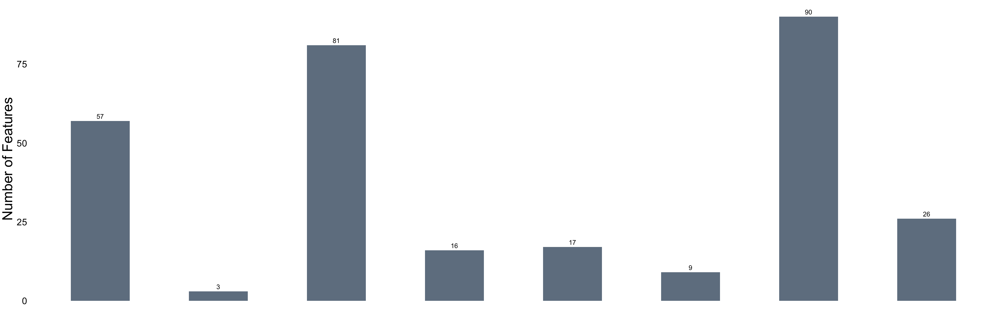

In [49]:
# Create features dataset
df_features <- data.frame(matrix(ncol = 2, nrow = 8))
colnames(df_features) <- c("Feature Type","Count")
df_features[,"Feature_Type"] <- c("Genes","ELN 2017","Genes+Cytos","Classes","Classes+ITD","Clin+Demo","Genes+Cytos+Clin+Demo","Classes+ITD+Clin+Demo")
df_features[,"Feature_Type"] <- factor(df_features[,"Feature_Type"],levels=df_features[,"Feature_Type"])
df_features$Count <- c(length(genes_val),length(eln),length(c(genes_val,cytos_val)),length(princ_comps),length(c(princ_comps,"ITD")),length(c(clin_val,demo_val)),
                       length(c(genes_val,cytos_val,clin_val,demo_val)),length(c(princ_comps,"ITD",clin_val,demo_val)))

# Plot
plot_num_features <- ggplot(df_features,aes(x=Feature_Type,y=Count))+
    geom_bar(stat="identity",fill="#708090",width=0.5)+
    theme_bw()+
    theme(panel.border = element_rect(colour = "white", fill=NA, size=2))+
    ylab("Number of Features")+
    xlab("")+
    geom_text(aes(label=Count), vjust=-0.5,size=5) +
    theme(legend.position= "none",
          plot.title = element_text(hjust = 0.5,size=25),
          axis.text=element_blank(),
          axis.ticks=element_blank(),
          axis.text.y=element_text(size=20),
          axis.title=element_text(size=30),
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank(),
          panel.background = element_blank())

plot_num_features

## ***B. Concordance Index (C-Index) measured using a Cox Ridge model on different subsets of the features.***

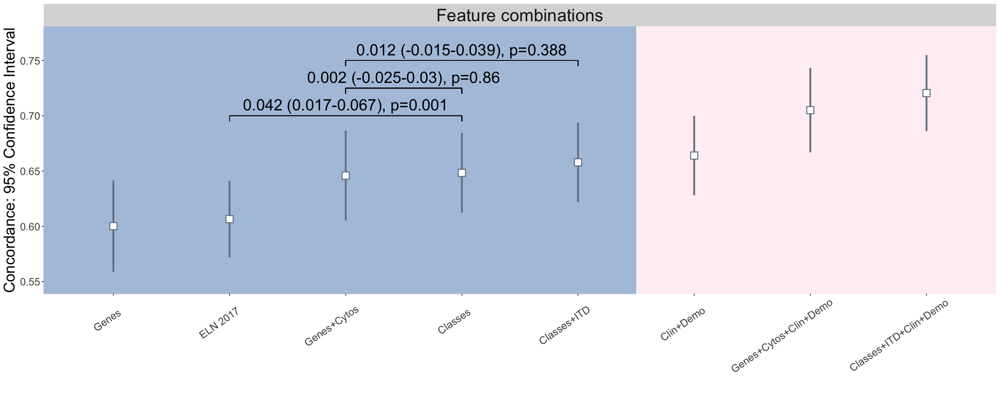

In [50]:
# Results data
df_results <- read.table("data/bootstrap_results_NEJM_Cohort.tsv")
NF <- round(0.25*nrow(df_validation))
meanbs <- apply(df_results, 2, mean)
SEbs <- apply(df_results, 2, sd)
lowerbs <- meanbs-1.96*SEbs
upperbs <- meanbs+1.96*SEbs

# Pvalues :
# 1. Class vs ELN
Delta1 <- df_results[,which(colnames(df_results) =="comp")]  - df_results[,which(colnames(df_results) =="eln")]
t1 <- abs(mean(Delta1) - 0)/sd(Delta1)
PvalueDelta1 <- round(2*pt(t1, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta1 == 0){
    PvalueDelta1 <- "p<0.001"
}else{
    PvalueDelta1 <- paste0("p=",PvalueDelta1)
}
nam_comp_eln <- paste( round(mean(Delta1),3), " (",round(mean(Delta1) - 1.96*sd(Delta1), 3) ,"-",round(mean(Delta1) + 1.96*sd(Delta1), 3) , "), ",PvalueDelta1, sep="")

# 2. Class vs Genes+Cytos
Delta2  <- df_results[,which(colnames(df_results) =="comp")]  - df_results[,which(colnames(df_results) =="all_gen_cyto")]
t2 <- abs(mean(Delta2) - 0)/sd(Delta2)
PvalueDelta2 <- round(2*pt(t2, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta2 == 0){
    PvalueDelta2 <- "p<0.001"
}else{
    PvalueDelta2 <- paste0("p=",PvalueDelta2)
}
nam_comp_all_gen_cyto <- paste( round(mean(Delta2),3), " (",round(mean(Delta2) - 1.96*sd(Delta2), 3) ,"-",round(mean(Delta2) + 1.96*sd(Delta2), 3) , "), ",PvalueDelta2, sep="")

#3. Class+ITD vs Genes+Cytos
Delta3  <- df_results[,which(colnames(df_results) =="comp_ITD")]  - df_results[,which(colnames(df_results) =="all_gen_cyto")]
t3 <- abs(mean(Delta3) - 0)/sd(Delta3)
PvalueDelta3 <- round(2*pt(t3, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta3 == 0){
    PvalueDelta3 <- "p<0.001"
}else{
    PvalueDelta3 <- paste0("p=",PvalueDelta3)
}
nam_comp_ITD_all_gen_cyto <- paste( round(mean(Delta3),3), " (",round(mean(Delta3) - 1.96*sd(Delta3), 3) ,"-",round(mean(Delta3) + 1.96*sd(Delta3), 3) , "), ",PvalueDelta3, sep="")

# Comparison data
list_model <- c("ELN 2017","Genes","Classes","Classes+ITD","Genes+Cytos","Clin+Demo","Genes+Cytos+Clin+Demo","Classes+ITD+Clin+Demo")
df_comparison <- data.frame(model=list_model)
df_comparison$model <- factor(df_comparison$model,levels=list_model)
df_comparison$mean <- meanbs
df_comparison$upper <- upperbs
df_comparison$lower <- lowerbs
df_comparison$title <- "Feature combinations"

# Plot
plot_comparison <- ggplot(df_comparison,aes(x=reorder(model,mean), y=mean, ymin=upper, ymax=lower))  + 
geom_rect(fill = 'lightsteelblue', xmin = 0, xmax = 5.5, ymin =0, ymax = Inf, alpha =1) +
geom_rect(fill = 'lavenderblush', xmin = 5.5, xmax = Inf, ymin =0, ymax = Inf, alpha =1) +
geom_pointrange(data=df_comparison, mapping=aes(x=model, y=mean, ymin=upper, ymax=lower), size=1.2, color="#708090", fill="white", shape=22)  +
scale_fill_manual(values=c("#708090"))+
theme(strip.text = element_text(size=25),
      axis.text.x = element_text(angle = 35,
      hjust = 0.8,
      vjust=0.8,
      size=15),
      axis.text.y = element_text(size = 15),
      axis.title.x=element_text(size=30),
      axis.title.y=element_text(size=22),
      legend.title=element_text(size=30),
      legend.text=element_text(size=20)) +
xlab("") + 
ylab("Concordance: 95% Confidence Interval") +
facet_wrap( ~ title) + 
ylim(c(0.55,0.77)) +
annotate("text",label=c(nam_comp_eln,nam_comp_all_gen_cyto,nam_comp_ITD_all_gen_cyto),x=c(3,3.5,4),y=c(0.71,0.735,0.76),size=8) +
geom_segment(aes(x = 2, y = 0.7, xend = 4, yend = 0.7)) +
geom_segment(aes(x = 2, y = 0.695, xend = 2, yend = 0.7)) +
geom_segment(aes(x = 4, y = 0.695, xend = 4, yend = 0.7)) +
geom_segment(aes(x = 3, y = 0.725, xend = 4, yend = 0.725)) +
geom_segment(aes(x = 3, y = 0.72, xend = 3, yend = 0.725)) +
geom_segment(aes(x = 4, y = 0.72, xend = 4, yend = 0.725)) +
geom_segment(aes(x = 3, y = 0.75, xend = 5, yend = 0.75)) +
geom_segment(aes(x = 3, y = 0.745, xend = 3, yend = 0.75))  +
geom_segment(aes(x = 5, y = 0.745, xend = 5, yend = 0.75))

set_notebook_plot_size(20,8)
plot_comparison

# **S.Figure 32: Explained variation and randomness using Nagelkerke R2 in the validation AML SG cohort (n=1,540).**

## ***A. Explained variation and randomness using different subset of the covariates.***

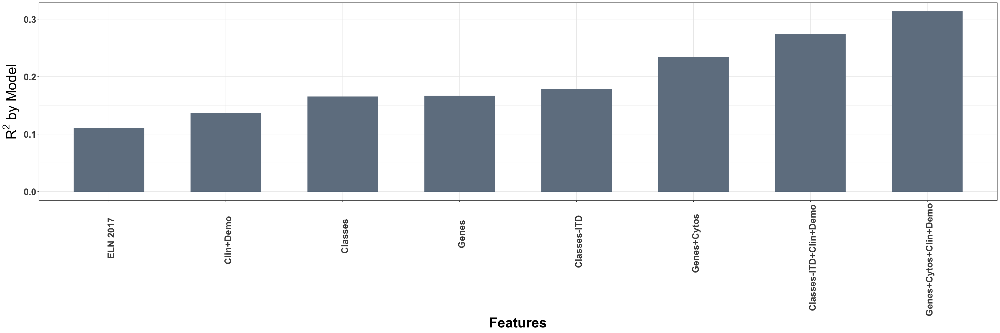

In [51]:
tmp <- df_validation_bis
tmp[,c("os","os_status")] <- tmp[,c("OS","OS_Status")]

# Prepare data with R squared
df <- data.frame(R_squared = double(),concordance = double())

m <- coxph(as.formula(wrap_cox(eln)),tmp)
df["ELN 2017",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(genes_val)),tmp)
df["Genes",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(genes_val,cytos_val_bis))),tmp)
df["Genes+Cytos",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(princ_comps_bis)),tmp)
df["Classes",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(princ_comps_bis,"ITD"))),tmp)
df["Classes-ITD",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(clin_val,demo_val))),tmp)
df["Clin+Demo",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(genes_val,cytos_val_bis,clin_val,demo_val))),tmp)
df["Genes+Cytos+Clin+Demo",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
m <- coxph(as.formula(wrap_cox(c(princ_comps_bis,"ITD",clin_val,demo_val))),tmp)
df["Classes-ITD+Clin+Demo",] <- c(summary(m)$rsq[[1]],summary(m)$concordance)

df["feature"] <- rownames(df)

# Order R squared data
df <- df[order(df$R_squared,decreasing=T),]

plot_model <- ggplot(df,aes(x=reorder(feature,R_squared),y=R_squared))+geom_bar(stat = "identity",color="#708090",fill="#708090",width=0.6) + theme_bw()+
                theme(plot.title = element_text( size=35, face="bold",hjust=0.5),
          axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=20,face="bold"),axis.text.y=element_text(size=20,face="bold"),
          axis.title = element_text(size = 30,face="bold"),strip.text = element_text(size=25))+
        ylab(expression(paste(R^2," by Model"))) + xlab("Features")

set_notebook_plot_size(30,10)
plot_model

## ***B. Explained variation and randomness for each covariate.***

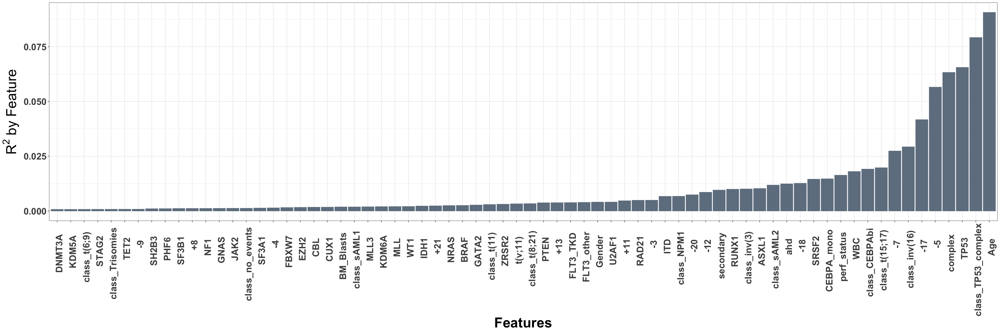

In [52]:
tmp <- df_validation_bis

# Prepare data with R squared
df <- data.frame(R_squared = double(),concordance = double())

# Prepare R squared for all features
for (g in c(princ_comps_bis,genes_val,cytos_val_bis,clin_val,demo_val)){
    m <- coxph(as.formula(paste("Surv(OS, OS_Status) ~ ",g,sep="")),tmp)
    df[g,] <- c(summary(m)$rsq[[1]],summary(m)$concordance)
}
df["feature"] <- rownames(df)

# Remove overlap with classes and genes,cytos
df <- df[!df$feature %in% c("NPM1","inv_16","CEBPA_bi","t_8_21","inv_3","t_15_17","t_6_9"),]

# Prepare feature data
df$feature <- str_replace(df$feature,"principal_component_","class_")
df$feature <- ifelse(df$feature=="class_t_15_17","class_t(15;17)",
              ifelse(df$feature=="class_inv_16","class_inv(16)",
              ifelse(df$feature=="class_t_8_21","class_t(8;21)",
              ifelse(df$feature=="class_t_11","class_t(11)",
              ifelse(df$feature=="class_t_6_9","class_t(6;9)",
              ifelse(df$feature=="class_inv_3","class_inv(3)",
              ifelse(df$feature=="class_CEBPA_bi","class_CEBPAbi",df$feature)))))))

df$feature <- ifelse(grepl("^add",df$feature),str_replace(df$feature,"add_","+"),
                          ifelse(grepl("^del",df$feature),str_replace(df$feature,"del_","-"),
                                ifelse(grepl("minusy",df$feature),str_replace(df$feature,"minusy","-Y"),
                                      ifelse(grepl("^t_",df$feature),paste(str_replace(str_replace(df$feature,"t_","t("),"_",";"),")",sep=""),
                                          ifelse(grepl("^inv_",df$feature),paste(str_replace(df$feature,"inv_","inv("),")",sep="")
                                                 ,df$feature)))))

# Order R squared data
df <- df[order(df$R_squared,decreasing=T),]
# Display Top N
top_N <- 70
df <- df[1:top_N,]

# Plot
plot_features <- ggplot(df,aes(x=reorder(feature,R_squared),y=R_squared))+
                 geom_bar(stat = "identity",color="#708090",fill="#708090")+
                 theme_bw()+
                 theme(plot.title = element_text( size=35, face="bold",hjust=0.5),
                 axis.text.x = element_text(angle = 90, hjust = 0.8,vjust=0.8,size=20,face="bold"),axis.text.y=element_text(size=20,face="bold"),
                 axis.title = element_text(size = 30,face="bold"),strip.text = element_text(size=25))+
                 ylab(expression(paste(R^2," by Feature")))+
                 xlab("Features")

set_notebook_plot_size(30,10)
plot_features

# **S.Figure 33: Multi-state model for disease progression in the AML NCRI cohort (n=2,017).**

## ***A. Representation of patient transitions (in numbers) across clinical endpoints.***

## ***B. Non-parametric multi-state transition probability with 95% confidence bands for the AML NCRI cohort.***

[1] 2017

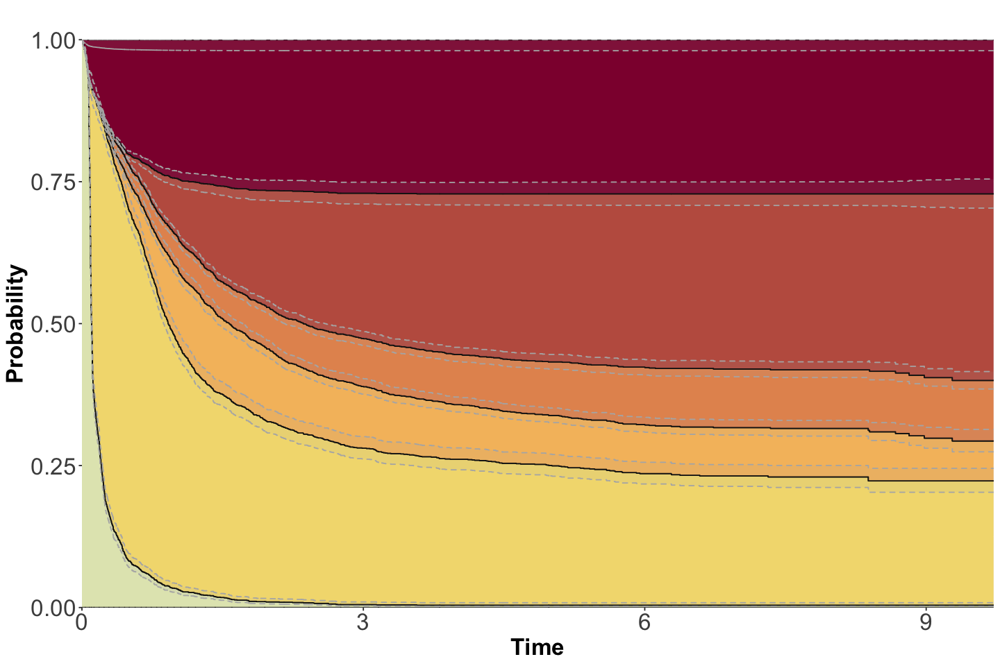

In [53]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time Point Data
data <- read.table("data/df_TRAINING_personalization_updated.tsv")[,c("patient_id","CR","Relapse",
                                                         "Death_in_CR","Death_in_Relapse",
                                                         "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                                                         "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis)]
              
nrow(data)
# Transition matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data
msdata <- msprep(data = data, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis))

# Transition Probability 
c0_data <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = msdata,method="breslow")
msf0_data <- msfit(object = c0_data,newdata=msdata,trans=tmat_data)
pt0_data <- probtrans(msf0_data, predt = 0, method = "greenwood",direction = "fo")

# Multistate plot
set_notebook_plot_size(12,8)
plot_probtrans_Conf_Interval(pt0_data,statecols,ord,xlim=c(0,10))      


## ***C. Stacked transition probabilities with 95% confidence bands for each class across time.***

[1] 2017

[1] TRUE

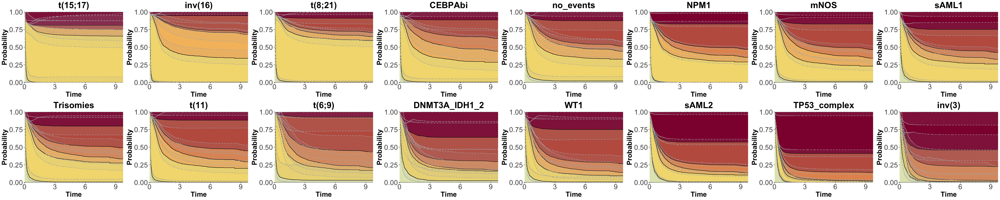

In [54]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time Point Data
data <- read.table("data/df_TRAINING_personalization_updated.tsv")[,c("patient_id","CR","Relapse",
                                                         "Death_in_CR","Death_in_Relapse",
                                                         "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                                                         "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis)]
              
nrow(data)
# Transition matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data
msdata <- msprep(data = data, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis))

# With classes
msdata_with_comp <- expand.covs(msdata, princ_comps_bis, longnames = FALSE)

# Cox Model with classes
expanded_princ_component <- colnames(msdata_with_comp)[grepl("principal_component_",colnames(msdata_with_comp)) & grepl("\\.",colnames(msdata_with_comp))]
form <- paste("Surv(Tstart, Tstop, status) ~ " , expanded_princ_component[1] , sep="")
for (co in expanded_princ_component[2:(length(expanded_princ_component))]){
    form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
cfull <- coxph(as.formula(form), data = msdata_with_comp, method = "breslow")

comp_ordered <- c("principal_component_t_15_17","principal_component_inv_16","principal_component_t_8_21","principal_component_CEBPA_bi","principal_component_no_events","principal_component_NPM1",
                  "principal_component_mNOS","principal_component_sAML1","principal_component_Trisomies","principal_component_t_11","principal_component_t_6_9","principal_component_DNMT3A_IDH1_2",
                  "principal_component_WT1","principal_component_sAML2","principal_component_TP53_complex","principal_component_inv_3")

# Plots class by class
plots_conf_int <- list()
for (co in comp_ordered){

    whA <- which(msdata_with_comp[,co]==1)
    patA <-  msdata_with_comp[rep(whA[1], each=5), c(princ_comps_bis)]
    patA$trans <- 1:5
    attr(patA, "trans") <- tmat_data
    patA <- expand.covs(patA, c(princ_comps_bis), longnames = FALSE)
    patA$strata <- patA$trans
    msfA <- msfit(cfull, patA, trans = tmat_data)
    main <- str_remove(co,"principal_component_")
    main <- ifelse(main=="t_15_17","t(15;17)",
                  ifelse(main=="inv_16","inv(16)",
                        ifelse(main=="t_8_21","t(8;21)",
                              ifelse(main=="t_11","t(11)",
                                     ifelse(main=="t_6_9","t(6;9)",
                                         ifelse(main=="inv_3","inv(3)",
                                                ifelse(main=="CEBPA_bi","CEBPAbi",  main)))))))
    ptA <- probtrans(msfA, predt = 0,variance=T)
    plots_conf_int[[co]] <- plot_probtrans_Conf_Interval(ptA,statecols,ord,xlim=c(0,10),main=main)
    }

# Plots
set_notebook_plot_size(40,8)
do.call("grid.arrange",c(plots_conf_int,nrow=2))
is_one_to_one_mapping(msdata_with_comp)


# **S.Figure 34: Multi-state model for disease progression for patients that received intensive treatment (n=1,661).**

## ***A. Representation of patient transitions (in numbers) across clinical endpoints.***

## ***B. Non-parametric multi-state transition probability with 95% confidence bands for the AML NCRI cohort for patients that received intensive treatment.***

[1] 1661

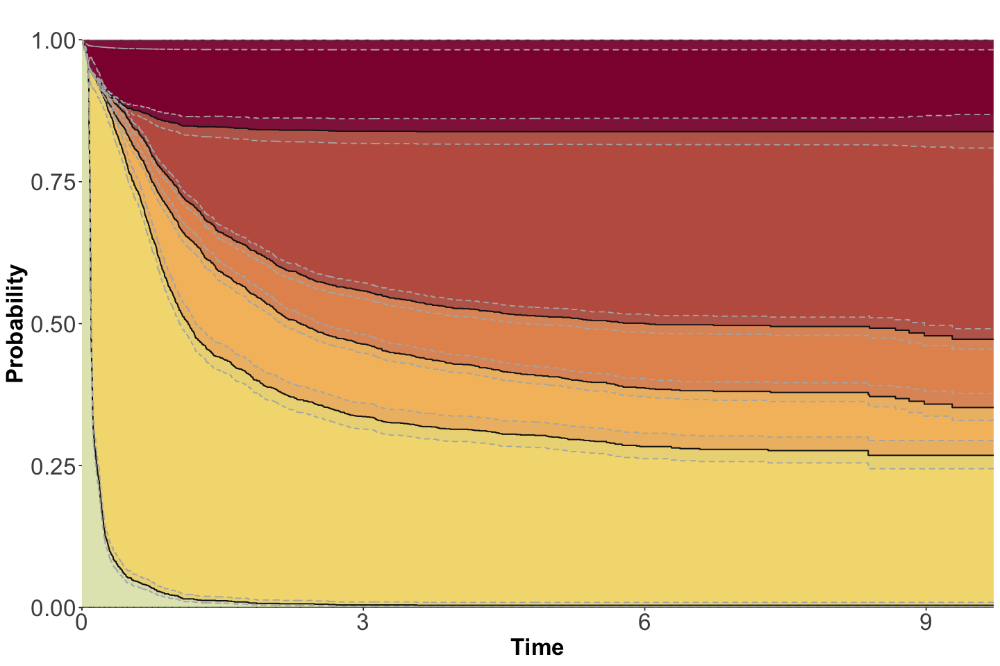

In [55]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time Point Data for intensively treated patients
list_intensively_treated <- readRDS("data/list_intensively_treated.rds")
data <- read.table("data/df_TRAINING_personalization_updated.tsv")[,c("patient_id","CR","Relapse",
                                                         "Death_in_CR","Death_in_Relapse",
                                                         "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                                                         "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis)]
data_intense <- data[rownames(data) %in% list_intensively_treated,] 
nrow(data_intense)
# Transition matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data
msdata <- msprep(data = data_intense, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis))

# Transition Probability 
c0_data <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = msdata,method="breslow")
msf0_data <- msfit(object = c0_data,newdata=msdata,trans=tmat_data)
pt0_data <- probtrans(msf0_data, predt = 0, method = "greenwood",direction = "fo")

# Multistate plot
set_notebook_plot_size(12,8)
plot_probtrans_Conf_Interval(pt0_data,statecols,ord,xlim=c(0,10))   

## ***C. Stacked transition probabilities with 95% confidence for each class across time for patients that received intensive treatment.***

[1] 1661

[1] TRUE

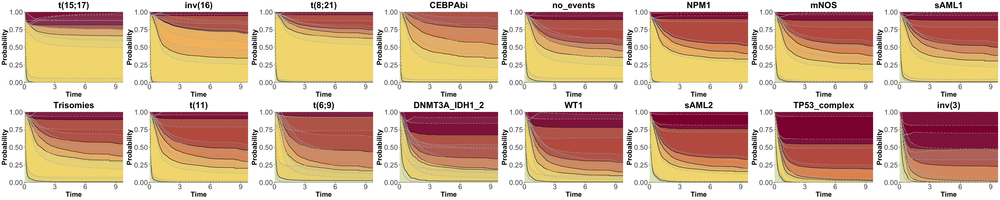

In [56]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time Point Data for intensively treated patients
list_intensively_treated <- readRDS("data/list_intensively_treated.rds")
data <- read.table("data/df_TRAINING_personalization_updated.tsv")[,c("patient_id","CR","Relapse",
                                                         "Death_in_CR","Death_in_Relapse",
                                                         "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                                                         "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis)]
data_intense <- data[rownames(data) %in% list_intensively_treated,] 
nrow(data_intense)
# Transition matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data intense treatment
msdata <- msprep(data = data_intense, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis))

# With classes
msdata_with_comp <- expand.covs(msdata, princ_comps_bis, longnames = FALSE)

# Cox Model with classes
expanded_princ_component <- colnames(msdata_with_comp)[grepl("principal_component_",colnames(msdata_with_comp)) & grepl("\\.",colnames(msdata_with_comp))]
form <- paste("Surv(Tstart, Tstop, status) ~ " , expanded_princ_component[1] , sep="")
for (co in expanded_princ_component[2:(length(expanded_princ_component))]){
    form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
cfull <- coxph(as.formula(form), data = msdata_with_comp, method = "breslow")

comp_ordered <- c("principal_component_t_15_17","principal_component_inv_16","principal_component_t_8_21","principal_component_CEBPA_bi","principal_component_no_events","principal_component_NPM1",
                  "principal_component_mNOS","principal_component_sAML1","principal_component_Trisomies","principal_component_t_11","principal_component_t_6_9","principal_component_DNMT3A_IDH1_2",
                  "principal_component_WT1","principal_component_sAML2","principal_component_TP53_complex","principal_component_inv_3")

# Plots class by class
plots_conf_int <- list()
for (co in comp_ordered){

    whA <- which(msdata_with_comp[,co]==1)
    patA <-  msdata_with_comp[rep(whA[1], each=5), c(princ_comps_bis)]
    patA$trans <- 1:5
    attr(patA, "trans") <- tmat_data
    patA <- expand.covs(patA, c(princ_comps_bis), longnames = FALSE)
    patA$strata <- patA$trans
    msfA <- msfit(cfull, patA, trans = tmat_data)
    main <- str_remove(co,"principal_component_")
    main <- ifelse(main=="t_15_17","t(15;17)",
                  ifelse(main=="inv_16","inv(16)",
                        ifelse(main=="t_8_21","t(8;21)",
                              ifelse(main=="t_11","t(11)",
                                     ifelse(main=="t_6_9","t(6;9)",
                                         ifelse(main=="inv_3","inv(3)",
                                                ifelse(main=="CEBPA_bi","CEBPAbi",  main)))))))
    ptA <- probtrans(msfA, predt = 0,variance=T)
    plots_conf_int[[co]] <- plot_probtrans_Conf_Interval(ptA,statecols,ord,xlim=c(0,10),main=main)
    }

# Plots
set_notebook_plot_size(40,8)
do.call("grid.arrange",c(plots_conf_int,nrow=2))

is_one_to_one_mapping(msdata_with_comp)

# **S.Figure 35: Cumulative incidence and risk outcomes for different subsets in the AML NCRI Trial (n=2,017).**

## ***A. Cumulative incidence curves comparing inv(16) and t(8;21) classes.***


 censor relapse   death 
    483     778     199 

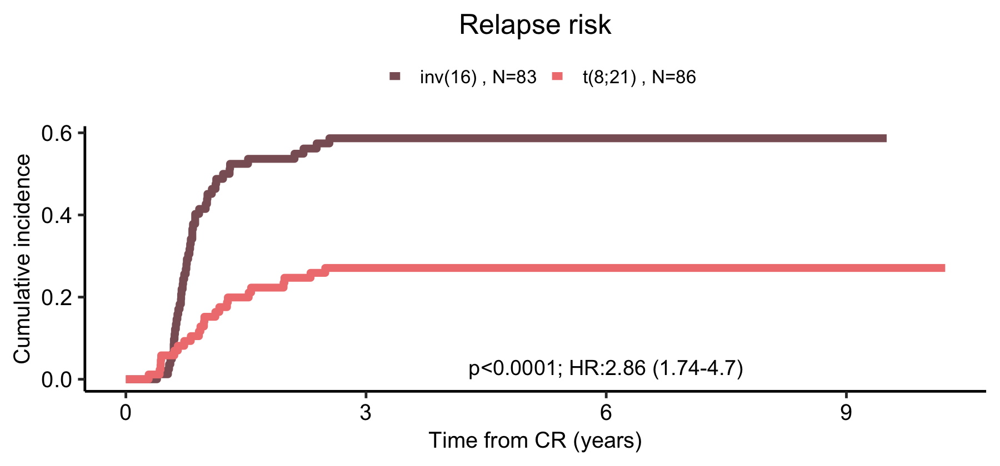

In [57]:
# Prepare Cumulative Incidence data from CR Time
df_TimePoints <- read.table("data/df_TRAINING_personalization_updated.tsv")

df_TimePoints <- df_TimePoints[df_TimePoints$CR_stat==1,]   ### Keep only patients that had CR
df_TimePoints$RFS <- 0
df_TimePoints$RelapseCIStatus <- 0

df_TimePoints[df_TimePoints$Relapse_stat==1,"RelapseCIStatus"] <- 1
df_TimePoints[df_TimePoints$Relapse_stat==0 & df_TimePoints$OS_stat==1,"RelapseCIStatus"] <- 2

df_TimePoints[df_TimePoints$RelapseCIStatus==1,"RFS"] <- df_TimePoints[df_TimePoints$RelapseCIStatus==1,"Relapse"]-df_TimePoints[df_TimePoints$RelapseCIStatus==1,"CR"]
df_TimePoints[df_TimePoints$RelapseCIStatus!=1,"RFS"] <- df_TimePoints[df_TimePoints$RelapseCIStatus!=1,"OS"]-df_TimePoints[df_TimePoints$RelapseCIStatus!=1,"CR"]

df_TimePoints$comp_sample_years <- df_TimePoints$RFS
df_TimePoints$comp_status <- "censor"
df_TimePoints$comp_status[df_TimePoints$RelapseCIStatus==1] <- "relapse"
df_TimePoints$comp_status[df_TimePoints$RelapseCIStatus==2] <- "death"
df_TimePoints$comp_status <- factor(df_TimePoints$comp_status, levels=c("censor","relapse","death"))

table(df_TimePoints$comp_status)

# Prepare data for specific classes
df_specific_classes <- df_TimePoints[df_TimePoints$principal_component_t_8_21==1 | df_TimePoints$principal_component_inv_16==1,]
df_specific_classes$comparison <- ifelse(df_specific_classes$principal_component_t_8_21==1,"t(8;21)","inv(16)")

cmfit <- with(df_specific_classes,cuminc(comp_sample_years,comp_status,comparison,cencode="censor"))
tlg <- table(df_specific_classes$comparison[!is.na(df_specific_classes$comp_sample_years)])
myleg <- paste0(" ", names(tlg)," , N=",tlg,"")

# Get pvalue
pval <- cmfit$Tests["relapse","pv"]
pval <- ifelse(round(pval,4)==0,"p<0.0001",paste("p=",round(pval,4)))

# Add HR and CI
z <- crr(df_specific_classes$RFS,df_specific_classes$RelapseCIStatus,df_specific_classes[,"principal_component_inv_16"])
sum <- summary(z)
text_HR <- paste("; HR:",round(sum$conf.int[1],2)," (",round(sum$conf.int[3],2),"-",round(sum$conf.int[4],2),")",sep="")
res <- paste(pval,text_HR,sep="")

# Prepare plot
cr <- gg_competingrisks.cuminc(cmfit,line.size=4,group.levels=names(tlg))+
      scale_color_manual(values=c("#8B5F65","#F08080"),labels=myleg)+
      theme(axis.text.y=element_text(size=24),axis.text.x=element_text(size=24),
            axis.title.x = element_text(size=24),axis.title.y = element_text(size=24),
            plot.title = element_text(size=30),
            legend.key.width = unit(0.5,"cm"),legend.text = element_text(size=20),legend.title = element_blank())+
      annotate("text",label=res,x=6,y=0.03,size=8)

# Plot cumulative incidence
set_notebook_plot_size(15,7)
cr

## ***B. Cumulative incidence curves comparing patients with and without ITD.***


 censor relapse   death 
    483     778     199 

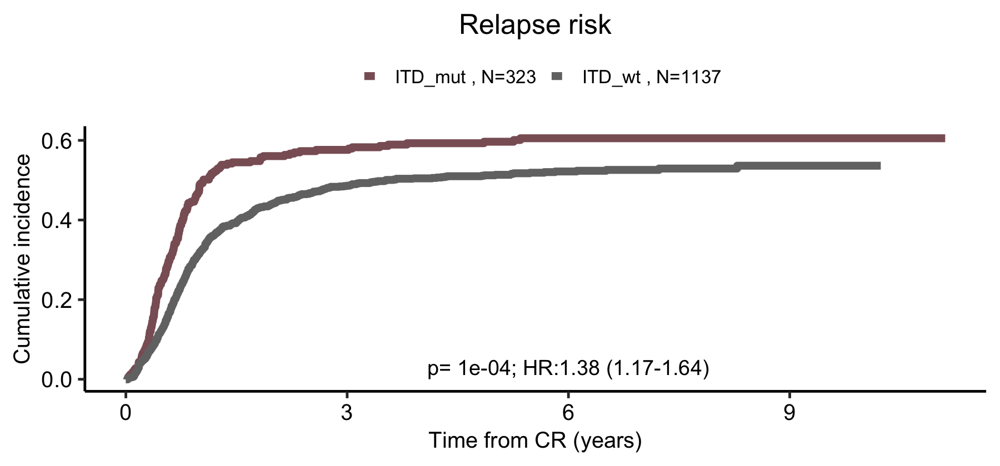

In [58]:
# Prepare Cumulative Incidence data from CR Time
df_TimePoints <- read.table("data/df_TRAINING_personalization_updated.tsv")

df_TimePoints <- df_TimePoints[df_TimePoints$CR_stat==1,]   ### Keep only patients that had CR
df_TimePoints$RFS <- 0
df_TimePoints$RelapseCIStatus <- 0

df_TimePoints[df_TimePoints$Relapse_stat==1,"RelapseCIStatus"] <- 1
df_TimePoints[df_TimePoints$Relapse_stat==0 & df_TimePoints$OS_stat==1,"RelapseCIStatus"] <- 2

df_TimePoints[df_TimePoints$RelapseCIStatus==1,"RFS"] <- df_TimePoints[df_TimePoints$RelapseCIStatus==1,"Relapse"]-df_TimePoints[df_TimePoints$RelapseCIStatus==1,"CR"]
df_TimePoints[df_TimePoints$RelapseCIStatus!=1,"RFS"] <- df_TimePoints[df_TimePoints$RelapseCIStatus!=1,"OS"]-df_TimePoints[df_TimePoints$RelapseCIStatus!=1,"CR"]

df_TimePoints$comp_sample_years <- df_TimePoints$RFS
df_TimePoints$comp_status <- "censor"
df_TimePoints$comp_status[df_TimePoints$RelapseCIStatus==1] <- "relapse"
df_TimePoints$comp_status[df_TimePoints$RelapseCIStatus==2] <- "death"
df_TimePoints$comp_status <- factor(df_TimePoints$comp_status, levels=c("censor","relapse","death"))

table(df_TimePoints$comp_status)

# Prepare data for ITD Comparison
df_ITD_comparison <- df_TimePoints
df_ITD_comparison$comparison <- ifelse(df_ITD_comparison$ITD==1,"ITD_mut","ITD_wt")

cmfit <- with(df_ITD_comparison,cuminc(comp_sample_years,comp_status,comparison,cencode="censor"))
tlg <- table(df_ITD_comparison$comparison[!is.na(df_ITD_comparison$comp_sample_years)])
myleg <- paste0(" ", names(tlg)," , N=",tlg,"")


# Get pvalue
pval <- cmfit$Tests["relapse","pv"]
pval <- ifelse(round(pval,4)==0,"p<0.0001",paste("p=",round(pval,4)))

# Add HR and CI
z <- crr(df_ITD_comparison$RFS,df_ITD_comparison$RelapseCIStatus,df_ITD_comparison[,"ITD"])
sum <- summary(z)
text_HR <- paste("; HR:",round(sum$conf.int[1],2)," (",round(sum$conf.int[3],2),"-",round(sum$conf.int[4],2),")",sep="")
res <- paste(pval,text_HR,sep="")

# Prepare plot
cr <- gg_competingrisks.cuminc(cmfit,line.size=4,group.levels=names(tlg),title="Relapse risk")+
      scale_color_manual(values=c("#8B5F65","grey45"),labels=myleg)+
      theme(axis.text.y=element_text(size=24),axis.text.x=element_text(size=24),
            axis.title.x = element_text(size=24),axis.title.y = element_text(size=24),
            plot.title = element_text(size=30),
            legend.key.width = unit(0.5,"cm"),legend.text = element_text(size=20),legend.title = element_blank())+
      annotate("text",label=res,x=6,y=0.03,size=8)

# Plot cumulative incidence
set_notebook_plot_size(15,7)
cr

# **S.Figure 36: Multi-state semi-parametric Cox model incorporating FLT3ITD shift for relevant components in the AML NCRI Trial (n=2,017).**

[1] TRUE

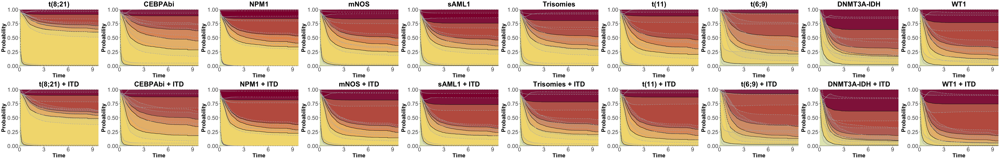

In [59]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time point data for classes and ITD
data <- read.table("data/df_TRAINING_personalization_updated.tsv")[,c("patient_id","CR","Relapse",
                                                         "Death_in_CR","Death_in_Relapse",
                                                         "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                                                         "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis,"ITD")]

# Transition matrix           
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data
msdata_with_comp_ITD <- msprep(data = data, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis,"ITD"))

# With classes and ITD
msdata_with_comp_ITD <- expand.covs(msdata_with_comp_ITD, c(princ_comps_bis,"ITD"), longnames = FALSE)

# Cox Model with classes and ITD
expanded_princ_component <- colnames(msdata_with_comp_ITD)[grepl("principal_component_",colnames(msdata_with_comp_ITD)) & grepl("\\.",colnames(msdata_with_comp_ITD))]
form <- "Surv(Tstart, Tstop, status) ~ ITD.1 + ITD.2 + ITD.3 + ITD.4 + ITD.5"
for (co in c(expanded_princ_component)){
    form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
cfull <- coxph(as.formula(form), data = msdata_with_comp_ITD, method = "breslow")

# Plot classes no ITD (i=1) ; classes with ITD (i=2)
plots_conf_int <- list()
count <- 1 
comp_to_plot <- c("principal_component_t_8_21","principal_component_CEBPA_bi","principal_component_NPM1","principal_component_mNOS",
                  "principal_component_sAML1","principal_component_Trisomies","principal_component_t_11",
                  "principal_component_t_6_9","principal_component_DNMT3A_IDH1_2","principal_component_WT1")
for (i in 1:2){
    for (co in comp_to_plot){

        whA <- which(msdata_with_comp_ITD[,co]==1 & msdata_with_comp_ITD[,"ITD"]==0)
        patA <- msdata_with_comp_ITD[rep(whA[1], each=5), c(princ_comps_bis,"ITD")]
        patA$ITD <- ifelse(i==1,0,1)
        patA$trans <- 1:5
        attr(patA, "trans") <- tmat_data
        patA <- expand.covs(patA, c(princ_comps_bis,"ITD"), longnames = FALSE)
        patA$strata <- patA$trans
        msfA <- msfit(cfull, patA, trans = tmat_data)
        main <- str_remove(co,"principal_component_")
        main <- ifelse(main=="t_15_17","t(15;17)",
                  ifelse(main=="inv_16","inv(16)",
                        ifelse(main=="t_8_21","t(8;21)",
                              ifelse(main=="t_11","t(11)",
                                     ifelse(main=="t_6_9","t(6;9)",
                                                ifelse(main=="DNMT3A_IDH1_2","DNMT3A-IDH",
                                                       ifelse(main=="CEBPA_bi","CEBPAbi",  main)))))))
        main <- ifelse(i==1,main,paste(main,"ITD",sep =" + "))
        ptA <- probtrans(msfA, predt = 0,variance = T)
        plots_conf_int[[count]] <- plot_probtrans_Conf_Interval(ptA,statecols,ord,xlim=c(0,10),main=main)
        count <- count+1
    }
}
set_notebook_plot_size(50,8)
do.call("grid.arrange",c(plots_conf_int,nrow=2))
is_one_to_one_mapping(msdata_with_comp_ITD)

# **S.Figure 37: Validation of multi-state model in the validation AML SG Cohort (n=1,540).**

## ***A. Multi-state transitions with number of patients in each possible state in the AML SG Cohort.***

## ***B. Non-parametric multi-state transition probability with 95% confidence bands for the overall AML SG Cohort.*** 

[1] 1540

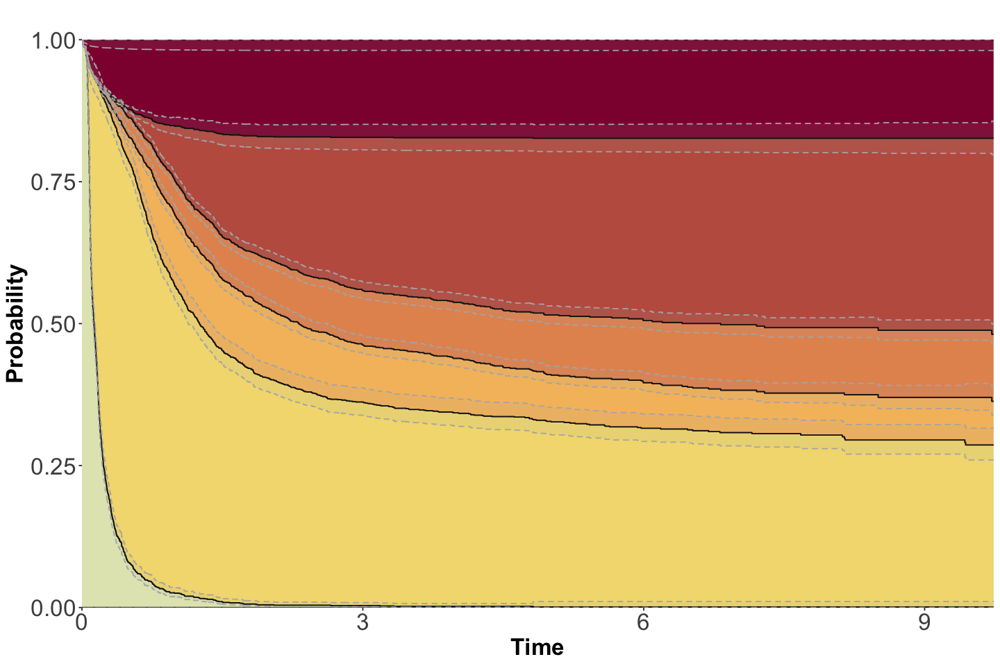

In [60]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time point validation data
data <- read.table("data/df_nejm_personalization.tsv")
data$patient_id <- rownames(data)
data <- data[,c("patient_id","CR","Relapse","Death_in_CR","Death_in_Relapse",
                "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis)]
nrow(data)

# Tranisition matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data
msdata <- msprep(data = data, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis))

# Transition Probability 
c0_data <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = msdata,method="breslow")
msf0_data <- msfit(object = c0_data,newdata=msdata,trans=tmat_data)
pt0_data <- probtrans(msf0_data, predt = 0, method = "greenwood",direction = "fo")

# Multistate plot
set_notebook_plot_size(12,8)
plot_probtrans_Conf_Interval(pt0_data,statecols,ord,xlim=c(0,10)) 

## ***C. Multi-state semi-parametric transition probabilities with 95% confidence bands for each class in the AML SG Cohort.***

[1] 1540

[1] TRUE

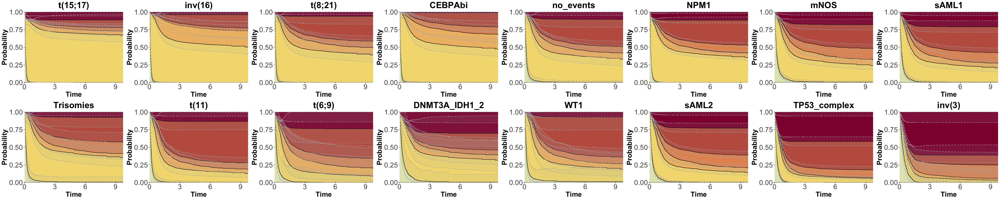

In [61]:
# Colors
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)     

# Time point validation data
data <- read.table("data/df_nejm_personalization.tsv")
data$patient_id <- rownames(data)
data <- data[,c("patient_id","CR","Relapse","Death_in_CR","Death_in_Relapse",
                "Death_without","CR_stat","Relapse_stat","Death_in_CR_stat",
                "Death_in_Relapse_stat","Death_without_stat",princ_comps_bis)]
nrow(data)

# Tranisition matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()), names = c("Alive", "Alive in CR", "Alive in Relapse", "Death in CR" ,"Death in Relapse", "Death without CR"))

# Multistate data
msdata <- msprep(data = data, trans = tmat_data, time = c(NA, "CR", "Relapse",
"Death_in_CR","Death_in_Relapse","Death_without"), status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat","Death_in_Relapse_stat","Death_without_stat"),
                 keep = c("patient_id",princ_comps_bis))

# With classes
msdata_with_comp <- expand.covs(msdata, princ_comps_bis, longnames = FALSE)

# Cox Model with classes
expanded_princ_component <- colnames(msdata_with_comp)[grepl("principal_component_",colnames(msdata_with_comp)) & grepl("\\.",colnames(msdata_with_comp))]
form <- paste("Surv(Tstart, Tstop, status) ~ " , expanded_princ_component[1] , sep="")
for (co in expanded_princ_component[2:(length(expanded_princ_component))]){
    form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
cfull <- coxph(as.formula(form), data = msdata_with_comp, method = "breslow")

        
comp_ordered <- c("principal_component_t_15_17","principal_component_inv_16","principal_component_t_8_21","principal_component_CEBPA_bi","principal_component_no_events","principal_component_NPM1",
                  "principal_component_mNOS","principal_component_sAML1","principal_component_Trisomies","principal_component_t_11","principal_component_t_6_9","principal_component_DNMT3A_IDH1_2",
                  "principal_component_WT1","principal_component_sAML2","principal_component_TP53_complex","principal_component_inv_3")

# Plots class by class
plots_conf_int <- list()
for (co in comp_ordered){

    whA <- which(msdata_with_comp[,co]==1)
    patA <-  msdata_with_comp[rep(whA[1], each=5), c(princ_comps_bis)]
    patA$trans <- 1:5
    attr(patA, "trans") <- tmat_data
    patA <- expand.covs(patA, c(princ_comps_bis), longnames = FALSE)
    patA$strata <- patA$trans
    msfA <- msfit(cfull, patA, trans = tmat_data)
    main <- str_remove(co,"principal_component_")
    main <- ifelse(main=="t_15_17","t(15;17)",
                  ifelse(main=="inv_16","inv(16)",
                        ifelse(main=="t_8_21","t(8;21)",
                              ifelse(main=="t_11","t(11)",
                                     ifelse(main=="t_6_9","t(6;9)",
                                         ifelse(main=="inv_3","inv(3)",
                                                ifelse(main=="CEBPA_bi","CEBPAbi",  main)))))))
    ptA <- probtrans(msfA, predt = 0,variance=T)
    plots_conf_int[[co]] <- plot_probtrans_Conf_Interval(ptA,statecols,ord,xlim=c(0,10),main=main)
        
    }

# Plots
set_notebook_plot_size(40,8)
do.call("grid.arrange",c(plots_conf_int,nrow=2))
is_one_to_one_mapping(msdata_with_comp)

# **S. Figure 38: Kaplan-Meier overall survival curves, cumulative incidence of relapse and associated risk tables for patients that attained CR in AML17 trial subset, stratified by MRD status post course 1 (n=523).**


 censor relapse   death 
    201     248      74 

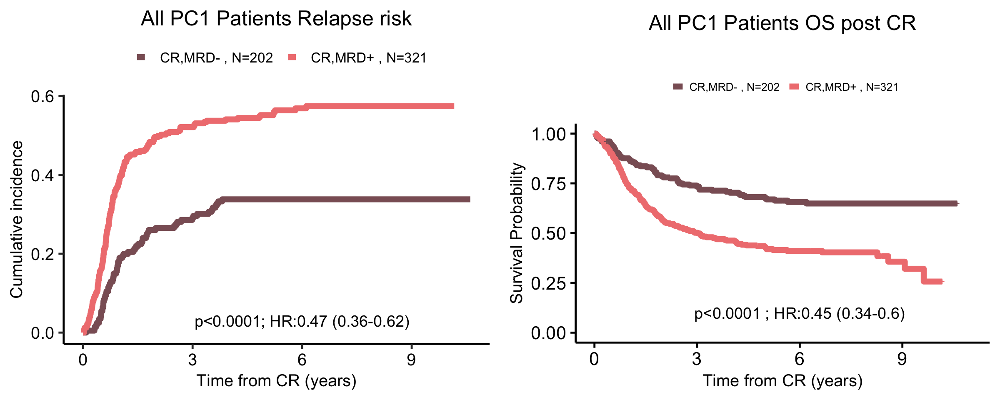

In [62]:
# Prepare MRD data
df_MRD <- read.table("data/aml17_mrd_prepared.tsv")
df_MRD$comparison <- ifelse(df_MRD$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")

df_MRD$comp_sample_years <- df_MRD$RFS
df_MRD$comp_status <- "censor"
df_MRD$comp_status[df_MRD$RelapseCIStatus==1] <- "relapse"
df_MRD$comp_status[df_MRD$RelapseCIStatus==2] <- "death"
df_MRD$comp_status <- factor(df_MRD$comp_status, levels=c("censor","relapse","death"))

table(df_MRD$comp_status)

############## 1. Cumulative Incidence Part 

cmfit <- with(df_MRD,cuminc(comp_sample_years,comp_status,comparison,cencode="censor"))
tlg <- table(df_MRD$comparison[!is.na(df_MRD$comp_sample_years)])
myleg <- paste0(" ", names(tlg)," , N=",tlg,"")

# Get pvalue
pval <- cmfit$Tests["relapse","pv"]
pval <- ifelse(round(pval,4)==0,"p<0.0001",paste("p=",round(pval,4)))

# Add HR and CI
z <- crr(df_MRD$RFS,df_MRD$RelapseCIStatus,df_MRD[,c("CR_MRD_neg")])
sum <- summary(z)
text_HR <- paste("; HR:",round(sum$conf.int[1],2)," (",round(sum$conf.int[3],2),"-",round(sum$conf.int[4],2),")",sep="")
res <- paste(pval,text_HR,sep="")

# Prepare Cumulative Incidence Plot
cr <- gg_competingrisks.cuminc(cmfit,line.size=4,group.levels=names(tlg))+
scale_color_manual(values=c("#8B5F65","#F08080"),labels=myleg)+
theme(axis.text.y=element_text(size=24),axis.text.x=element_text(size=24),
      axis.title.x = element_text(size=24),axis.title.y = element_text(size=24),
      plot.title = element_text(size=30),
      legend.key.width = unit(0.5,"cm"),legend.text = element_text(size=20),legend.title = element_blank())+
      annotate("text",label=res,x=6,y=0.03,size=8)+
ggtitle("All PC1 Patients Relapse risk")





############## 2. Survival part

# Surv
surv_object <- Surv(time = df_MRD$OS_CR, event = df_MRD$DiedYN)
fit <- survfit(surv_object ~ comparison, data = df_MRD)
plot_surv <- plot_surv_curves(fit,y="Survival Probability",submain="",pval=F,risk.table.y.text=0,
                               font.legend=16,vals = c("#8B5F65","#F08080"),x="Time from CR (years)",xlim=c(0,11),break.x.by=3,risk.tab=T)


# Get pvalue and HR CI
res <- get_pvalue_and_HR(Surv(OS_CR,DiedYN)~CR_MRD_neg,data = df_MRD)

# Survival Plot
p <- plot_surv$plot+
     annotate(geom="text", x=6 , y=0.1, label=res,size=8,color="black")+
     theme(plot.title = element_text(hjust = 0.5,size=30,vjust=0))+
     ggtitle("All PC1 Patients OS post CR")

risk_tab <- plot_surv$table

# Plots
set_notebook_plot_size(20,8)
grid.arrange(cr,p,nrow=1)


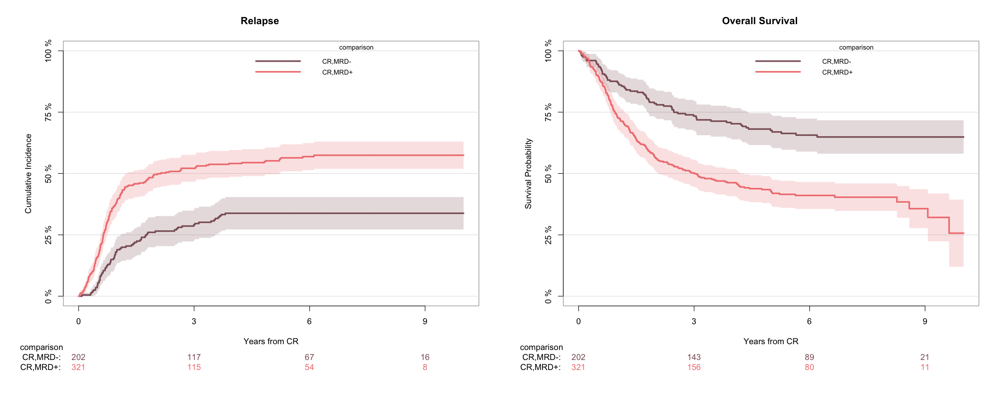

In [63]:
# Risk tables :

tmp <- read.table("data/aml17_mrd_prepared.tsv")
tmp$comparison <- ifelse(tmp$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
set_notebook_plot_size(20,8)
par(mfrow=c(1,2))
cmv <- prodlim(Hist(RFS, RelapseCIStatus) ~comparison, data=tmp )
plot(cmv, cause=1, xlim=c(0, 10),
     xlab = "Years from CR", ylab = "Cumulative Incidence",
     atRisk.at = seq(0, 10, 3), axis1.at = seq(0, 10, 3),
     legend.cex = 0.8, col = c("#8B5F65","#F08080"))
title(main="Relapse", cex=3)

cmv <- prodlim(Hist(OS_CR, DiedYN) ~comparison, data=tmp )
plot(cmv,  xlim=c(0, 10),
     xlab = "Years from CR", ylab = "Survival Probability",
     atRisk.at = seq(0, 10, 3), axis1.at = seq(0, 10, 3),
     legend.cex = 0.8, col = c("#8B5F65","#F08080"))
title(main="Overall Survival", cex=3)

# **S. Figure 39: Kaplan-Meier overall survival curves, cumulative incidence of relapse and associated risk tables for the sAML2, sAML1 subgroups that attained CR in AML17, stratified by MRD status post course 1.**

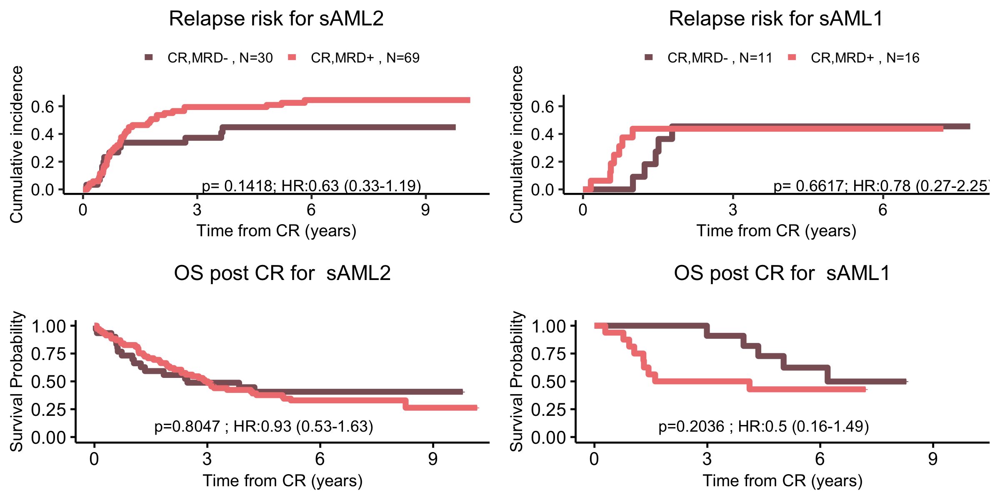

In [64]:
# Prepare MRD data
df_MRD <- read.table("data/aml17_mrd_prepared.tsv")
df_MRD$comparison <- ifelse(df_MRD$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")

df_MRD$comp_sample_years <- df_MRD$RFS
df_MRD$comp_status <- "censor"
df_MRD$comp_status[df_MRD$RelapseCIStatus==1] <- "relapse"
df_MRD$comp_status[df_MRD$RelapseCIStatus==2] <- "death"
df_MRD$comp_status <- factor(df_MRD$comp_status, levels=c("censor","relapse","death"))

p <- list()
cr <- list()
risk_tab <- list()
i <- 1

for (event in c("principal_component_sAML2","principal_component_sAML1")){

    tmp <- df_MRD[df_MRD[,event]==1 ,]
    tmp_cr <- df_MRD[df_MRD[,event]==1 ,]
    title <- str_remove(event,"principal_component_")
        
######## Cumulative Incidence 
    tmp_cr$comparison <- ifelse(tmp_cr$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
    cmfit <- with(tmp_cr,cuminc(comp_sample_years,comp_status,comparison,cencode="censor"))
    tlg <- table(tmp_cr$comparison[!is.na(tmp_cr$comp_sample_years)])
    myleg <- paste0(" ", names(tlg)," , N=",tlg,"")

    # Get pvalue
    pval <- cmfit$Tests["relapse","pv"]
    pval <- ifelse(round(pval,4)==0,"p<0.0001",paste("p=",round(pval,4)))
    # Add HR and CI
    z <- crr(tmp_cr$RFS,tmp_cr$RelapseCIStatus,tmp_cr[,c("CR_MRD_neg")])
    sum <- summary(z)
    text_HR <- paste("; HR:",round(sum$conf.int[1],2)," (",round(sum$conf.int[3],2),"-",round(sum$conf.int[4],2),")",sep="")
    res <- paste(pval,text_HR,sep="")

    # Prepare Cumulative Incidence Plot
    cr[[i]] <- gg_competingrisks.cuminc(cmfit,line.size=4,group.levels=names(tlg),title=paste("Relapse risk for",title))+
               scale_color_manual(values=c("#8B5F65","#F08080"),labels=myleg)+
               theme(axis.text.y=element_text(size=24),axis.text.x=element_text(size=24),
                     axis.title.x = element_text(size=24),axis.title.y = element_text(size=24),
                     plot.title = element_text(size=30),
                     legend.key.width = unit(0.5,"cm"),legend.text = element_text(size=20),legend.title = element_blank())+
               annotate("text",label=res,x=6,y=0.03,size=8)+ylim(c(0,0.65))

######## Survival         
    tmp$comparison <- ifelse(tmp$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
    surv_object <- Surv(time = tmp$OS_CR, event = tmp$DiedYN)
    fit <- survfit(surv_object ~ comparison, data = tmp)


    # Add Pval and HR CI
    res <- get_pvalue_and_HR(Surv(OS_CR,DiedYN)~CR_MRD_neg,data = tmp)

    # Surv Plot        
    p[[i]] <- plot_surv_curves(fit,y="Survival Probability",submain="",pval=F,legend="none",
                               font.legend=16,vals = c("#8B5F65","#F08080"),
                               x="Time from CR (years)",xlim=c(0,10),break.x.by=3)$plot+
              annotate(geom="text", x=4.5 , y=0.1, label=res,size=8,color="black")+
              theme(plot.title = element_text(hjust = 0.5,size=30,vjust=0))+
              ggtitle(paste("OS post CR for " ,title ))

    risk_tab[[i]] <- plot_surv_curves(fit,y="Survival Probability",submain="",pval=F,risk.tab=T,risk.table.y.text=0,
                           font.legend=16,vals = c("#8B5F65","#F08080"),x="Time from CR (years)",xlim=c(0,10),break.x.by=3)$table

    i <- i+1
    
}

# Plots
set_notebook_plot_size(20,10)
do.call("grid.arrange",list(cr[[1]],cr[[2]],p[[1]],p[[2]],nrow=2))

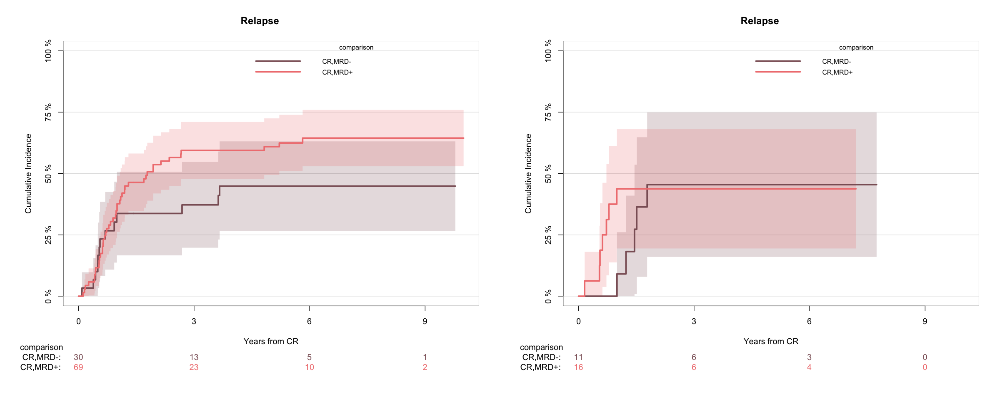

In [65]:
# Risk tables :
par(mfrow=c(1,2))
for (event in c("principal_component_sAML2","principal_component_sAML1")){
    tmp <- read.table("data/aml17_mrd_prepared.tsv")
    tmp <- tmp[tmp[,event]==1,]
    tmp$comparison <- ifelse(tmp$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
    set_notebook_plot_size(20,8)
    
    cmv <- prodlim(Hist(RFS, RelapseCIStatus) ~comparison, data=tmp )
    plot(cmv, cause=1, xlim=c(0, 10),
         xlab = "Years from CR", ylab = "Cumulative Incidence",
         atRisk.at = seq(0, 10, 3), axis1.at = seq(0, 10, 3),
         legend.cex = 0.8, col = c("#8B5F65","#F08080"))
    title(main="Relapse", cex=3)
}


# **S.Figure 40: Summary by class for cumulative incidence and Kaplan-Meier curves for survival post complete remission on AML 17 NCRI Trial Cohort with post course 1 minimal residual disease (MRD) analysis analysis (n=523).**

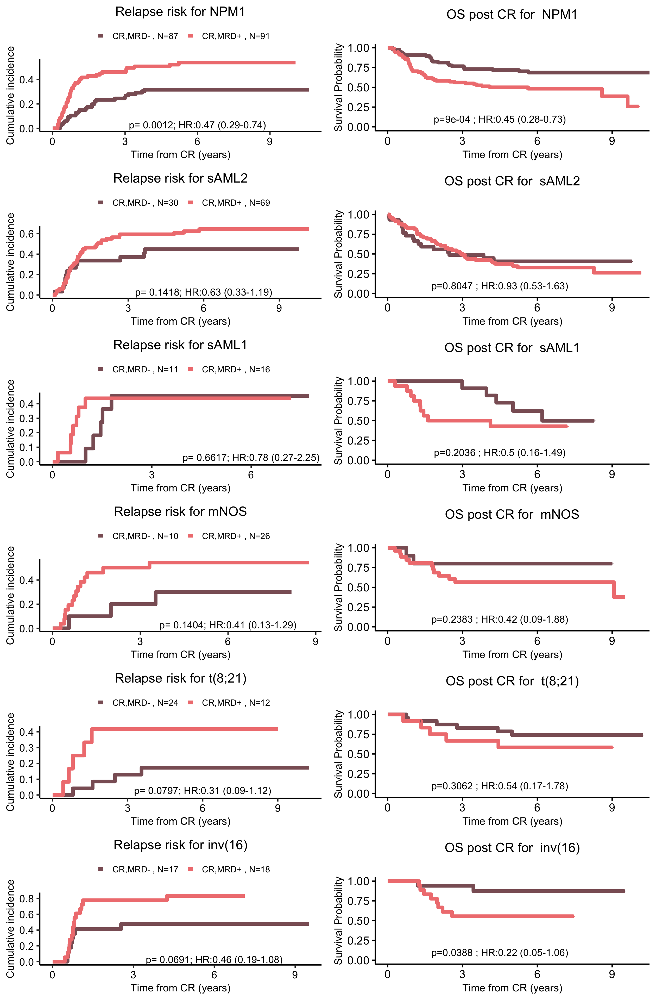

In [66]:
# Prepare MRD data
df_MRD <- read.table("data/aml17_mrd_prepared.tsv")
df_MRD$comparison <- ifelse(df_MRD$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")

df_MRD$comp_sample_years <- df_MRD$RFS
df_MRD$comp_status <- "censor"
df_MRD$comp_status[df_MRD$RelapseCIStatus==1] <- "relapse"
df_MRD$comp_status[df_MRD$RelapseCIStatus==2] <- "death"
df_MRD$comp_status <- factor(df_MRD$comp_status, levels=c("censor","relapse","death"))

p <- list()
cr <- list()
i <- 1

for (event in princ_comps_bis){
    tmp <- df_MRD[df_MRD[,event]==1 ,]
    tmp_cr <- df_MRD[df_MRD[,event]==1,]
    
    # Keep only classes with more than 10 patients to compare
    if(nrow(tmp[tmp$CR_MRD_neg==1,])>=10 & nrow(tmp[tmp$CR_MRD_pos==1,])>=10){
        title <- str_remove(event,"principal_component_")
        title <- ifelse(title=="t_8_21","t(8;21)",
                       ifelse(title=="inv_16","inv(16)",title))

############ Cumulative Incidence 
        tmp_cr$comparison <- ifelse(tmp_cr$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
        cmfit <- with(tmp_cr,cuminc(comp_sample_years,comp_status,comparison,cencode="censor"))
        tlg <- table(tmp_cr$comparison[!is.na(tmp_cr$comp_sample_years)])
        myleg <- paste0(" ", names(tlg)," , N=",tlg,"")

        # Get pvalue
        pval <- cmfit$Tests["relapse","pv"]
        pval <- ifelse(round(pval,4)==0,"p<0.0001",paste("p=",round(pval,4)))
        # Add HR and CI
        z <- crr(tmp_cr$RFS,tmp_cr$RelapseCIStatus,tmp_cr[,c("CR_MRD_neg")])
        sum <- summary(z)
        text_HR <- paste("; HR:",round(sum$conf.int[1],2)," (",round(sum$conf.int[3],2),"-",round(sum$conf.int[4],2),")",sep="")
        res <- paste(pval,text_HR,sep="")

        # Prepare Cumulative Incidence Plot
        cr[[i]] <- gg_competingrisks.cuminc(cmfit,line.size=4,group.levels=names(tlg),title=paste("Relapse risk for",title))+
                   scale_color_manual(values=c("#8B5F65","#F08080"),labels=myleg)+
                   theme(axis.text.y=element_text(size=24),axis.text.x=element_text(size=24),
                         axis.title.x = element_text(size=24),axis.title.y = element_text(size=24),
                         plot.title = element_text(size=30),
                         legend.key.width = unit(0.5,"cm"),legend.text = element_text(size=20),legend.title = element_blank())+
                   annotate("text",label=res,x=6,y=0.03,size=8)

############ Survival         
        tmp$comparison <- ifelse(tmp$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
        surv_object <- Surv(time = tmp$OS_CR, event = tmp$DiedYN)
        fit <- survfit(surv_object ~ comparison, data = tmp)


        # Add Pval and HR CI
        res <- get_pvalue_and_HR(Surv(OS_CR,DiedYN)~CR_MRD_neg,data = tmp)

        # Surv Plot        
        p[[i]] <- plot_surv_curves(fit,y="Survival Probability",submain="",pval=F,legend="none",
                                   font.legend=16,vals = c("#8B5F65","#F08080"),
                                   x="Time from CR (years)",xlim=c(0,10),break.x.by=3)$plot+
                  annotate(geom="text", x=4.5 , y=0.1, label=res,size=8,color="black")+
                  theme(plot.title = element_text(hjust = 0.5,size=30,vjust=0))+
                  ggtitle(paste("OS post CR for " ,title ))

        i <- i+1
    }  
}

# Plots
set_notebook_plot_size(21,32)
grid.arrange(cr[[1]],p[[1]],cr[[2]],p[[2]],cr[[3]],p[[3]],cr[[4]],p[[4]],cr[[5]],p[[5]],cr[[6]],p[[6]],nrow=6)

# **S.Figure 41: Summary by genes mutations and cytogenetics abnormalities for cumulative incidence and Kaplan-Meier curves for survival post complete remission on AML 17 NCRI Trial Cohort with post course 1 minimal residual disease (MRD) analysis (n=523).**

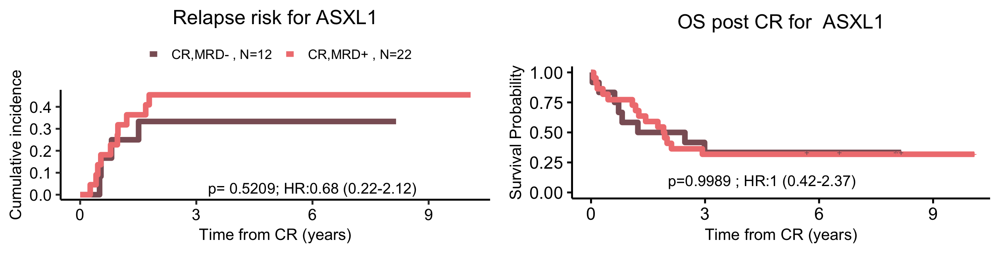

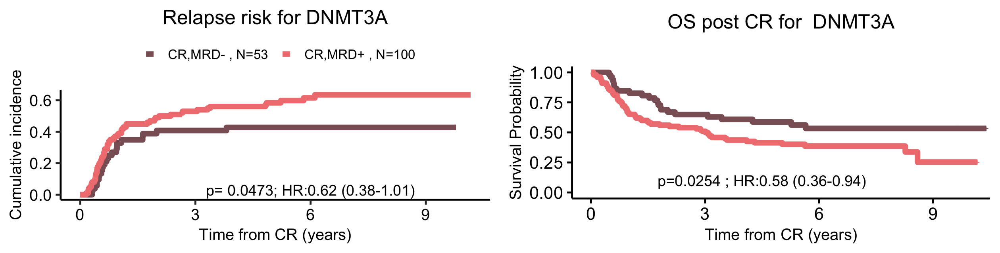

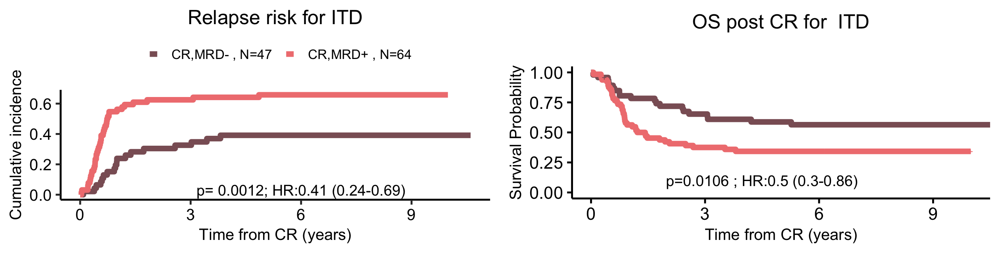

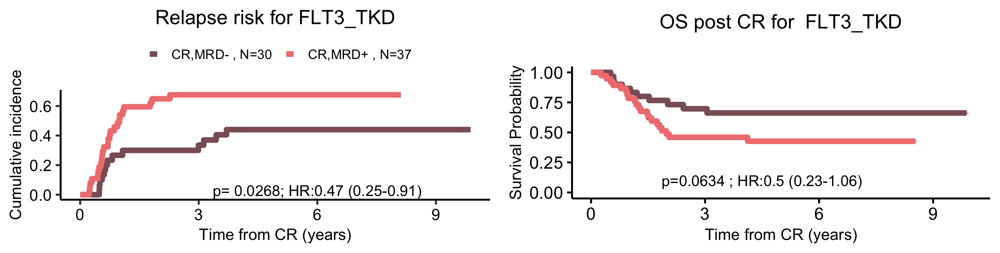

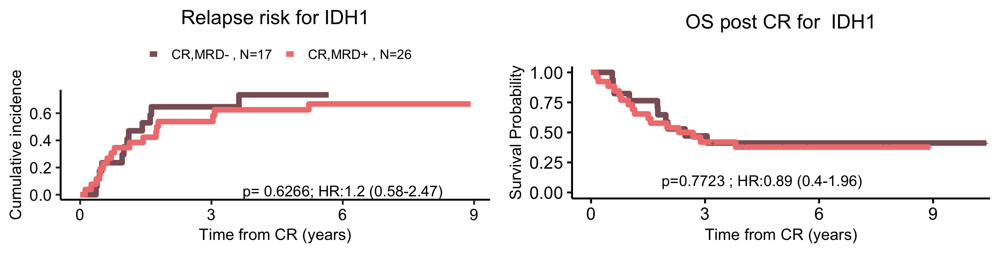

...

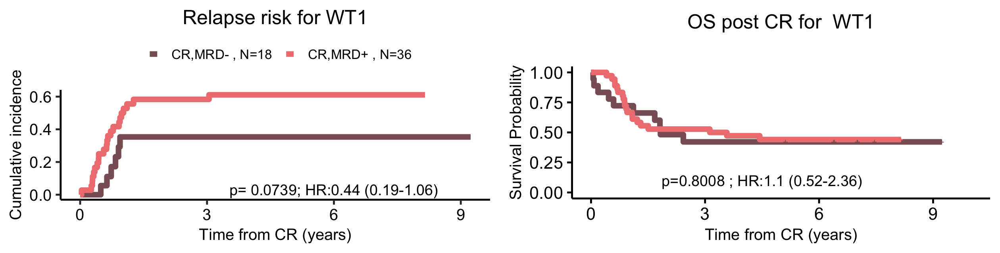

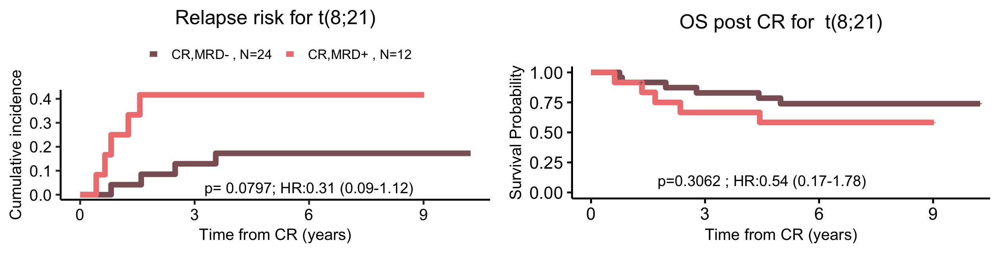

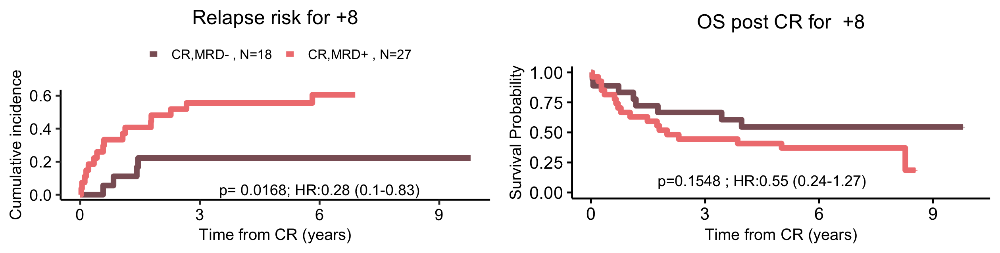

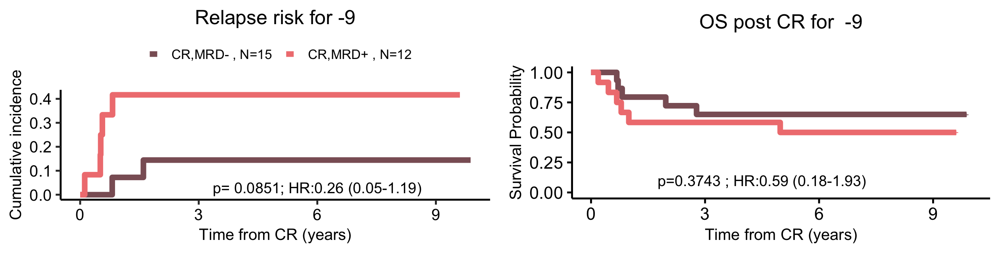

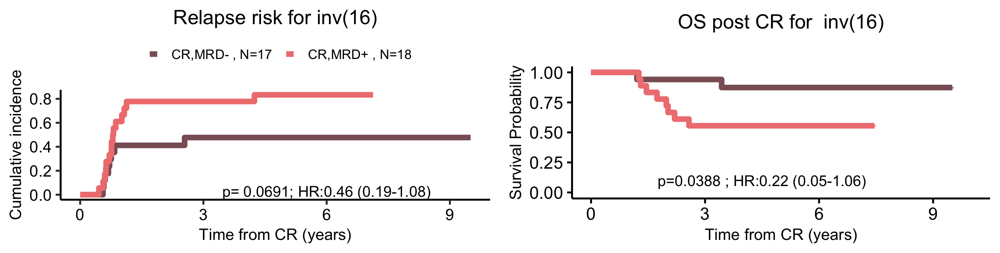

In [67]:
# Prepare MRD data
df_MRD <- read.table("data/aml17_mrd_prepared.tsv")
df_MRD$comparison <- ifelse(df_MRD$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")

df_MRD$comp_sample_years <- df_MRD$RFS
df_MRD$comp_status <- "censor"
df_MRD$comp_status[df_MRD$RelapseCIStatus==1] <- "relapse"
df_MRD$comp_status[df_MRD$RelapseCIStatus==2] <- "death"
df_MRD$comp_status <- factor(df_MRD$comp_status, levels=c("censor","relapse","death"))

p <- list()
cr <- list()
i <- 1

for (event in c(genes,cytos_bis)){
    tmp <- df_MRD[df_MRD[,event]==1 ,]
    tmp_cr <- df_MRD[df_MRD[,event]==1,]
    
    # Keep only events with more than 10 patients to compare
    if(nrow(tmp[tmp$CR_MRD_neg==1,])>=10 & nrow(tmp[tmp$CR_MRD_pos==1,])>=10){
        title <- ifelse(event=="t_8_21","t(8;21)",
                       ifelse(event=="inv_16","inv(16)",
                           ifelse(event=="add_8","+8",
                              ifelse(event=="del_9","-9",event))))

############ Cumulative Incidence 
        tmp_cr$comparison <- ifelse(tmp_cr$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
        cmfit <- with(tmp_cr,cuminc(comp_sample_years,comp_status,comparison,cencode="censor"))
        tlg <- table(tmp_cr$comparison[!is.na(tmp_cr$comp_sample_years)])
        myleg <- paste0(" ", names(tlg)," , N=",tlg,"")

        # Get pvalue
        pval <- cmfit$Tests["relapse","pv"]
        pval <- ifelse(round(pval,4)==0,"p<0.0001",paste("p=",round(pval,4)))
        # Add HR and CI
        z <- crr(tmp_cr$RFS,tmp_cr$RelapseCIStatus,tmp_cr[,c("CR_MRD_neg")])
        sum <- summary(z)
        text_HR <- paste("; HR:",round(sum$conf.int[1],2)," (",round(sum$conf.int[3],2),"-",round(sum$conf.int[4],2),")",sep="")
        res <- paste(pval,text_HR,sep="")

        # Prepare Cumulative Incidence Plot
        cr[[i]] <- gg_competingrisks.cuminc(cmfit,line.size=4,group.levels=names(tlg),title=paste("Relapse risk for",title))+
                   scale_color_manual(values=c("#8B5F65","#F08080"),labels=myleg)+
                   theme(axis.text.y=element_text(size=24),axis.text.x=element_text(size=24),
                         axis.title.x = element_text(size=24),axis.title.y = element_text(size=24),
                         plot.title = element_text(size=30),
                         legend.key.width = unit(0.5,"cm"),legend.text = element_text(size=20),legend.title = element_blank())+
                   annotate("text",label=res,x=6,y=0.03,size=8)

############ Survival         
        tmp$comparison <- ifelse(tmp$CR_MRD_neg==1,"CR,MRD-","CR,MRD+")
        surv_object <- Surv(time = tmp$OS_CR, event = tmp$DiedYN)
        fit <- survfit(surv_object ~ comparison, data = tmp)


        # Add Pval and HR CI
        res <- get_pvalue_and_HR(Surv(OS_CR,DiedYN)~CR_MRD_neg,data = tmp)

        # Surv Plot        
        p[[i]] <- plot_surv_curves(fit,y="Survival Probability",submain="",pval=F,legend="none",
                                   font.legend=16,vals = c("#8B5F65","#F08080"),
                                   x="Time from CR (years)",xlim=c(0,10),break.x.by=3)$plot+
                  annotate(geom="text", x=4.5 , y=0.1, label=res,size=8,color="black")+
                  theme(plot.title = element_text(hjust = 0.5,size=30,vjust=0))+
                  ggtitle(paste("OS post CR for " ,title ))

        i <- i+1
    }  
}

# Plots
set_notebook_plot_size(21,5.33)
for (i in 1:length(cr)){
    grid.arrange(cr[[i]],p[[i]],nrow=1)
}

# **S.Figure 42: Univariate and Multivariate Regression plots for model containing classes, ITD, clinical information as well as minimal residual disease (MRD) status for relapse (panel A) and survival post complete remission (panel B) endpoints in the AML 17 NCRI Trial Cohort with post course 1 MRD analysis (n=523).**


## ***A. The first panel represents a univariate Cox model for all the covariates mentioned above for the relapse endpoint. The second panel represents a multivariate Cox model for all the covariates mentioned above for the relapse endpoint.***

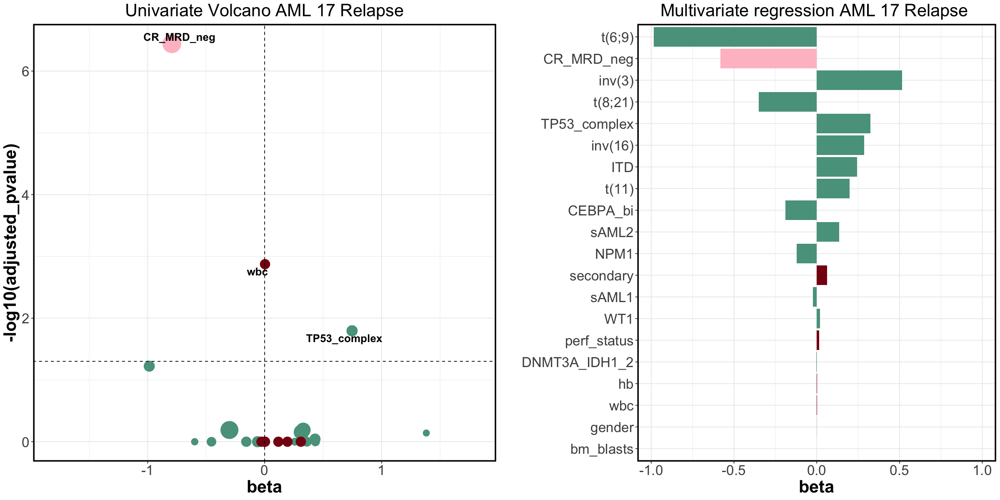

In [68]:
df <- data.frame(beta = double(),pvalue = double(),Frequency = double() )
data <- read.table("data/aml17_mrd_prepared.tsv")
data$RelapseStatus <- ifelse(data$RelapseCIStatus==1,1,0)

########### First Panel : Univariate Plot

for (col in c(princ_comps_bis,"ITD","CR_MRD_neg",clin,demo)){
    fit <- coxph(as.formula(paste("Surv(RFS,RelapseStatus) ~ ",
                       col)), data = data)
    
    df[col,1:3] <- c(summary(fit)$coef[1],summary(fit)$sctest[["pvalue"]],100*sum(data[,col])/dim(data)[1])                 
     }

df[,"adjusted_pvalue"] <- p.adjust(df$pvalue)
df[,"-log10(adjusted_pvalue)"] <- -log(p.adjust(df$pvalue),10)
df["names"] <- rownames(df)
df$Model <- ifelse(df$names %in% mrd, "mrd",
                    ifelse(df$names %in% c(clin,demo), "clin","comp"))
df$names <- str_remove(df$names,"principal_component_")
df$names <- ifelse(grepl("^add_",df$names),str_replace(df$names,"add_","+"),
                          ifelse(grepl("^del",df$names),str_replace(df$names,"del_","-"),
                                ifelse(grepl("minusy",df$names),str_replace(df$names,"minusy","-Y"),
                                      ifelse(grepl("^t_",df$names),paste(str_replace(str_replace(df$names,"t_","t("),"_",";"),")",sep=""),
                                          ifelse(grepl("^inv_",df$names),paste(str_replace(df$names,"inv_","inv("),")",sep=""),df$names)))))
        
df$Frequency <- ifelse(df$names %in% clin, 5,
                              ifelse(df$names %in% demo, 5, df$Frequency))

df <- df[order(df$adjusted_pvalue),]

univariate_relapse_plot <- ggplot(df, aes(beta, -log10(adjusted_pvalue)))+
                           theme_bw()+
                           theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                                 axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                                 panel.border = element_rect(colour = "black", fill=NA, size=2),
                                 legend.position="none")+ 
                           geom_point(aes(size=Frequency,col=Model))+
                           geom_text_repel(data=df[(df["adjusted_pvalue"]<0.05) ,], aes(label=names,fontface=2,size=3))+
                           scale_size_continuous(range = c(3,12))+ 
                           scale_color_manual(values=colors_analysis,limits=names(colors_analysis))+
                           geom_vline(xintercept=0,linetype="dashed")+
                           xlim(c(-1.8,1.8))+
                           geom_hline(yintercept=-log(0.05,10),linetype="dashed")+
                           ggtitle("Univariate Volcano AML 17 Relapse")

########### Second Panel : Multivariate Plot

df_multi <- NULL
i <- 1
iterations <- 100
for (i in c(1:iterations)){
    res1 <- cv.glmnet(data.matrix(data[,c(princ_comps_bis,"ITD","CR_MRD_neg",clin,demo)]),
                      Surv(data$RFS,data$RelapseStatus), family="cox",alpha=1,nfolds=10)
    df_multi <- cbind(df_multi,as.matrix(coef(res1,s="lambda.min")))
    i <- i+1
    }

l <- data.frame(coef = rowSums(df_multi)/iterations)
l$names <- rownames(l)
l$Model <- ifelse(l$names %in% mrd, "mrd",
                    ifelse(l$names %in% c(clin,demo), "clin","comp"))
l$names <- str_remove(l$names,"principal_component_")
l$names <- ifelse(grepl("^add_",l$names),str_replace(l$names,"add_","+"),
                          ifelse(grepl("^del",l$names),str_replace(l$names,"del_","-"),
                                ifelse(grepl("minusy",l$names),str_replace(l$names,"minusy","-Y"),
                                      ifelse(grepl("^t_",l$names),paste(str_replace(str_replace(l$names,"t_","t("),"_",";"),")",sep=""),
                                          ifelse(grepl("^inv_",l$names),paste(str_replace(l$names,"inv_","inv("),")",sep=""),l$names)))))                                                 

l$abs_coef <- abs(l$coef)

multivariate_relapse_plot <- ggplot(l[l$coef!=0,],aes(x=reorder(names,abs_coef),y=coef,fill=Model))+
                             geom_bar(stat="identity")+
                             coord_flip()+
                             theme_bw()+
                             theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                                   axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                                   panel.border = element_rect(colour = "black", fill=NA, size=2),
                                   legend.position="none")+
                             scale_fill_manual(values=colors_analysis,limits=names(colors_analysis))+
                             xlab("")+
                             ylab("beta")+
                             ylim(-max(abs(l$coef)),max(abs(l$coef)))+
                             ggtitle("Multivariate regression AML 17 Relapse ")

# Plots
set_notebook_plot_size(20,10)
grid.arrange(univariate_relapse_plot,multivariate_relapse_plot,nrow=1)

## ***B. The first panel represents a univariate Cox model for all the covariates mentioned above for the death from complete remission endpoint. The second panel represents a multivariate Cox model for all the covariates mentioned above for the survival post complete remission endpoint.***

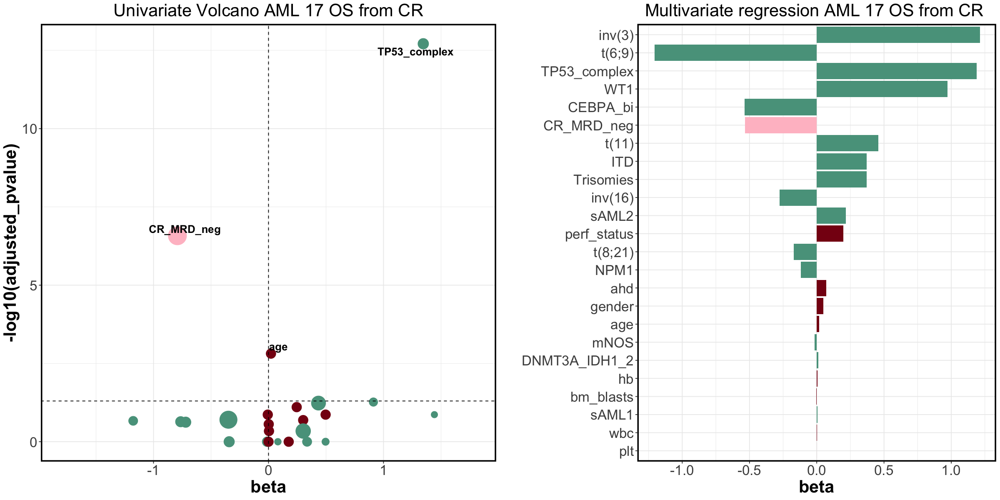

In [69]:
df <- data.frame(beta = double(),pvalue = double(),Frequency = double() )
data <- read.table("data/aml17_mrd_prepared.tsv")

########### First Panel : Univariate Plot

for (col in c(princ_comps_bis,"ITD","CR_MRD_neg",clin,demo)){
    fit <- coxph(as.formula(paste("Surv(OS_CR,DiedYN) ~ ",
                       col)), data = data)

    df[col,1:3] <- c(summary(fit)$coef[1],summary(fit)$sctest[["pvalue"]],100*sum(data[,col])/dim(data)[1])                 
     }
df[,"adjusted_pvalue"] <- p.adjust(df$pvalue)
df[,"-log10(adjusted_pvalue)"] <- -log(p.adjust(df$pvalue),10)
df["names"] <- rownames(df)
df$Model <- ifelse(df$names %in% mrd, "mrd",
                    ifelse(df$names %in% c(clin,demo), "clin","comp"))
df$names <- str_remove(df$names,"principal_component_")

df$names <- ifelse(grepl("^add_",df$names),str_replace(df$names,"add_","+"),
                          ifelse(grepl("^del",df$names),str_replace(df$names,"del_","-"),
                                ifelse(grepl("minusy",df$names),str_replace(df$names,"minusy","-Y"),
                                      ifelse(grepl("^t_",df$names),paste(str_replace(str_replace(df$names,"t_","t("),"_",";"),")",sep=""),
                                          ifelse(grepl("^inv_",df$names),paste(str_replace(df$names,"inv_","inv("),")",sep=""),df$names)))))

df$Frequency <- ifelse(df$names %in% clin, 5,
                              ifelse(df$names %in% demo, 5, df$Frequency))

df <- df[order(df$adjusted_pvalue),]

univariate_OS_plot <- ggplot(df, aes(beta, -log10(adjusted_pvalue)))+
                      theme_bw()+
                      theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                            axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                            panel.border = element_rect(colour = "black", fill=NA, size=2),
                            legend.position="none")+
                      geom_point(aes(size=Frequency,col=Model))+
                      geom_text_repel(data=df[(df["adjusted_pvalue"]<0.05) ,],aes(label=names,fontface=2,size=3))+
                      scale_size_continuous(range = c(3,12))+ 
                      scale_color_manual(values=colors_analysis,limits=names(colors_analysis))+  
                      geom_vline(xintercept=0,linetype="dashed")+
                      xlim(c(-1.8,1.8))+
                      geom_hline(yintercept=-log(0.05,10),linetype="dashed")+
                      ggtitle("Univariate Volcano AML 17 OS from CR")

########### Second Panel : Multivariate Plot

df_multi <- NULL
i <- 1
iterations <- 100
for (i in c(1:iterations)){
    res1 <- cv.glmnet(data.matrix(data[,c(princ_comps_bis,"ITD","CR_MRD_neg",clin,demo)]),
                      Surv(data$OS_CR,data$DiedYN), family="cox",alpha=1,nfolds=10)
    df_multi <- cbind(df_multi,as.matrix(coef(res1,s="lambda.min")))
    i <- i+1
    }

l <- data.frame(coef = rowSums(df_multi)/iterations)
l$names <- rownames(l)
l$Model <- ifelse(l$names %in% mrd, "mrd",
                    ifelse(l$names %in% c(clin,demo), "clin","comp"))
l$names <- str_remove(l$names,"principal_component_")
l$names <- ifelse(grepl("^add_",l$names),str_replace(l$names,"add_","+"),
                          ifelse(grepl("^del_",l$names),str_replace(l$names,"del_","-"),
                                ifelse(grepl("minusy",l$names),str_replace(l$names,"minusy","-Y"),
                                      ifelse(grepl("^t_",l$names),paste(str_replace(str_replace(l$names,"t_","t("),"_",";"),")",sep=""),
                                          ifelse(grepl("^inv_",l$names),paste(str_replace(l$names,"inv_","inv("),")",sep=""),l$names)))))
    
l$abs_coef <- abs(l$coef)

multivariate_OS_plot <- ggplot(l[l$coef!=0,],aes(x=reorder(names,abs_coef),y=coef,fill=Model))+
                        geom_bar(stat="identity")+
                        coord_flip()+
                        theme_bw()+
                        theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                              axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                              panel.border = element_rect(colour = "black", fill=NA, size=2),
                              legend.position="none")+
                        scale_fill_manual(values=colors_analysis,limits=names(colors_analysis))+
                        xlab("")+
                        ylab("beta")+
                        ylim(-max(abs(l$coef)),max(abs(l$coef)))+
                        ggtitle("Multivariate regression AML 17 OS from CR ")

# Plots
set_notebook_plot_size(20,10)
grid.arrange(univariate_OS_plot,multivariate_OS_plot,nrow=1)


# **S.Figure 43: Univariate and Multivariate Regression plots for the classes, ITD stratified by minimal residual disease (MRD) status on Relapse (panel A) and survival post complete remission (panel B) endpoints in the AML 17 NCRI Trial Cohort with post course 1 MRD analysis (n=523).**

## ***A.The first panel represents a univariate Cox model for all the classes stratified by MRD status for the relapse endpoint. The second panel represents a multivariate Cox model for all the covariates mentioned above stratified by MRD status for the relapse endpoint.***

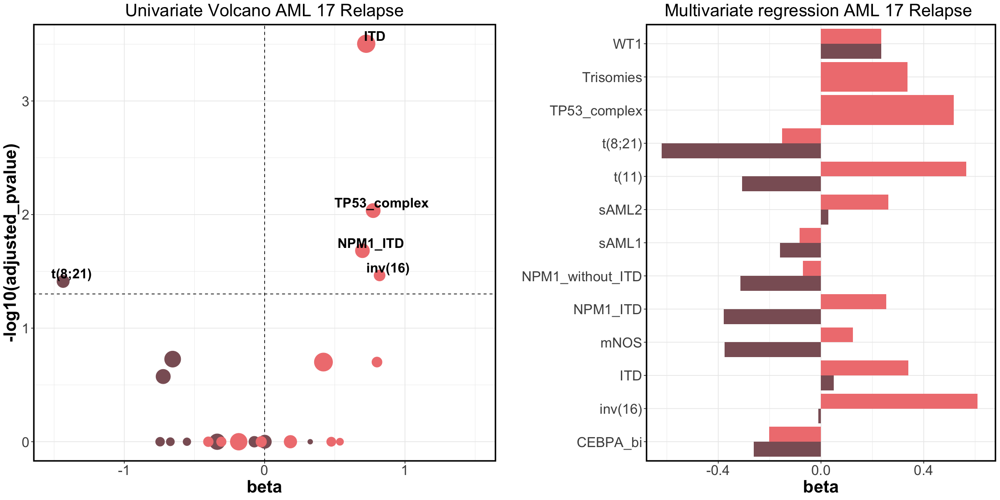

In [70]:
df <- data.frame(beta = double(),pvalue = double(),Frequency = double() )
data <- read.table("data/aml17_mrd_prepared.tsv")
data$RelapseStatus <- ifelse(data$RelapseCIStatus==1,1,0)

for (col in c(princ_comps_bis,"ITD")){
    data[,paste(col,"MRDneg",sep="_")] <- data[,col]*data$CR_MRD_neg
    data[,paste(col,"MRDpos",sep="_")] <- data[,col]*data$CR_MRD_pos
}  

cols_to_keep <- c()
for (col in c(colnames(data)[grep(pattern="MRDneg",colnames(data))],colnames(data)[grep(pattern="MRDpos",colnames(data))])){
    if(nrow(data[data[,col]==1,])>3){
        cols_to_keep <- c(cols_to_keep,col)
    }
}
data$NPM1_ITD_MRDneg <- ifelse(data$principal_component_NPM1_MRDneg==1 & data$ITD_MRDneg==1,1,0)
data$NPM1_ITD_MRDpos <- ifelse(data$principal_component_NPM1_MRDpos==1 & data$ITD_MRDpos==1,1,0)
data$NPM1_without_ITD_MRDneg <- ifelse(data$principal_component_NPM1_MRDneg==1 & data$ITD_MRDneg==0,1,0)
data$NPM1_without_ITD_MRDpos <- ifelse(data$principal_component_NPM1_MRDpos==1 & data$ITD_MRDpos==0,1,0)

data$principal_component_NPM1_MRDneg <- NULL
data$principal_component_NPM1_MRDpos <- NULL

cols_to_keep <- c()
for (col in c(colnames(data)[grep(pattern="MRDneg",colnames(data))],colnames(data)[grep(pattern="MRDpos",colnames(data))])){
    if(nrow(data[data[,col]==1,])>3){
        cols_to_keep <- c(cols_to_keep,col)
    }
}


########### First Panel : Univariate Plot

for (col in cols_to_keep){
    fit <- coxph(as.formula(paste("Surv(RFS,RelapseStatus) ~ ",
                       col)), data = data)

    df[col,1:3] <- c(summary(fit)$coef[1],summary(fit)$sctest[["pvalue"]],100*sum(data[,col])/dim(data)[1])                 
     }
df[,"adjusted_pvalue"] <- p.adjust(df$pvalue)
df[,"-log10(adjusted_pvalue)"] <- -log(p.adjust(df$pvalue),10)
df["names"] <- rownames(df)
df$names <- ifelse(df$names=="principal_component_inv_16_MRDneg","inv(16)_MRDneg",
            ifelse(df$names=="principal_component_inv_16_MRDpos","inv(16)_MRDpos",
                   ifelse(df$names=="principal_component_inv_3_MRDneg","inv(3)_MRDneg",
                   ifelse(df$names=="principal_component_inv_3_MRDpos","inv(3)_MRDpos",
                          ifelse(df$names=="principal_component_t_11_MRDneg","t(11)_MRDneg",
                          ifelse(df$names=="principal_component_t_11_MRDpos","t(11)_MRDpos",
                                 ifelse(df$names=="principal_component_t_15_17_MRDneg","t(15;17)_MRDneg",
                                 ifelse(df$names=="principal_component_t_15_17_MRDpos","t(15;17)_MRDpos",
                                        ifelse(df$names=="principal_component_t_6_9_MRDneg","t(6;9)_MRDneg",
                                        ifelse(df$names=="principal_component_t_6_9_MRDpos","t(6;9)_MRDpos",
                                               ifelse(df$names=="principal_component_t_8_21_MRDneg","t(8;21)_MRDneg",
                                               ifelse(df$names=="principal_component_t_8_21_MRDpos","t(8;21)_MRDpos",
                                                                         str_remove(df$names,"principal_component_")))))))))))))

df$Model <- ifelse(grepl("MRDpos",df$names), "mrdpos",
                   ifelse(grepl("MRDneg",df$names), "mrdneg","comp"))

df$Frequency <- ifelse(df$names %in% clin, 5,
                              ifelse(df$names %in% demo, 5, df$Frequency))

df$names <- str_remove(str_remove(df$names,"_MRDpos"),"_MRDneg")

df <- df[order(df$adjusted_pvalue),]

univariate_MRD_Relapse_plot <- ggplot(df, aes(beta, -log10(adjusted_pvalue)))+
                               theme_bw()+
                               theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                                     axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                                     panel.border = element_rect(colour = "black", fill=NA, size=2),
                                     legend.position="none")+
                               geom_vline(xintercept=0,linetype="dashed")+
                               geom_point(aes(size=Frequency,col=Model))+
                               geom_text_repel(data=df[(df["adjusted_pvalue"]<0.05) ,], aes(label=names,fontface=2,size=3))+
                               scale_size_continuous(range = c(3,12))+ 
                               scale_color_manual(values=colors_analysis,limits=names(colors_analysis))+
                               xlim(c(-1.5,1.5))+
                               geom_hline(yintercept=-log(0.05,10),linetype="dashed")+
                               ggtitle("Univariate Volcano AML 17 Relapse")



########### Second Panel : Multivariate Plot

df_multi <- NULL
i <- 1
iterations <- 100
for (i in c(1:iterations)){
    res1 <- cv.glmnet(data.matrix(data[,cols_to_keep]),
                      Surv(data$RFS,data$RelapseStatus), family="cox",alpha=0,nfolds=10)
    df_multi <- cbind(df_multi,as.matrix(coef(res1,s="lambda.min")))
    i <- i+1
    }

l <- data.frame(coef = rowSums(df_multi)/iterations)
l$names <- rownames(l)
        
l$names <- ifelse(l$names=="principal_component_inv_16_MRDneg","inv(16)_MRDneg",
            ifelse(l$names=="principal_component_inv_16_MRDpos","inv(16)_MRDpos",
                   ifelse(l$names=="principal_component_inv_3_MRDneg","inv(3)_MRDneg",
                   ifelse(l$names=="principal_component_inv_3_MRDpos","inv(3)_MRDpos",
                          ifelse(l$names=="principal_component_t_11_MRDneg","t(11)_MRDneg",
                          ifelse(l$names=="principal_component_t_11_MRDpos","t(11)_MRDpos",
                                 ifelse(l$names=="principal_component_t_15_17_MRDneg","t(15;17)_MRDneg",
                                 ifelse(l$names=="principal_component_t_15_17_MRDpos","t(15;17)_MRDpos",
                                        ifelse(l$names=="principal_component_t_6_9_MRDneg","t(6;9)_MRDneg",
                                        ifelse(l$names=="principal_component_t_6_9_MRDpos","t(6;9)_MRDpos",
                                               ifelse(l$names=="principal_component_t_8_21_MRDneg","t(8;21)_MRDneg",
                                               ifelse(l$names=="principal_component_t_8_21_MRDpos","t(8;21)_MRDpos",
                                                                         str_remove(l$names,"principal_component_")))))))))))))
l$abs_coef <- abs(l$coef)

l$Model <- ifelse(grepl("MRDpos",l$names), "mrdpos",
                   ifelse(grepl("MRDneg",l$names), "mrdneg","comp"))

l$names <- str_remove(str_remove(l$names,"_MRDpos"),"_MRDneg")

multivariate_MRD_Relapse_plot <- ggplot(l[l$coef!=0,],aes(x=reorder(names,names),y=coef,fill=Model))+
                                 geom_bar(stat="identity",position="dodge")+
                                 coord_flip()+
                                 theme_bw()+
                                 theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                                       axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                                       panel.border = element_rect(colour = "black", fill=NA, size=2),
                                       legend.position="none")+
                                 scale_fill_manual(values=colors_analysis,limits=names(colors_analysis))+
                                 xlab("")+
                                 ylab("beta")+
                                 ylim(-max(abs(l$coef)),max(abs(l$coef)))+
                                 ggtitle("Multivariate regression AML 17 Relapse ")

# Plots
set_notebook_plot_size(20,10)
do.call("grid.arrange",list(univariate_MRD_Relapse_plot,multivariate_MRD_Relapse_plot,nrow=1))


## ***B. The first panel represents a univariate Cox model for all the classes stratified by MRD for the death from complete remission endpoint. The second panel represents a multivariate Cox model for all the covariates mentioned above stratified by MRD for the death from complete remission endpoint.***

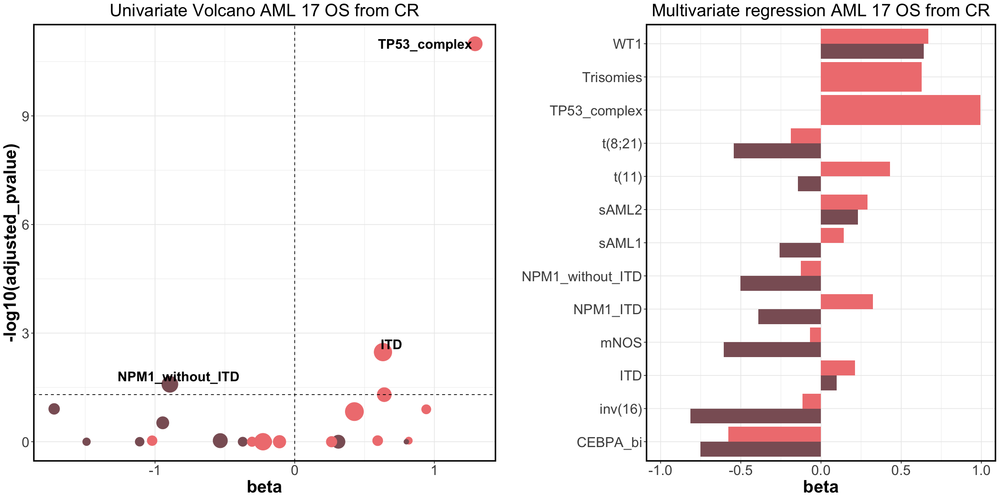

In [71]:
df <- data.frame(beta = double(),pvalue = double(),Frequency = double() )
data <- read.table("data/aml17_mrd_prepared.tsv")
data$RelapseStatus <- ifelse(data$RelapseCIStatus==1,1,0)

for (col in c(princ_comps_bis,"ITD")){
    data[,paste(col,"MRDneg",sep="_")] <- data[,col]*data$CR_MRD_neg
    data[,paste(col,"MRDpos",sep="_")] <- data[,col]*data$CR_MRD_pos
}  

data$NPM1_ITD_MRDneg <- ifelse(data$principal_component_NPM1_MRDneg==1 & data$ITD_MRDneg==1,1,0)
data$NPM1_ITD_MRDpos <- ifelse(data$principal_component_NPM1_MRDpos==1 & data$ITD_MRDpos==1,1,0)
data$NPM1_without_ITD_MRDneg <- ifelse(data$principal_component_NPM1_MRDneg==1 & data$ITD_MRDneg==0,1,0)
data$NPM1_without_ITD_MRDpos <- ifelse(data$principal_component_NPM1_MRDpos==1 & data$ITD_MRDpos==0,1,0)

data$principal_component_NPM1_MRDneg <- NULL
data$principal_component_NPM1_MRDpos <- NULL
cols_to_keep <- c()
for (col in c(colnames(data)[grep(pattern="MRDneg",colnames(data))],colnames(data)[grep(pattern="MRDpos",colnames(data))])){
    if(nrow(data[data[,col]==1,])>3){
        cols_to_keep <- c(cols_to_keep,col)
    }
}

########### First Panel : Univariate Plot

for (col in cols_to_keep){
    fit <- coxph(as.formula(paste("Surv(OS_CR,DiedYN) ~ ",
                       col)), data = data)

    df[col,1:3] <- c(summary(fit)$coef[1],summary(fit)$sctest[["pvalue"]],100*sum(data[,col])/dim(data)[1])                 
     }
df[,"adjusted_pvalue"] <- p.adjust(df$pvalue)
df[,"-log10(adjusted_pvalue)"] <- -log(p.adjust(df$pvalue),10)
df["names"] <- rownames(df)
df$Model <- ifelse(df$names %in% mrd, "mrd",
                    ifelse(df$names %in% c(clin,demo), "clin","comp"))
    
df$names <- ifelse(df$names=="principal_component_inv_16_MRDneg","inv(16)_MRDneg",
            ifelse(df$names=="principal_component_inv_16_MRDpos","inv(16)_MRDpos",
                   ifelse(df$names=="principal_component_inv_3_MRDneg","inv(3)_MRDneg",
                   ifelse(df$names=="principal_component_inv_3_MRDpos","inv(3)_MRDpos",
                          ifelse(df$names=="principal_component_t_11_MRDneg","t(11)_MRDneg",
                          ifelse(df$names=="principal_component_t_11_MRDpos","t(11)_MRDpos",
                                 ifelse(df$names=="principal_component_t_15_17_MRDneg","t(15;17)_MRDneg",
                                 ifelse(df$names=="principal_component_t_15_17_MRDpos","t(15;17)_MRDpos",
                                        ifelse(df$names=="principal_component_t_6_9_MRDneg","t(6;9)_MRDneg",
                                        ifelse(df$names=="principal_component_t_6_9_MRDpos","t(6;9)_MRDpos",
                                               ifelse(df$names=="principal_component_t_8_21_MRDneg","t(8;21)_MRDneg",
                                               ifelse(df$names=="principal_component_t_8_21_MRDpos","t(8;21)_MRDpos",
                                                                         str_remove(df$names,"principal_component_")))))))))))))

df$Model <- ifelse(grepl("MRDpos",df$names), "mrdpos",
                   ifelse(grepl("MRDneg",df$names), "mrdneg","comp"))

df$Frequency <- ifelse(df$names %in% clin, 5,
                              ifelse(df$names %in% demo, 5, df$Frequency))

df$names <- str_remove(str_remove(df$names,"_MRDpos"),"_MRDneg")

df <- df[order(df$adjusted_pvalue),]

univariate_MRD_OS_plot <- ggplot(df, aes(beta, -log10(adjusted_pvalue)))+
                          theme_bw()+
                          theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                          axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                          panel.border = element_rect(colour = "black", fill=NA, size=2),
                          legend.position="none")+
                          geom_vline(xintercept=0,linetype="dashed")+
                          geom_point(aes(size=Frequency,col=Model))+
                          geom_text_repel(data=df[(df["adjusted_pvalue"]<0.05) ,], aes(label=names,fontface=2,size=3))+scale_size_continuous(range = c(3,12))+ 
                          scale_color_manual(values=colors_analysis,limits=names(colors_analysis))+
                          geom_hline(yintercept=-log(0.05,10),linetype="dashed")+
                          ggtitle("Univariate Volcano AML 17 OS from CR")



########### Second Panel : Multivariate Plot

df_multi <- NULL
i <- 1
iterations <- 100
for (i in c(1:iterations)){
    res1 <- cv.glmnet(data.matrix(data[,cols_to_keep]),
                      Surv(data$OS_CR,data$DiedYN), family="cox",alpha=0,nfolds=10)
    df_multi <- cbind(df_multi,as.matrix(coef(res1,s="lambda.min")))
    i <- i+1
    }

l <- data.frame(coef = rowSums(df_multi)/iterations)
l$names <- rownames(l)

l$names <- ifelse(l$names=="principal_component_inv_16_MRDneg","inv(16)_MRDneg",
            ifelse(l$names=="principal_component_inv_16_MRDpos","inv(16)_MRDpos",
                   ifelse(l$names=="principal_component_inv_3_MRDneg","inv(3)_MRDneg",
                   ifelse(l$names=="principal_component_inv_3_MRDpos","inv(3)_MRDpos",
                          ifelse(l$names=="principal_component_t_11_MRDneg","t(11)_MRDneg",
                          ifelse(l$names=="principal_component_t_11_MRDpos","t(11)_MRDpos",
                                 ifelse(l$names=="principal_component_t_15_17_MRDneg","t(15;17)_MRDneg",
                                 ifelse(l$names=="principal_component_t_15_17_MRDpos","t(15;17)_MRDpos",
                                        ifelse(l$names=="principal_component_t_6_9_MRDneg","t(6;9)_MRDneg",
                                        ifelse(l$names=="principal_component_t_6_9_MRDpos","t(6;9)_MRDpos",
                                               ifelse(l$names=="principal_component_t_8_21_MRDneg","t(8;21)_MRDneg",
                                               ifelse(l$names=="principal_component_t_8_21_MRDpos","t(8;21)_MRDpos",
                                                                         str_remove(l$names,"principal_component_")))))))))))))
l$abs_coef <- abs(l$coef)

l$Model <- ifelse(grepl("MRDpos",l$names), "mrdpos",
                   ifelse(grepl("MRDneg",l$names), "mrdneg","comp"))

l$names <- str_remove(str_remove(l$names,"_MRDpos"),"_MRDneg")

multivariate_MRD_OS_plot <- ggplot(l[l$coef!=0,],aes(x=reorder(names,names),y=coef,fill=Model))+
                            geom_bar(stat="identity",position="dodge")+
                            coord_flip()+
                            theme_bw()+
                            theme(plot.title = element_text(hjust = 0.5,size=25),axis.text=element_text(size=20),
                                  axis.title=element_text(size=25,face="bold",vjust=0.5,hjust=0.5),
                                  panel.border = element_rect(colour = "black", fill=NA, size=2),
                                  legend.position="none")+
                            scale_fill_manual(values=colors_analysis,limits=names(colors_analysis))+
                            xlab("")+
                            ylab("beta")+
                            ylim(-max(abs(l$coef)),max(abs(l$coef)))+
                            ggtitle("Multivariate regression AML 17 OS from CR")

# Plots
set_notebook_plot_size(20,10)
do.call("grid.arrange",list(univariate_MRD_OS_plot,multivariate_MRD_OS_plot,nrow=1))


# **S. Figure 44: Kaplan-Meier overall survival curves and associated risk tables comparing patients who have been transplanted in CR1 to patients transplanted in CR2 for the selected classes.**

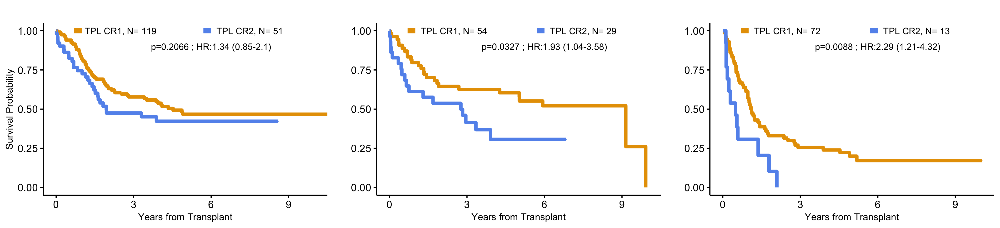

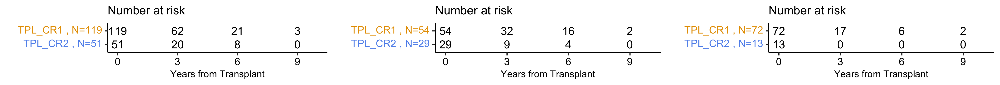

In [72]:
data_both_transplant <- read.table("data/data_both_transplant.tsv")

p <- list()
risk_tab <- list()
i <- 1

for (co in c('principal_component_sAML2','principal_component_sAML1','principal_component_TP53_complex')){
   
    df_TPL <- data_both_transplant[data_both_transplant[,co]==1 & (data_both_transplant$TPL_CR1_stat==1 | data_both_transplant$TPL_CR2_stat==1)  ,]
    
    title <- str_remove(co,"principal_component_")
    
    df_TPL$comparison <- ifelse(df_TPL$TPL_CR1_stat==1,"TPL_CR1",ifelse(df_TPL$TPL_CR2_stat==1,"TPL_CR2","No_TPL"))
    df_TPL$Surv <- ifelse(df_TPL$comparison!="No_TPL",df_TPL$OS-df_TPL$TPL_date,df_TPL$OS-df_TPL$CR)
    surv_object <- Surv(time = df_TPL$Surv, event = df_TPL$OS_stat)
    fit <- survfit(surv_object ~ comparison, data = df_TPL)
    
    ## Add Pval and HR CI
    res <- get_pvalue_and_HR(Surv(Surv,OS_stat)~comparison,data = df_TPL)
    
    # Surv Plots and Risk Tables
    surv <- plot_surv_curves(fit,pval.coord = c(4,0.8),legend="none",
                                   vals=c("#E79F00","#6495ED"),x="Years from Transplant",font.legend=20,font.tile=16,
                                   y=ifelse(i%%3==1,"Survival Probability",""),xlim=c(0,10),break.x.by=3,ylim=c(0,1),pval=F,risk.tab=T)
    p[[title]] <- surv$plot+
                  annotate(geom="text", x=6 , y=0.9, label=res,size=8,color="black") +
                  annotate("segment", x = c(0.7,5.7), xend = c(1,6), y = c(1,1), yend = c(1,1),size=6,colour = c("#E79F00","#6495ED")) + 
                  annotate(geom="text", x=c(2.5,7.5) , y=c(1,1), label=c(paste("TPL CR1, N=",nrow(df_TPL[df_TPL$comparison=="TPL_CR1",])),
                                                             paste("TPL CR2, N=",nrow(df_TPL[df_TPL$comparison=="TPL_CR2",]))),size=8)
    risk_tab[[title]] <- surv$table
    
    i <- i+1
}

set_notebook_plot_size(35,8)
grid.arrange(p[[1]],p[[2]],p[[3]],ncol=3)
set_notebook_plot_size(35,3)
grid.arrange(risk_tab[[1]],risk_tab[[2]],risk_tab[[3]],ncol=3)

# **S. Figure 45: Kaplan-Meier curves for overall survival and associated risk table comparing patients with t(6;9) with and without ITD with patients in intermediate and adverse ELN 2017 on the combined.**

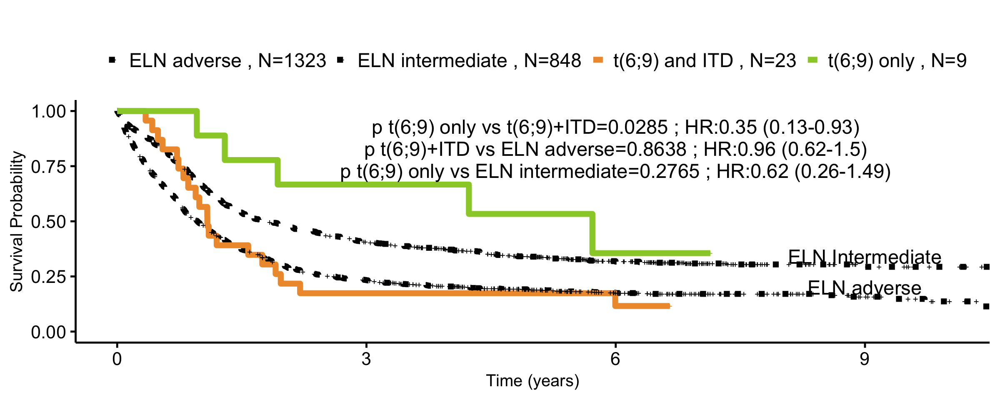

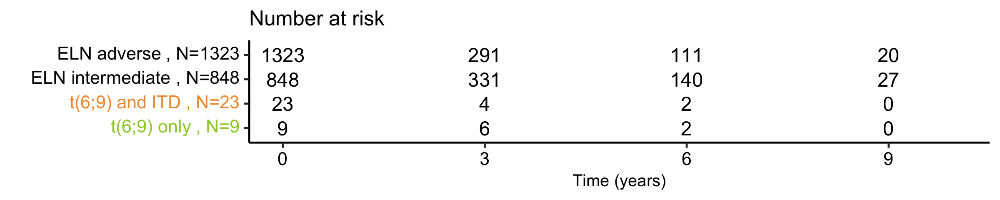

In [73]:
############## Get Training Cohort data

# Training Cohort t(6;9) data
df_training_t_6_9 <- df_final_bis[df_final_bis$t_6_9==1,]
df_training_t_6_9$comparison <- ifelse(df_training_t_6_9$ITD==1,"t(6;9) and ITD","t(6;9) only")

# Training Cohort ELN data
df_eln <- df_final_bis[df_final_bis$eln_2017_intermediate==1 | df_final_bis$eln_2017_adverse==1,]
df_eln$comparison <- ifelse(df_eln$eln_2017_intermediate==1 ,"ELN intermediate","ELN adverse")

# Training Cohort combined data
df_training_combined <- rbind(df_training_t_6_9,df_eln)

############## Get Validation Cohort data

# Validation Cohort t(6;9) data
df_validation_t_6_9 <- df_validation_bis[df_validation_bis$t_6_9==1,]
df_validation_t_6_9$comparison <- ifelse(df_validation_t_6_9$ITD==1,"t(6;9) and ITD","t(6;9) only")

# Validation Cohort ELN data
df_eln <- df_validation_bis[df_validation_bis$eln_2017_intermediate==1 | df_validation_bis$eln_2017_adverse==1,]
df_eln$comparison <- ifelse(df_eln$eln_2017_intermediate==1 ,"ELN intermediate","ELN adverse")

# Validation Cohort combined data
df_validation_combined <- rbind(df_validation_t_6_9,df_eln)
df_validation_combined$os <- df_validation_combined$OS
df_validation_combined$os_status <- df_validation_combined$OS_Status

# Merge Training and Validation Cohorts data
df_merged_cohorts <- rbind(df_training_combined[,c('comparison','os','os_status')],df_validation_combined[,c('comparison','os','os_status')])

# Surv
surv_object_final <- Surv(time = df_merged_cohorts$os, event = df_merged_cohorts$os_status)
fit_final <- survfit(surv_object_final ~ comparison, data = df_merged_cohorts)

# Get pvalues and HR :
tmp <- df_merged_cohorts[df_merged_cohorts$comparison %in% c("t(6;9) and ITD","t(6;9) only"),]
res <- get_pvalue_and_HR(Surv(os,os_status)~comparison,data = tmp,text="p t(6;9) only vs t(6;9)+ITD")

tmp1 <- df_merged_cohorts[df_merged_cohorts$comparison %in% c("t(6;9) and ITD","ELN adverse"),]
res1 <- get_pvalue_and_HR(Surv(os,os_status)~comparison,data = tmp1,text="p t(6;9)+ITD vs ELN adverse")

tmp2 <- df_merged_cohorts[df_merged_cohorts$comparison %in% c("t(6;9) only","ELN intermediate"),]
res2 <- get_pvalue_and_HR(Surv(os,os_status)~comparison,data = tmp2,text="p t(6;9) only vs ELN intermediate")

# Surv Plot and Riks Table
surv <- plot_surv_curves(fit_final,submain="",vals =c("grey0","grey1","#EE9937","olivedrab3"),y="Survival Probability",
                      pval="",xlim=c(0,10),break.x.by=3,linetype=c(3,3,1,1,1),risk.tab=T)

set_notebook_plot_size(20,8) 
surv_plot <- surv$plot+
             annotate("text", x = rep(6,3),y = c(0.93,0.83,0.73), label = c(res,res1,res2),size=10)+
             theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))+
             annotate("text", label=c("ELN Intermediate","ELN adverse"),x=c(9,9),y=c(0.34,0.2),size=10)
surv_plot                        

set_notebook_plot_size(20,4)                          
surv_table <- surv$table
surv_table


# **S.Figure 46: Kaplan-Meier overall survival curves and associated risk tables comparing each of the proposed risk strata (FavorableP, IntermediateP,AdverseP).**

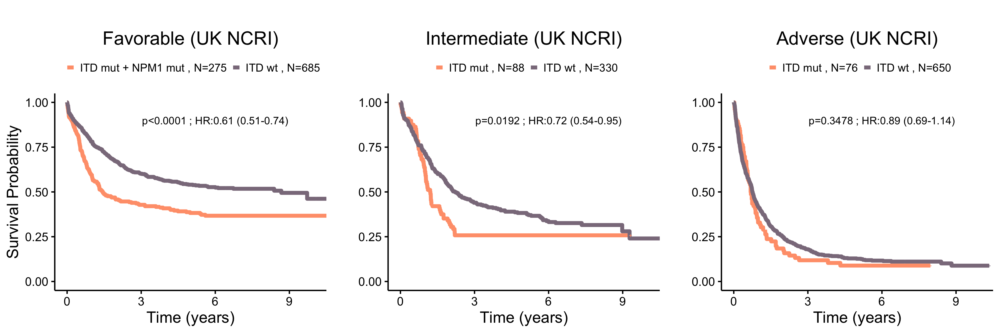

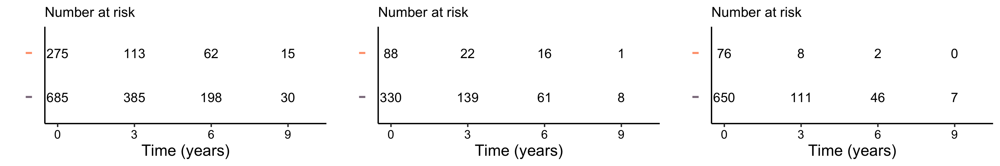

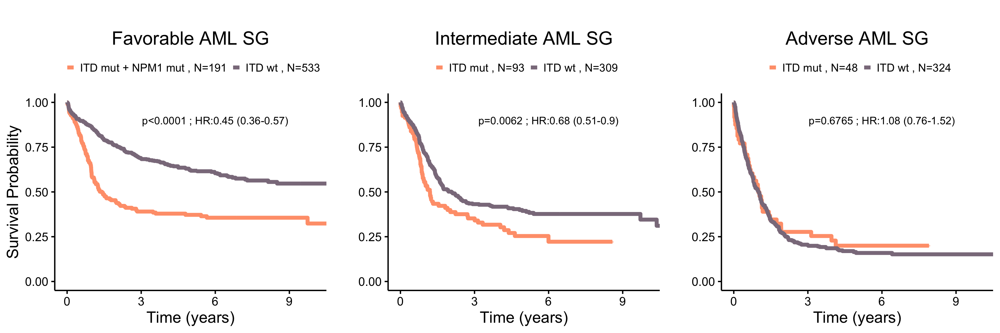

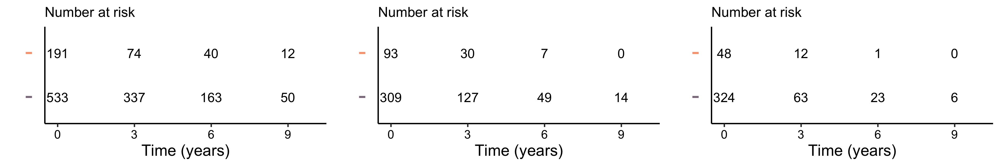

In [74]:
# Training Plots
df_final_with_molecular_classification_without_ITD_shift <- molecular_proposal_classification_without_ITD_shift(df_final_bis)
plist_training <- list()
risk_tab_training <- list()
for (risk_strat in c("favorable","intermediate","adverse")){
    tmp <- df_final_with_molecular_classification_without_ITD_shift[df_final_with_molecular_classification_without_ITD_shift$molecular_classification==risk_strat,]
    if(risk_strat=="favorable"){
        tmp$comparison <-ifelse(tmp$principal_component_NPM1==1 & tmp$ITD==1,"ITD mut + NPM1 mut",ifelse(tmp$ITD==0,"ITD wt","others"))
        tmp <- tmp[tmp$comparison!="others",]
    }else{
        tmp$comparison <-ifelse(tmp$ITD==1,"ITD mut","ITD wt")
    }
    surv_object <- Surv(time = tmp$os, event = tmp$os_status)
    fit <- survfit(surv_object ~ comparison, data = tmp)
     
    # Add pval HR and CI
    res <- get_pvalue_and_HR(Surv(os,os_status)~comparison,data = tmp)
    
    plist_training[[risk_strat]] <- plot_surv_curves(fit,font.legend = 24,y=ifelse(risk_strat=="favorable","Survival Probability",""),xlim=c(0,10),break.x.by=3,
                                                    font.submain=40,submain = "",vals=c("#FFA07A","#8B7B8B"),pval=F,font.x=34,font.y=34)$plot + 
                                            theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+ggtitle(paste(str_to_title(risk_strat),"(UK NCRI)"))+
                                             annotate(geom="text", x=6 , y=0.9, label=res,size=8,color="black") 
    
    risk_tab_training[[risk_strat]] <- plot_surv_curves(fit,font.legend = 24,y=ifelse(risk_strat=="favorable","Survival Probability",""),xlim=c(0,10),break.x.by=3,
                                                    font.submain=40,submain = "",vals=c("#FFA07A","#8B7B8B"),pval=F,font.x=34,font.y=34,risk.tab=T,risk.table.y.text=0)$table
}

# Validation Plots
df_validation_with_molecular_classification_without_ITD_shift <- molecular_proposal_classification_without_ITD_shift(df_validation_bis)
plist_validation <- list()
risk_tab_validation <- list()
for (risk_strat in c("favorable","intermediate","adverse")){
    tmp <- df_validation_with_molecular_classification_without_ITD_shift[df_validation_with_molecular_classification_without_ITD_shift$molecular_classification==risk_strat,]
    if(risk_strat=="favorable"){
        tmp$comparison <-ifelse(tmp$principal_component_NPM1==1 & tmp$ITD==1,"ITD mut + NPM1 mut",ifelse(tmp$ITD==0,"ITD wt","others"))
        tmp <- tmp[tmp$comparison!="others",]
    }else{
        tmp$comparison <-ifelse(tmp$ITD==1,"ITD mut","ITD wt")
    }

    surv_object <- Surv(time = tmp$OS, event = tmp$OS_Status)
    fit <- survfit(surv_object ~ comparison, data = tmp)
  
    # Add pval HR and CI
    res <- get_pvalue_and_HR(Surv(OS,OS_Status)~comparison,data = tmp)
    
    
    plist_validation[[risk_strat]] <- plot_surv_curves(fit,font.legend = 24,y=ifelse(risk_strat=="favorable","Survival Probability",""),xlim=c(0,10),break.x.by=3,
                                                 font.submain=40,submain = "",vals=c("#FFA07A","#8B7B8B"),pval=F,font.x=34,font.y=34)$plot +
                                            theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+ggtitle(paste(str_to_title(risk_strat),"AML SG"))+
                                             annotate(geom="text", x=6 , y=0.9, label=res,size=8,color="black") 
    risk_tab_validation[[risk_strat]] <- plot_surv_curves(fit,font.legend = 24,y=ifelse(risk_strat=="favorable","Survival Probability",""),xlim=c(0,10),break.x.by=3,
                                                    font.submain=40,submain = "",vals=c("#FFA07A","#8B7B8B"),pval=F,font.x=34,font.y=34,risk.tab=T,risk.table.y.text=0)$table
}

# Plots
set_notebook_plot_size(30,10)
do.call("grid.arrange",c(plist_training,nrow=1))
set_notebook_plot_size(30,5)
do.call("grid.arrange",c(risk_tab_training,nrow=1))
set_notebook_plot_size(30,10)
do.call("grid.arrange",c(plist_validation,nrow=1))
set_notebook_plot_size(30,5)
do.call("grid.arrange",c(risk_tab_validation,nrow=1))


# **S.Figure 47: Kaplan-Meier curves for overall survival and associated risk tables comparing ITD clinical ratio for all ITD mutated patients and for the subset of patients with both NPM1 and ITD mutations on the AML NCRI cohort (n=2,113).**

## ***A. Kaplan-Meier curves for overall survival comparing ITD ratio (low is less than 50 and high is more than 50) for ITD mutated patients on the AML NCRI cohort (n=2,113).***

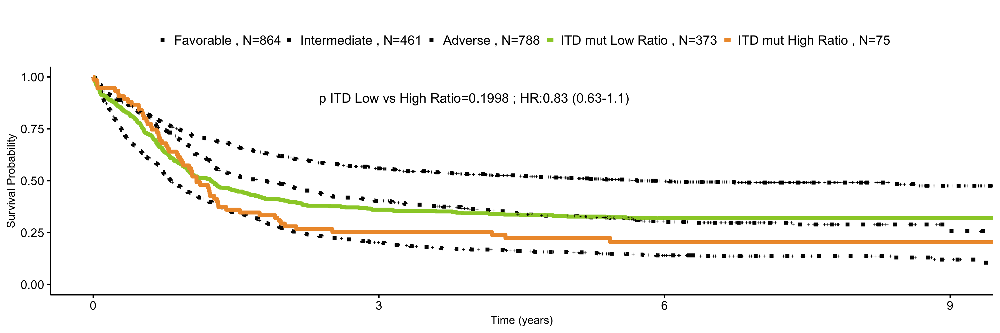

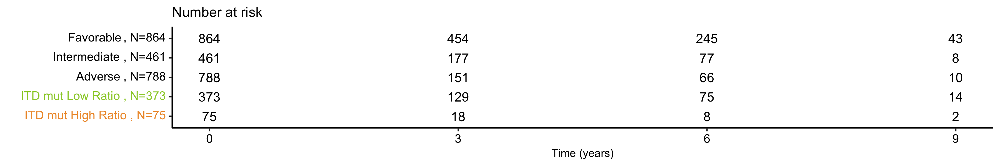

In [75]:
# Prepare data
df_final_clin_ratio <- read.table("data/eln_classification_clin_ratio_interpol.tsv")
df_final_clin_ratio <- merge(df_final,df_final_clin_ratio,by=0)
df_final_clin_ratio$comparison <- ifelse(df_final_clin_ratio$Clin_Ratio<50,"Low","High")
df_eln_comparison <- df_final_clin_ratio
df_eln_comparison$comparison <- ifelse(df_eln_comparison$eln_2017_favorable==1,"Favorable",
                                       ifelse(df_eln_comparison$eln_2017_intermediate==1 ,"Intermediate","Adverse"))
df_ITD_ratio_comparison <- df_final_clin_ratio[df_final_clin_ratio$ITD==1,]
df_ITD_ratio_comparison$comparison <- ifelse(df_ITD_ratio_comparison$comparison=="Low","ITD mut Low Ratio","ITD mut High Ratio")
df_final_comparison <- rbind(df_eln_comparison,df_ITD_ratio_comparison)
df_final_comparison$comparison <- factor(df_final_comparison$comparison,levels=c("Favorable","Intermediate","Adverse",
                                                                                   "ITD mut Low Ratio","ITD mut High Ratio"))

# Surv
surv_object_final <- Surv(time = df_final_comparison$os, event = df_final_comparison$os_status)
fit_final <- survfit(surv_object_final ~ comparison, data = df_final_comparison)

# Get pvalue and HR
tmp <- df_final_comparison[df_final_comparison$comparison %in% c("ITD mut Low Ratio","ITD mut High Ratio"),]
tmp$comparison <- factor(tmp$comparison,levels=c("ITD mut High Ratio","ITD mut Low Ratio"))
res <- get_pvalue_and_HR(Surv(os,os_status)~comparison,
                         data = tmp,text="p ITD Low vs High Ratio")

# Prepare surv plot and risk table
surv <- plot_surv_curves(fit_final,submain="",y="Survival Probability",
                    xlim=c(0,9),break.x.by=3,vals =c("grey0","grey1","grey2","olivedrab3","#EE9937"),
                    pval="",linetype=c(3,3,3,1,1),risk.tab=T)

surv_plot <- surv$plot+
             annotate("text", x = 4,y = 0.9, label = res,size=10)+
             theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))

risk_tab <- surv$table

set_notebook_plot_size(30,10)
surv_plot
set_notebook_plot_size(30,5)
risk_tab

## ***B. Kaplan-Meier curves for overall survival comparing ITD ratio (low is less than 50 and high is more than 50) for patients that have both NPM1 and ITD mutations on the AML NCRI cohort (n=2,113).***

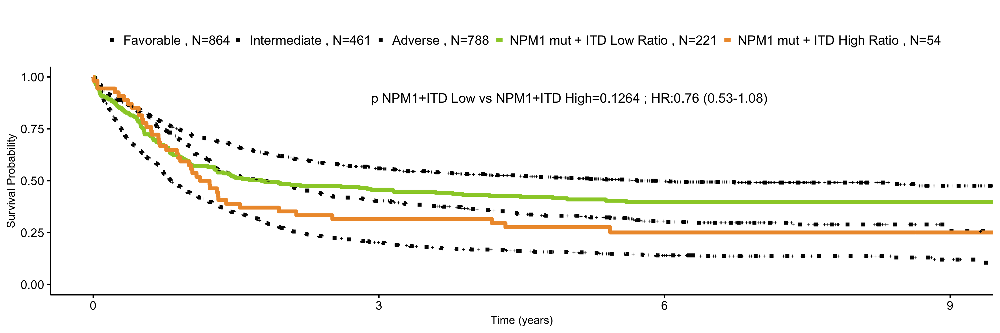

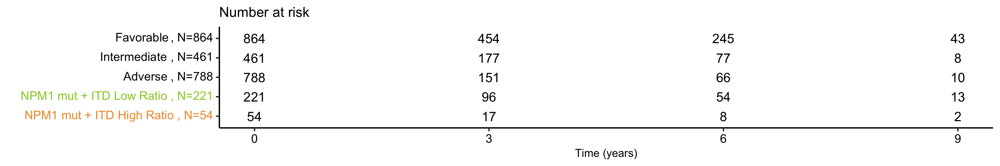

In [76]:
# Prepare data

df_final_clin_ratio <- read.table("data/eln_classification_clin_ratio_interpol.tsv")
df_final_clin_ratio <- merge(df_final,df_final_clin_ratio,by=0)
df_final_clin_ratio$comparison <- ifelse(df_final_clin_ratio$Clin_Ratio<50,"Low","High")
df_eln_comparison <- df_final_clin_ratio
df_eln_comparison$comparison <- ifelse(df_eln_comparison$eln_2017_favorable==1,"Favorable",
                                       ifelse(df_eln_comparison$eln_2017_intermediate==1 ,"Intermediate","Adverse"))

df_NPM1_ITD_mut_comparison <- df_final_clin_ratio[df_final_clin_ratio$NPM1==1 & df_final_clin_ratio$ITD==1,]
df_NPM1_ITD_mut_comparison$comparison <- ifelse(df_NPM1_ITD_mut_comparison$comparison=="Low","NPM1 mut + ITD Low Ratio","NPM1 mut + ITD High Ratio")

df_final_comparison <- rbind(df_eln_comparison,df_NPM1_ITD_mut_comparison)
df_final_comparison$comparison <- factor(df_final_comparison$comparison,levels=c("Favorable","Intermediate","Adverse","NPM1 mut + ITD Low Ratio",
                                                                                 "NPM1 mut + ITD High Ratio"))

# Surv
surv_object_final <- Surv(time = df_final_comparison$os, event = df_final_comparison$os_status)
fit_final <- survfit(surv_object_final ~ comparison, data = df_final_comparison)

# Get pvalue and HR
tmp <- df_final_comparison[df_final_comparison$comparison %in% c("NPM1 mut + ITD Low Ratio","NPM1 mut + ITD High Ratio"),]
tmp$comparison <- factor(tmp$comparison,levels=c("NPM1 mut + ITD High Ratio","NPM1 mut + ITD Low Ratio"))
res <- get_pvalue_and_HR(Surv(os,os_status)~comparison,
                         data = tmp,text="p NPM1+ITD Low vs NPM1+ITD High")

# Prepare surv plot and risk table
surv <- plot_surv_curves(fit_final,submain="",y="Survival Probability",
                    xlim=c(0,9),break.x.by=3,vals =c("grey0","grey1","grey2","olivedrab3","#EE9937","#BFBFBF"),
                    pval="",linetype=c(3,3,3,1,1,1),risk.tab=T)

surv_plot <- surv$plot+
             annotate("text", x = 5,y = 0.9, label = res,size=10)+
             theme(plot.title = element_text(hjust = 0.5,size=30,vjust=-5))

risk_tab <- surv$table

set_notebook_plot_size(30,10)
surv_plot
set_notebook_plot_size(30,5)
risk_tab
 

# **S. Figure 48: Comparison of ELN 2017 and new risk proposal in the training AML NCRI (n=2,113) and validation AML SG Cohort (n=1,540).**

## ***A1. Top panel : Bar plots of frequencies of ELN2017 risk categories stratified by proposal categories in the training (n=2,113) and validation cohort (n=1,540).***
## ***A2.Bottom panel : Bar plots of frequencies of proposal risk categories stratified by ELN2017 categories in the training (n=2,113) and validation cohort(n=1,540).***

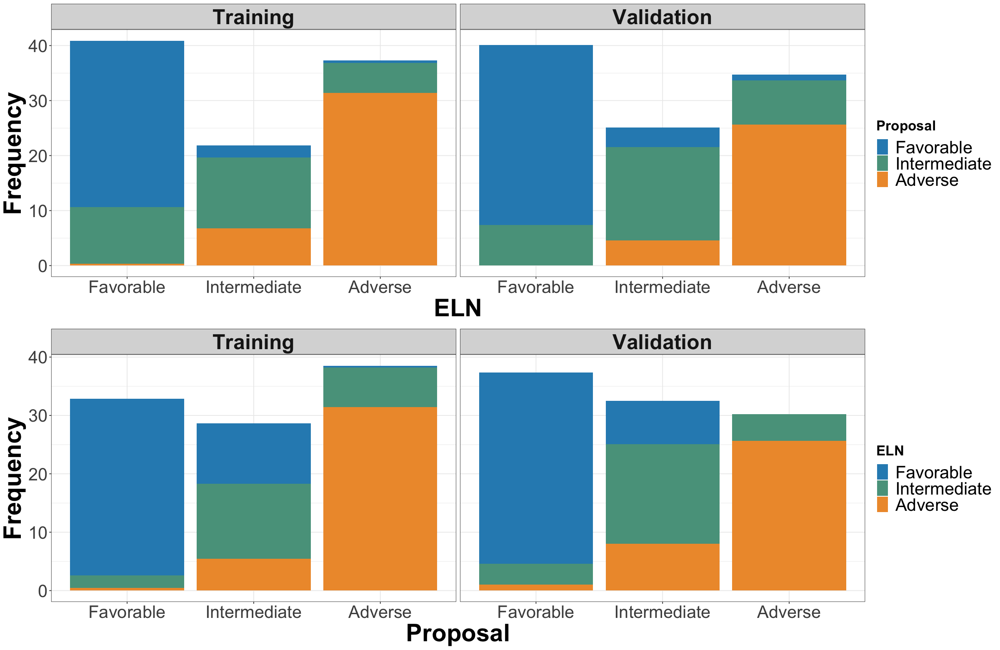

In [77]:
# 1. Prepare Training Barplot data
df_final_molecular_classification <- molecular_proposal_classification(df_final_bis)

tmp_training <- data.frame(table(df_final_molecular_classification$eln_2017,df_final_molecular_classification$molecular_classification))
tmp_training$Freq <- 100*tmp_training$Freq/nrow(df_final_molecular_classification)
tmp_training$ELN <- ifelse(tmp_training$Var1==1, "Adverse",
                              ifelse(tmp_training$Var1==2, "Intermediate","Favorable"))
tmp_training$ELN <- factor(tmp_training$ELN,levels=c("Favorable","Intermediate","Adverse"))
tmp_training$Proposal <- ifelse(tmp_training$Var2=="NEW_adverse", "Adverse",
                              ifelse(tmp_training$Var2=="NEW_intermediate", "Intermediate","Favorable"))
tmp_training$Proposal <- factor(tmp_training$Proposal,levels=c("Favorable","Intermediate","Adverse"))
tmp_training$data <- "Training"


# 1. Prepare Validation Barplot data
df_validation_molecular_classification <- molecular_proposal_classification(df_validation_bis)

tmp_validation <- data.frame(table(df_validation_molecular_classification$eln_2017,df_validation_molecular_classification$molecular_classification))
tmp_validation$Freq <- 100*tmp_validation$Freq/nrow(df_validation_molecular_classification)
tmp_validation$ELN <- ifelse(tmp_validation$Var1=="adverse", "Adverse",
                              ifelse(tmp_validation$Var1=="intermediate", "Intermediate","Favorable"))
tmp_validation$ELN <- factor(tmp_validation$ELN,levels=c("Favorable","Intermediate","Adverse"))
tmp_validation$Proposal <- ifelse(tmp_validation$Var2=="NEW_adverse", "Adverse",
                              ifelse(tmp_validation$Var2=="NEW_intermediate", "Intermediate","Favorable"))
tmp_validation$Proposal <- factor(tmp_validation$Proposal,levels=c("Favorable","Intermediate","Adverse"))

tmp_validation$data <- "Validation"

# Combine Training and Validation Barplot data
data_comparison <- rbind(tmp_training,tmp_validation)

# Prepare ELN and Proposal Barplot (as x-axis)
plot_ELN_x <- ggplot(data_comparison,aes(x=ELN,y=Freq,fill=Proposal))+geom_bar(stat="identity")+theme_bw()+ylab("Frequency")+facet_wrap(~data)+
scale_fill_manual(values=c("#2b8cbe","#59A08B","#EE9937"))+
theme(axis.text=element_text(size=25),axis.title=element_text(size=35,face="bold"),strip.text=element_text(size=30,face="bold"),
      legend.text=element_text(size=25),legend.title=element_text(size=20,face="bold"))
plot_Proposal_x <- ggplot(data_comparison,aes(x=Proposal,y=Freq,fill=ELN))+geom_bar(stat="identity")+theme_bw()+ylab("Frequency")+facet_wrap(~data)+
scale_fill_manual(values=c("#2b8cbe","#59A08B","#EE9937"))+
theme(axis.text=element_text(size=25),axis.title=element_text(size=35,face="bold"),strip.text=element_text(size=30,face="bold"),
      legend.text=element_text(size=25),legend.title=element_text(size=20,face="bold"))

set_notebook_plot_size(20,13)
grid.arrange(plot_ELN_x,plot_Proposal_x,nrow=2)

# png("figures/Supp_Figures/Comparison of ELN and new risk proposal in the training  validation/eln_risk_proposal_repartition_frequency_WITH_clin_ratio.png",width=6000,height=4000,res=300)
# grid.arrange(plot_ELN_x,plot_Proposal_x,nrow=2)
# dev.off()

## ***B. Kaplan-Meier curves for overall survival comparing the ELN2017 risk categories and the new risk proposal categories in the training (n=2,113) and validation cohort (n=1,540).***

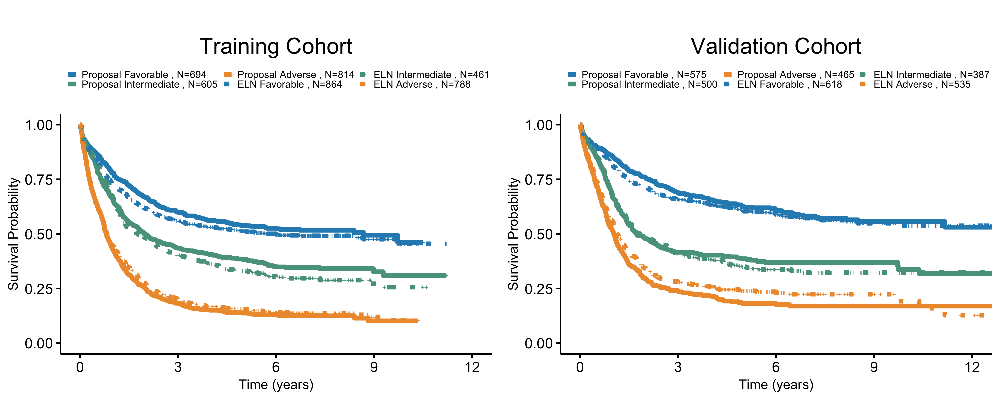

In [78]:
# 1. Training Cohort

# a. Proposal
df_training_proposal <- molecular_proposal_classification(df_final_bis)
df_training_proposal$comparison <- str_to_title(str_replace(df_training_proposal$molecular_classification,"NEW_","Proposal "))
df_training_proposal$comparison <- factor(df_training_proposal$comparison,levels=c("Proposal Favorable","Proposal Intermediate","Proposal Adverse"))

#b. ELN
df_training_eln <- df_final_bis
df_training_eln$comparison <- ifelse(df_training_eln$eln_2017==1,"ELN Adverse",
                          ifelse(df_training_eln$eln_2017==2,"ELN Intermediate","ELN Favorable"))
df_training_eln$comparison <- factor(df_training_eln$comparison,levels=c("ELN Favorable","ELN Intermediate","ELN Adverse"))
     
# Merge and Plot
df_training_RISK <- rbind(df_training_proposal[,c("comparison","os","os_status")],df_training_eln[,c("comparison","os","os_status")])
surv_object <- Surv(time = df_training_RISK$os, event = df_training_RISK$os_status)
fit <- survfit(surv_object ~ comparison, data = df_training_RISK)
surv_training_plot <- plot_surv_curves(fit,risk.tab = T,pval=F,linetype=c(1,1,1,3,3,3),
                                       font.legend = 18,y="Survival Probability",submain = "",xlim=c(0,12),break.x.by=3,
                                       vals=c("#2b8cbe","#59A08B","#EE9937","#2b8cbf","#59A08C","#EE9939"))$plot+
                      theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+
                      ggtitle("Training Cohort")


# 2. Validation Cohort

# a. Proposal
df_validation_proposal <- molecular_proposal_classification(df_validation_bis)
df_validation_proposal$comparison <- str_to_title(str_replace(df_validation_proposal$molecular_classification,"NEW_","Proposal "))
df_validation_proposal$comparison <- factor(df_validation_proposal$comparison,levels=c("Proposal Favorable","Proposal Intermediate","Proposal Adverse"))

#b. ELN
df_validation_eln <- df_validation_bis
df_validation_eln$comparison <- ifelse(df_validation_eln$eln_2017_adverse==1,"ELN Adverse",
                          ifelse(df_validation_eln$eln_2017_intermediate==1,"ELN Intermediate","ELN Favorable"))
df_validation_eln$comparison <- factor(df_validation_eln$comparison,levels=c("ELN Favorable","ELN Intermediate","ELN Adverse"))
     
# Merge and Plot
df_validation_RISK <- rbind(df_validation_proposal[,c("comparison","OS","OS_Status")],df_validation_eln[,c("comparison","OS","OS_Status")])
surv_object <- Surv(time = df_validation_RISK$OS, event = df_validation_RISK$OS_Status)
fit <- survfit(surv_object ~ comparison, data = df_validation_RISK)
surv_validation_plot <- plot_surv_curves(fit,risk.tab = T,pval=F,linetype=c(1,1,1,3,3,3),
                                       font.legend = 18,y="Survival Probability",submain = "",xlim=c(0,12),break.x.by=3,
                                       vals=c("#2b8cbe","#59A08B","#EE9937","#2b8cbf","#59A08C","#EE9939"))$plot+
                      theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+
                      ggtitle("Validation Cohort")

# Surv Training and Validation Plots
set_notebook_plot_size(25,10)
grid.arrange(surv_training_plot,surv_validation_plot,nrow=1)


# **S. Figure 49: Sankey plot comparing the proportion of the ELN2017 risk groups shifting in the proposed risk groups in the AML NCRI cohort (n=2,113).**

In [79]:

df_final_classification <- molecular_proposal_classification(df_final_bis)


df_final_classification$molecular_classification_val <- ifelse(df_final_classification$molecular_classification=="NEW_favorable",3,
                                                              ifelse(df_final_classification$molecular_classification=="NEW_intermediate",4,5))

df_final_classification$eln_classification_val <- ifelse(df_final_classification$eln_2017_favorable==1,0,
                                                         ifelse(df_final_classification$eln_2017_intermediate==1,1,2))

list_val_mapping <- list()
count <- 1
for (i in c(0,1,2)){
    for (j in c(3,4,5)){
        list_val_mapping[count] <- nrow(df_final_classification[df_final_classification$eln_classification_val==i &
                                                                df_final_classification$molecular_classification_val==j,])
        count <- count+1
    }
}

nodes = data.frame("name" = c("ELN_Favorable", "ELN_Intermediate", "ELN_Adverse", "Proposal_Favorable", "Proposal_Intermediate", "Proposal_Adverse"))

## create edges with weights
links = as.data.frame(matrix(c(0, 3, list_val_mapping[[1]], 
                               0, 4, list_val_mapping[[2]], 
                               0, 5, list_val_mapping[[3]], 
                               1, 3, list_val_mapping[[4]], 
                               1, 4, list_val_mapping[[5]], 
                               1, 5, list_val_mapping[[6]],
                               2, 3, list_val_mapping[[7]], 
                               2, 4, list_val_mapping[[8]], 
                               2, 5, list_val_mapping[[9]]),
                               byrow = TRUE, ncol = 3))


## set column names for links
names(links) = c("source", "target", "value")

## add edge types for coloring purpose
links$group = c("type_0", 
                "type_1",
                "type_2",
                "type_3",
                "type_4",
                "type_5",
                "type_6",
                "type_7",
                "type_8")

## Create custom color list using d3 for each node
node_color <- 'd3.scaleOrdinal() .domain(["ELN_Favorable", "ELN_Intermediate", "ELN_Adverse","Proposal_Favorable", "Proposal_Intermediate", "Proposal_Adverse", 
"type_0","type_1","type_2","type_3","type_4","type_5","type_6","type_7","type_8"]).
range(["#2b8cbe","#59A08B","#EE9937","#2b8cbe","#59A08B","#EE9937","#2b8cbe","#59A08B","#EE9937","#2b8cbe","#59A08B","#EE9937","#2b8cbe","#59A08B","#EE9937"])'

## Draw Sankey Diagram
p <- sankeyNetwork(Links = links, Nodes = nodes,
 Source = "source", Target = "target",
 Value = "value", NodeID = "name",
 fontSize = 0, nodeWidth = 40,
 colourScale = node_color)

# HTML widget incompatible with Colab 

<img src='data/sankey_plot.png'>

# **S. Figure 50: Forest plot multivariate Cox regression of A. ELN2017 risk categories and B. risk proposal in NCRI trial study set (n= 2,113).**

## ***A. ELN Forest Plot.***

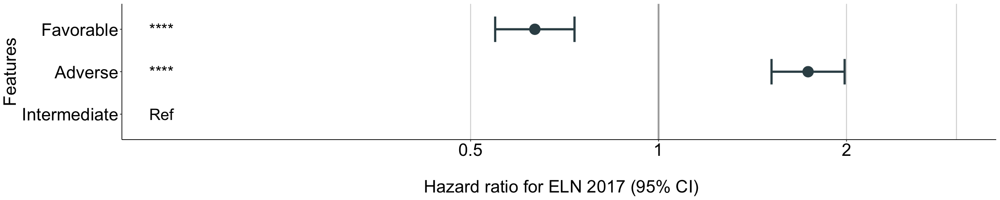

In [80]:
df_final_ELN <- df_final
df_final_ELN$Favorable <- ifelse(df_final_ELN$eln_2017_favorable==1,1,0)
df_final_ELN$Intermediate <- ifelse(df_final_ELN$eln_2017_intermediate==1,1,0)
df_final_ELN$Adverse <- ifelse(df_final_ELN$eln_2017_adverse==1,1,0)

fit <- coxph(Surv(os, os_status) ~ Favorable+Adverse+Intermediate, 
             data = df_final_ELN)

set_notebook_plot_size(20,4)
nice_forest_plot(fit=fit,data=df_final_ELN,colors=rep("#374E55FF",3),title="\n Hazard ratio for ELN 2017 (95% CI)")

## ***B. Proposal Forest Plot.***

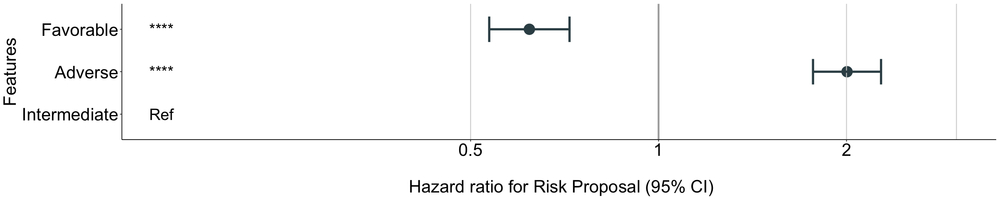

In [81]:
df_final_Proposal <- molecular_proposal_classification(df_final_bis)
df_final_Proposal$Favorable <- ifelse(df_final_Proposal$molecular_classification=="NEW_favorable",1,0)
df_final_Proposal$Intermediate <- ifelse(df_final_Proposal$molecular_classification=="NEW_intermediate",1,0)
df_final_Proposal$Adverse <- ifelse(df_final_Proposal$molecular_classification=="NEW_adverse",1,0)

fit <- coxph(Surv(os, os_status) ~ Favorable+Adverse+Intermediate, 
             data = df_final_Proposal)

set_notebook_plot_size(20,4)
nice_forest_plot(fit=fit,data=df_final_Proposal,colors=c(rep("#374E55FF",16)),title="\n Hazard ratio for Risk Proposal (95% CI)")

# **S. Figure 51: New risk proposal based on the AML classes on the subset of intensively treated patients in the AML NCRI cohort (n=1,755).**

## ***A. Kaplan-Meier overall survival curves comparing each of the proposed risk strata (FavorableP, IntermediateP, AdverseP) by FLT3ITD status for the training AML NCRI cohort for intensively treated patients (n=1,755) validate the rationale for the FLT3ITD shift in risk.***

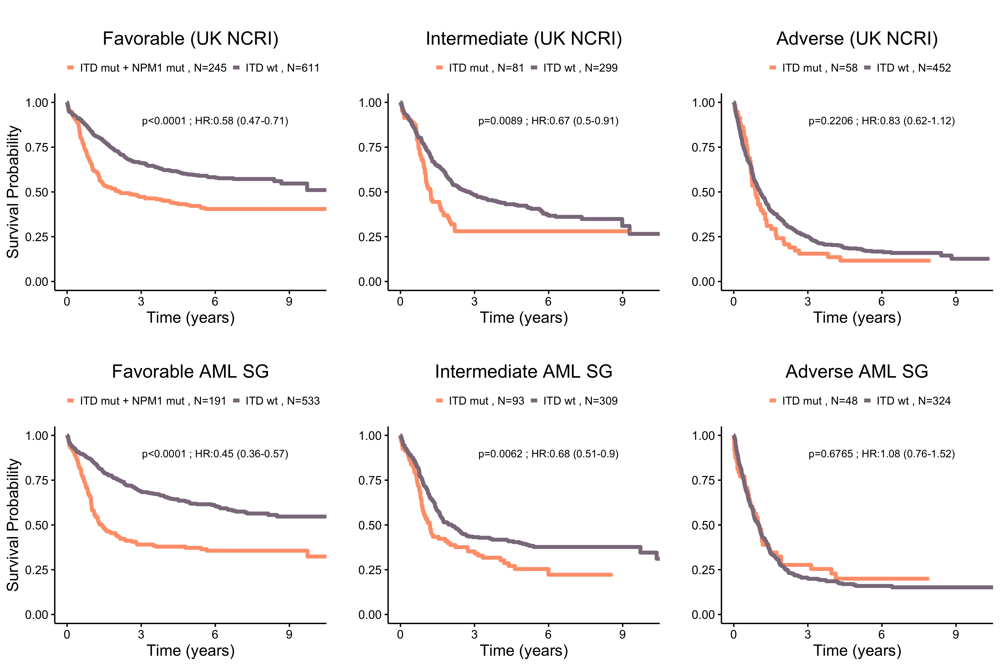

In [82]:
# Training Plots
list_intensively_treated <- readRDS("data/list_intensively_treated.rds")
df_final_with_molecular_classification_without_ITD_shift <- molecular_proposal_classification_without_ITD_shift(df_final_bis)
df_final_with_molecular_classification_without_ITD_shift_INTENSE <- df_final_with_molecular_classification_without_ITD_shift[rownames(df_final_with_molecular_classification_without_ITD_shift) %in% list_intensively_treated,]

plist_training <- list()
risk_tab_training <- list()
for (risk_strat in c("favorable","intermediate","adverse")){
    tmp <- df_final_with_molecular_classification_without_ITD_shift_INTENSE[df_final_with_molecular_classification_without_ITD_shift_INTENSE$molecular_classification==risk_strat,]
    if(risk_strat=="favorable"){
        tmp$comparison <-ifelse(tmp$principal_component_NPM1==1 & tmp$ITD==1,"ITD mut + NPM1 mut",ifelse(tmp$ITD==0,"ITD wt","others"))
        tmp <- tmp[tmp$comparison!="others",]
    }else{
        tmp$comparison <-ifelse(tmp$ITD==1,"ITD mut","ITD wt")
    }
    surv_object <- Surv(time = tmp$os, event = tmp$os_status)
    fit <- survfit(surv_object ~ comparison, data = tmp)
     
    # Add pval HR and CI
    res <- get_pvalue_and_HR(Surv(os,os_status)~comparison,data = tmp)
    
    plist_training[[risk_strat]] <- plot_surv_curves(fit,font.legend = 24,y=ifelse(risk_strat=="favorable","Survival Probability",""),xlim=c(0,10),break.x.by=3,
                                                    font.submain=40,submain = "",vals=c("#FFA07A","#8B7B8B"),pval=F,font.x=34,font.y=34)$plot + 
                                            theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+ggtitle(paste(str_to_title(risk_strat),"(UK NCRI)"))+
                                             annotate(geom="text", x=6 , y=0.9, label=res,size=8,color="black") 
}

# Validation Plots

df_validation_with_molecular_classification_without_ITD_shift <- molecular_proposal_classification_without_ITD_shift(df_validation_bis)
plist_validation <- list()
risk_tab_validation <- list()
for (risk_strat in c("favorable","intermediate","adverse")){
    tmp <- df_validation_with_molecular_classification_without_ITD_shift[df_validation_with_molecular_classification_without_ITD_shift$molecular_classification==risk_strat,]
    if(risk_strat=="favorable"){
        tmp$comparison <-ifelse(tmp$principal_component_NPM1==1 & tmp$ITD==1,"ITD mut + NPM1 mut",ifelse(tmp$ITD==0,"ITD wt","others"))
        tmp <- tmp[tmp$comparison!="others",]
    }else{
        tmp$comparison <-ifelse(tmp$ITD==1,"ITD mut","ITD wt")
    }

    surv_object <- Surv(time = tmp$OS, event = tmp$OS_Status)
    fit <- survfit(surv_object ~ comparison, data = tmp)
  
    # Add pval HR and CI
    res <- get_pvalue_and_HR(Surv(OS,OS_Status)~comparison,data = tmp)
    
    
    plist_validation[[risk_strat]] <- plot_surv_curves(fit,font.legend = 24,y=ifelse(risk_strat=="favorable","Survival Probability",""),xlim=c(0,10),break.x.by=3,
                                                 font.submain=40,submain = "",vals=c("#FFA07A","#8B7B8B"),pval=F,font.x=34,font.y=34)$plot +
                                            theme(plot.title = element_text(hjust = 0.5,size=40,vjust=-5))+ggtitle(paste(str_to_title(risk_strat),"AML SG"))+
                                             annotate(geom="text", x=6 , y=0.9, label=res,size=8,color="black") 
}

# Plots
set_notebook_plot_size(30,20)
do.call("grid.arrange",c(plist_training,plist_validation,nrow=2))


## ***B. The estimated improvement in the concordance index (C-index) and pseudo-variance explained (R2 ) for the two classifiers in the training AML NCRI Cohort (n=1,755).***

[1] 439


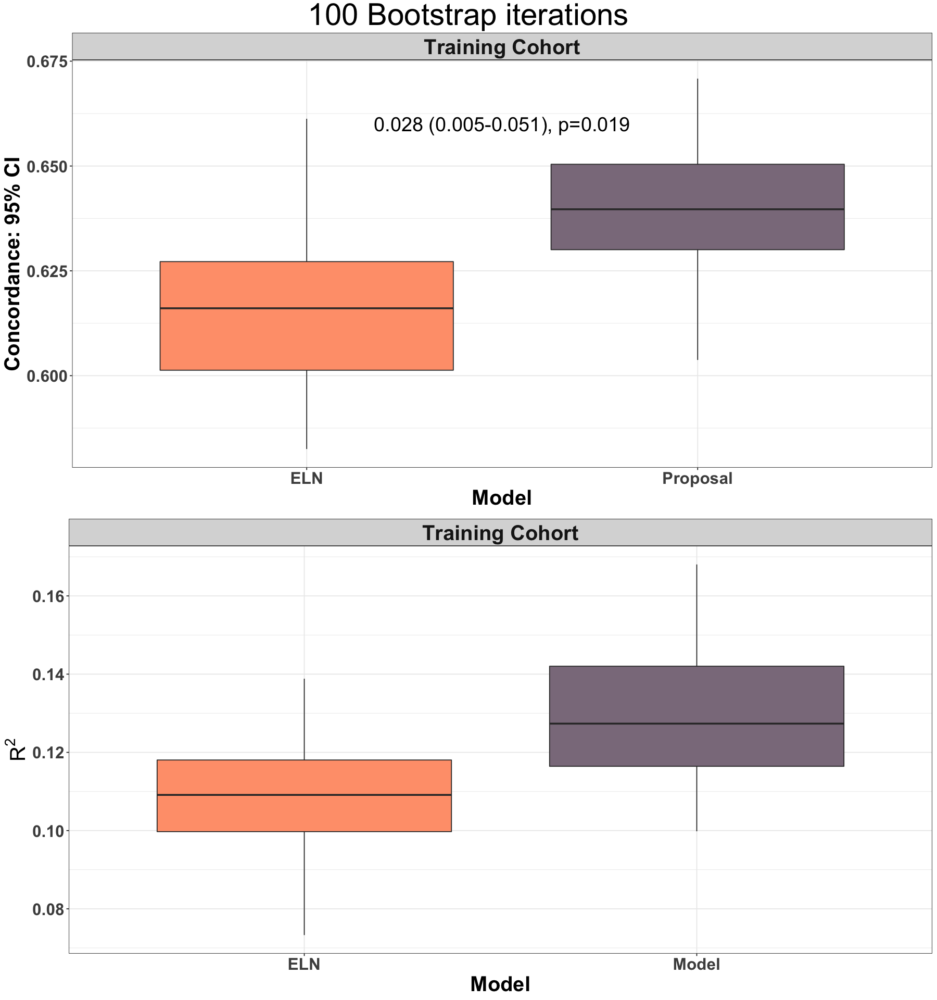

In [83]:
df_results_training <- read.table("data/bootstrap_results_NCRI_cohort_eln_proposal_training_ONLY_intense.tsv")
list_intensively_treated <- readRDS("data/list_intensively_treated.rds")
df_final_intense <- df_final[rownames(df_final) %in% list_intensively_treated,]

# Pvalue :
NF <- round(0.25*nrow(df_final_intense))
print(NF)
meanbs <- apply(df_results_training, 2, mean)
SEbs <- apply(df_results_training, 2, sd)
lowerbs <- meanbs-1.96*SEbs
upperbs <- meanbs+1.96*SEbs
Delta1 <- df_results_training[,which(colnames(df_results_training) =="molecular_classification")]  - df_results_training[,which(colnames(df_results_training) =="eln_2017")]
t1 <- abs(mean(Delta1) - 0)/sd(Delta1)
PvalueDelta1 <- round(2*pt(t1, NF-1,  lower.tail = FALSE),3)
if(PvalueDelta1 == 0) PvalueDelta1 <- "<0.001"
nam_risk_eln_training <- paste( round(mean(Delta1),3), " (",round(mean(Delta1) - 1.96*sd(Delta1), 3) ,"-",round(mean(Delta1) + 1.96*sd(Delta1), 3) , "), p=",PvalueDelta1, sep="")


# Prepare comparison data
df_results_training <- read.table("data/bootstrap_results_NCRI_cohort_eln_proposal_training_ONLY_intense.tsv")
df_results_training$id <- rownames(df_results_training)
df_results_training <- melt(setDT(df_results_training),id.vars="id")
df_results_training$Dataset <- "Training Cohort"
df_results_training$variable <- factor(df_results_training$variable,label=c("Proposal","ELN"))

# Plot C-Index
p <- ggplot(df_results_training,aes(x=reorder(variable,value),y=value,fill=variable))+
geom_boxplot()+theme_bw()+facet_wrap(~Dataset)+ geom_text(data=data.frame(x=1.5, y=0.66, label=nam_risk_eln_training, 
                                Dataset=c("Training Cohort")), aes(x,y,label=label), inherit.aes=FALSE,size=8)+
scale_fill_manual(values = c("#8B7B8B","#FFA07A"))+theme(legend.position = "none")+
theme(strip.text = element_text(face="bold", size=24),axis.text = element_text(face="bold", size=19),
      axis.title = element_text(face="bold", size=24))+xlab("Model")+ylab("Concordance: 95% CI")+scale_y_continuous(limits = quantile(df_results_training$value, c(0.02, 0.98)))

# Plot R Squared
df_Rsquared <- read.table("data/results_NCRI_cohort_eln_proposal_RSQUARED_ONLY_intense.tsv")
q <- ggplot(df_Rsquared,aes(x=Model,y=R_squared,fill=Model))+#coord_cartesian(ylim=c(0.07,0.12))+
geom_boxplot()+theme_bw()+facet_wrap(~Dataset)+scale_fill_manual(values = c("#FFA07A","#8B7B8B"))+theme(legend.position = "none")+
theme(strip.text = element_text(face="bold", size=24),axis.text = element_text(face="bold", size=19),
      axis.title = element_text(face="bold", size=24))+scale_y_continuous(breaks = seq(0.08,0.2,0.02))+ylab(expression(R^2))#theme(axis.text.y = element_text(face="bold", size=14))+

set_notebook_plot_size(15,16)
grid.arrange(p,q,nrow=2,top=textGrob("100 Bootstrap iterations", gp=gpar(fontsize=35,vjust=10)))


# **S. Figure 52: Example presentation of personalized clinical decision support tool for relative contribution of the covariates in all possible transitions.**

[AML Risk Model](https://www.aml-risk-model.com/)

# **S. Figure 53: Comparison of different statical models C-index distributions on the top performing feature combination.**

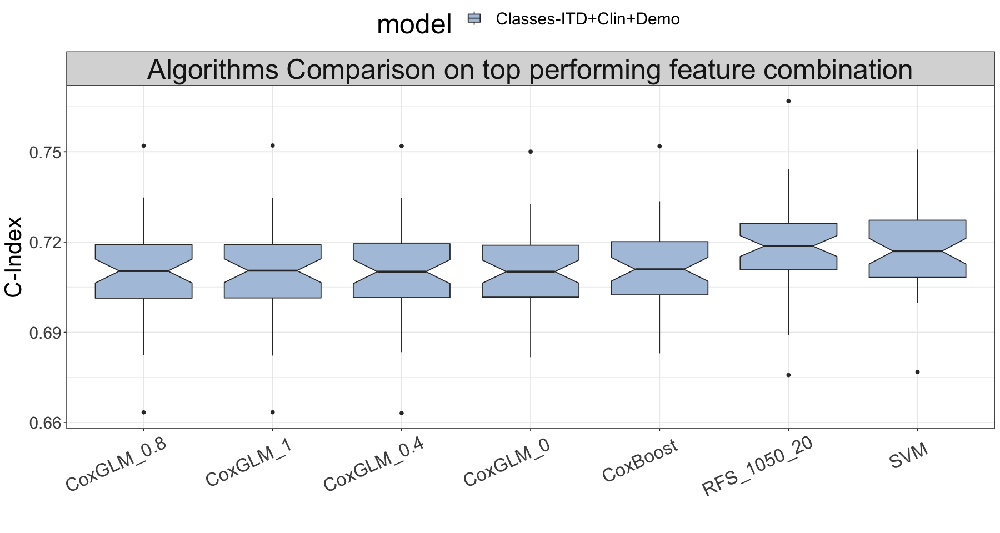

In [84]:
set_notebook_plot_size(15,8)
SVM <- read.table("data/SVM_comp_ITD_clin_demo.tsv")
comparison(path="data/",models ="comp_ITD_clin_demo",compare_algo=T)


# **S. Figure 54: Risk calculator web infrastructure.**

<img src='data/webapp_infrastructure.png'>

# S. Table 4

In [85]:
library(survival)
library(coxphw)
df_final <- read.table("data/aml_prognosis_updated.tsv")

df_final[(df_final$principal_component_NPM1==1 |df_final$principal_component_inv_16==1 |
            df_final$principal_component_t_8_21==1 | df_final$principal_component_t_15_17==1  |
            df_final$principal_component_CEBPA_bi==1 | df_final$principal_component_no_events==1 ),"molecular_classification"] <- "NEW_favorable"

df_final[(df_final$principal_component_sAML1==1 | df_final$principal_component_t_6_9==1 | df_final$principal_component_DNMT3A_IDH1_2==1 |
           df_final$principal_component_Trisomies==1 | df_final$principal_component_t_11==1 | df_final$principal_component_WT1==1 |
            df_final$principal_component_DNMT3A_IDH1_2==1 | df_final$principal_component_mNOS==1),"molecular_classification"] <- "NEW_intermediate"
          
df_final[( df_final$principal_component_sAML2==1 | df_final$principal_component_TP53_complex==1   |
            df_final$principal_component_inv_3==1) ,"molecular_classification"] <- "NEW_adverse"  


#order is important! adverse . then intermediate otherwise we . overlap
df_final[df_final$molecular_classification=="NEW_intermediate" & df_final$ITD==1,"molecular_classification"] <- "NEW_adverse"

df_final[df_final$molecular_classification=="NEW_favorable" & df_final$principal_component_NPM1==1 & df_final$ITD==1,"molecular_classification"] <- "NEW_intermediate"

df_final$NEW_favorable <-  ifelse(df_final$molecular_classification=="NEW_favorable",1,0)
df_final$NEW_intermediate <-  ifelse(df_final$molecular_classification=="NEW_intermediate",1,0)
df_final$NEW_adverse <-  ifelse(df_final$molecular_classification=="NEW_adverse",1,0)
table(df_final$molecular_classification)


df_final$eln <- ifelse(df_final$eln_2017_favorable==1,"favorable",ifelse(df_final$eln_2017_adverse==1,"adverse","intermediate"))
df_final$eln <- factor(df_final$eln,levels=c("intermediate","favorable","adverse"))

df_final$molecular_classification <- factor(df_final$molecular_classification,levels=c("NEW_intermediate","NEW_favorable","NEW_adverse"))

df_final$classes <- factor(df_final$princ_comp,levels=c('CEBPA_bi','NPM1','t_11','TP53_complex','sAML2','sAML1',
                                                        'DNMT3A_IDH1_2','inv_3','mNOS','t_8_21','no_events','WT1','inv_16','Trisomies','t_6_9','t_15_17'))



fit <- coxphw(Surv(os, os_status) ~ eln, data = df_final)
fit

fit <- coxph(Surv(os, os_status) ~ eln, data = df_final)
fit


fit <- coxphw(Surv(os, os_status) ~ molecular_classification, data = df_final)
fit

fit <- coxph(Surv(os, os_status) ~ molecular_classification, data = df_final)
fit

fit <- coxphw(Surv(os, os_status) ~ classes, data = df_final)
fit

fit <- coxph(Surv(os, os_status) ~ classes, data = df_final)
fit



     NEW_adverse    NEW_favorable NEW_intermediate 
             814              694              605 

coxphw(formula = Surv(os, os_status) ~ eln, data = df_final)

Model fitted by weighted estimation (AHR template) 

                   coef   se(coef) exp(coef) lower 0.95 upper 0.95         z
elnfavorable -0.3869488 0.07847777 0.6791259  0.5823041  0.7920465 -4.930680
elnadverse    0.5843096 0.07001068 1.7937522  1.5637569  2.0575748  8.346007
                        p
elnfavorable 8.194367e-07
elnadverse   1.110223e-16

Wald Chi-square=212.2871 on 2df, p=0, n=2113


Call:
coxph(formula = Surv(os, os_status) ~ eln, data = df_final)

                 coef exp(coef) se(coef)      z        p
elnfavorable -0.45622   0.63368  0.07464 -6.112 9.84e-10
elnadverse    0.55145   1.73577  0.06877  8.018 1.07e-15

Likelihood ratio test=267.5  on 2 df, p=< 2.2e-16
n= 2113, number of events= 1408 

coxphw(formula = Surv(os, os_status) ~ molecular_classification, 
    data = df_final)

Model fitted by weighted estimation (AHR template) 

                                            coef   se(coef) exp(coef)
molecular_classificationNEW_favorable -0.4585102 0.08374791 0.6322248
molecular_classificationNEW_adverse    0.6835069 0.06776958 1.9808120
                                      lower 0.95 upper 0.95         z
molecular_classificationNEW_favorable  0.5365191  0.7450028 -5.474886
molecular_classificationNEW_adverse    1.7344336  2.2621887 10.085747
                                                 p
molecular_classificationNEW_favorable 4.377931e-08
molecular_classificationNEW_adverse   0.000000e+00

Wald Chi-square=263.7023 on 2df, p=0, n=2113


Call:
coxph(formula = Surv(os, os_status) ~ molecular_classification, 
    data = df_final)

                                          coef exp(coef) se(coef)      z
molecular_classificationNEW_favorable -0.47639   0.62102  0.07556 -6.305
molecular_classificationNEW_adverse    0.69509   2.00389  0.06401 10.860
                                             p
molecular_classificationNEW_favorable 2.89e-10
molecular_classificationNEW_adverse    < 2e-16

Likelihood ratio test=330.3  on 2 df, p=< 2.2e-16
n= 2113, number of events= 1408 

coxphw(formula = Surv(os, os_status) ~ classes, data = df_final)

Model fitted by weighted estimation (AHR template) 

                           coef  se(coef) exp(coef) lower 0.95 upper 0.95
classesNPM1           0.3053133 0.2495609 1.3570501  0.8320880  2.2132095
classest_11           0.3353667 0.2822329 1.3984531  0.8042865  2.4315601
classesTP53_complex   1.6544335 0.2551393 5.2301160  3.1720234  8.6235534
classessAML2          0.9540983 0.2484316 2.5963285  1.5954907  4.2249833
classessAML1          0.3529096 0.2736009 1.4232025  0.8324865  2.4330790
classesDNMT3A_IDH1_2  0.8672914 0.3565834 2.3804544  1.1834108  4.7883313
classesinv_3          1.4497412 0.2984998 4.2620112  2.3742755  7.6506451
classesmNOS           0.3246690 0.2715287 1.3835726  0.8125990  2.3557415
classest_8_21        -0.6203420 0.3023642 0.5377605  0.2973144  0.9726616
classesno_events     -0.1155054 0.3034523 0.8909158  0.4915159  1.6148632
classesWT1            0.8143702 0.3057509 2.2577532  1.2399975  4.1

Call:
coxph(formula = Surv(os, os_status) ~ classes, data = df_final)

                         coef exp(coef) se(coef)      z        p
classesNPM1           0.25729   1.29342  0.23506  1.095  0.27370
classest_11           0.41707   1.51751  0.27034  1.543  0.12289
classesTP53_complex   1.66984   5.31130  0.24100  6.929 4.25e-12
classessAML2          0.97071   2.63981  0.23480  4.134 3.56e-05
classessAML1          0.39124   1.47882  0.26086  1.500  0.13366
classesDNMT3A_IDH1_2  0.88071   2.41261  0.34558  2.548  0.01082
classesinv_3          1.56671   4.79085  0.33482  4.679 2.88e-06
classesmNOS           0.32073   1.37813  0.25555  1.255  0.20947
classest_8_21        -0.54525   0.57970  0.28799 -1.893  0.05832
classesno_events      0.05563   1.05721  0.30187  0.184  0.85378
classesWT1            0.83989   2.31612  0.29154  2.881  0.00397
classesinv_16        -0.66537   0.51408  0.29724 -2.238  0.02519
classesTrisomies      0.37876   1.46047  0.29950  1.265  0.20600
classest_6_9       